<a href="https://colab.research.google.com/github/kamalkish0r/data-clustering/blob/main/Data_Clustering_Assignments_20bcs108.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

20BCS108 - Kamal Kishor

#Global

In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


##Install dependencies

In [ ]:
!pip install kneed

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


##Load Libraries and packages

In [ ]:
# libararies and packages
import os
import sys
import math
import heapq
import glob
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import adjusted_rand_score as ARI, silhouette_score as SI
from sklearn.cluster import KMeans
from collections import defaultdict
from scipy import stats, linalg
import sklearn.metrics as sklearn_metrics
from kneed import KneeLocator
from sklearn.datasets import make_blobs

##KMeans Algorithm

In [ ]:
def euclidean_dist(points, centroid):
    return ((points - centroid) ** 2).sum()


def manhattan_dist(points, centroid):
    return (abs(points - centroid)).sum()


def cosine_similarity(points, centroid):
    return np.dot(points, centroid) / (np.linalg.norm(points) * np.linalg.norm(centroid))


In [ ]:
def k_means(k, points, init_centroids=[], max_iterations=20, plotData=False, similarity_measure='euclidean'):
    n, m = points.shape
    # initialise centriods if None
    if len(init_centroids) == 0:
        init_centroids = []
        init_centroids = points[np.random.choice(n, size=k, replace=False)]

    # plot initial centroids
    centroids = np.array(init_centroids)
    if plotData:
        plt.title('Initial Centroids')
        plt.scatter(points[:, 0], points[:, 1])
        plt.scatter(centroids[:, 0], centroids[:, 1],
                    c='red', s=200, marker='*')
        plt.show()

    clusters = np.zeros(n, dtype='int')
    for itr in range(max_iterations):
        # find distance of every point from every centroid
        # assign each point to centroid nearest to it
        for i in range(n):
            label, dist = 0, sys.maxsize
            if similarity_measure == 'cosine':
              dist = 0
            for j in range(k):
              if similarity_measure == 'manhattan':
                curr_dist = manhattan_dist(points=points[i], centroid=centroids[j])
                if curr_dist < dist:
                  label, dist = j, curr_dist
              elif similarity_measure == 'cosine':
                curr_dist = cosine_similarity(points=points[i], centroid=centroids[j])
                if curr_dist > dist:
                  label, dist = j, curr_dist
              else:
                curr_dist = euclidean_dist(points=points[i], centroid=centroids[j])
                if curr_dist < dist:
                  label, dist = j, curr_dist
            
            clusters[i] = label

        # print(clusters)
        new_centroids = np.zeros((k, m))
        for cluster_no in range(k):
            # X contains all points who belongs to cluster=cluster_no
            X = points[np.where(clusters == cluster_no)]
            if len(X) > 0:
              new_centroids[cluster_no] = np.mean(X, axis=0)

        # print(new_centroids)
        if plotData:
            plt.title('Result after iteration : ' + str(itr))
            plt.scatter(points[:, 0], points[:, 1], c=clusters, s=20)
            plt.scatter(centroids[:, 0], centroids[:, 1],
                        c='red', s=200, marker='*')
            plt.scatter(
                new_centroids[:, 0], new_centroids[:, 1], c='blue', s=150, marker='o')
            plt.show()

        if (new_centroids - centroids).sum == 0:
            break
        centroids = new_centroids

    return centroids, clusters

##Bisecting-KMeans Algorithm

In [ ]:
def calc_SSE(points, centroid):
    return ((points - centroid) ** 2).sum()

In [ ]:
def assign_centroids(curr_clusters, points, labels, centroid_cords):
    centroid = {}
    for cluster_no in curr_clusters:
        X = points[np.where(labels == cluster_no)]
        sse = sys.maxsize
        for centroid_cord in centroid_cords:
            curr_sse = calc_SSE(X, centroid=centroid_cord)
            if curr_sse < sse:
                sse = curr_sse
                centroid[cluster_no] = centroid_cord

    return centroid



In [ ]:
def bisecting_kmeans(k, points, plotData=False, similarity_measure='euclidean'):
    n, m = points.shape
    centroids = {}
    if plotData == True:
      plt.scatter(points[:, 0], points[:, 1])
      plt.show()

    new_centroids, clusters = k_means(k=2, points=points, similarity_measure=similarity_measure)
    curr_clusters = [0, 1]

    # assign centroid to each label
    centroids = assign_centroids(
        curr_clusters=curr_clusters, points=points, labels=clusters, centroid_cords=new_centroids)

    if plotData == True:
        centroid_cords = []
        for centroid_cord in centroids.values():
            centroid_cords.append(centroid_cord)
        centroid_cords = np.array(centroid_cords)
        plt.scatter(points[:, 0], points[:, 1], c=clusters)
        plt.scatter(
            centroid_cords[:, 0], centroid_cords[:, 1], c='blue', marker='*', s=200)
        plt.show()

    while len(curr_clusters) < k:
        # find the cluster with max SSE
        sse, max_sse_cluster = 0, 0
        for cluster_no in curr_clusters:
            X = points[np.where(clusters == cluster_no)]
            curr_sse = calc_SSE(X, centroid=centroids[cluster_no])
            if curr_sse > sse:
                sse = curr_sse
                max_sse_cluster = cluster_no

        # divide the cluster with max sse into 2 clusters
        X = points[np.where(clusters == max_sse_cluster)]
        curr_clusters.append(curr_clusters[-1] + 1)
        new_centroids, new_clusters = k_means(k=2, points=X, similarity_measure=similarity_measure)

        # update the original clusters with new ones, also add the new_centroids and remove the previous centroid of max_sse_cluster
        centroids[max_sse_cluster] = new_centroids[0]
        centroids[curr_clusters[-1]] = new_centroids[1]
        for index in range(n):
            if clusters[index] != max_sse_cluster:
                continue

            dist1 = ((points[index] - new_centroids[0]) ** 2).sum()
            dist2 = ((points[index] - new_centroids[1]) ** 2).sum()
            if dist1 < dist2:
                clusters[index] = max_sse_cluster
            else:
                clusters[index] = curr_clusters[-1]

        if plotData == True:
            sse = 0
            for i in range(n):
              sse += calc_SSE(points[i], centroids[clusters[i]])
              
            plt.title('SSE : ' + str(round(sse, 3)) + ', K = ' + str(len(curr_clusters)))
            centroid_cords = []
            for centroid_cord in centroids.values():
                centroid_cords.append(centroid_cord)
            centroid_cords = np.array(centroid_cords)
            plt.scatter(points[:, 0], points[:, 1], c=clusters)
            plt.scatter(
                centroid_cords[:, 0], centroid_cords[:, 1], c='blue', marker='*', s=200)
            plt.show()

    org_centroids = []
    for i in range(k):
      org_centroids.append(centroids[i])
    return org_centroids, clusters



##How to choose best k for clustering

In [ ]:
def find_k(X, max_k=10, plotData=False):
  freq = {}
  for _ in range(max((int)(max_k / 3), 2)):
    sil_sc = []
    for k in range(2, max_k + 1):
      centroids, clusters = bisecting_kmeans(k, X)
      curr_sil = SI(X, clusters)
      sil_sc.append(curr_sil)
    
    sil_sc = np.array(sil_sc)
    kk = np.array([i for i in range(2, max_k + 1)])
    # for k in kk:
    #   print(k, end=' ')
    if plotData == True:
      plt.plot(kk, sil_sc)
      plt.xlabel('K')
      plt.ylabel('silhouette_score')
      plt.show()
    
    max_index = np.argmax(sil_sc)
    if max_index in freq:
      freq[max_index] += 1
    else:
      freq[max_index] = 1
  return max(freq, key=lambda x: freq[x])

##Read Dataset

In [ ]:
def read_dataset(file_path):
  delimiter = ','
  with open(file_path, 'r') as f:
    if ',' in f.readline():
      delimiter = ','
    elif '\t' in f.readline():
      delimiter = '\t'
    else:
      delimiter = ' '
  
  df = pd.read_csv(file_path, sep=delimiter, header=None)
  X, labels = df.iloc[:, :-1], df.iloc[:, -1]
  X, labels = np.array(X), np.array(labels)

  # preprocess
  labels_map = defaultdict(lambda:-1)
  for i, label in enumerate(labels):
    if labels_map[label] == -1:
      labels_map[label] = i
  
  distinct_labels = list(labels_map.keys())
  mapped_labels = [distinct_labels.index(n) for n in labels]
  labels = np.array(mapped_labels)

  return X, labels

def read_all_datasets_in_folder(path):
  all_file_paths = glob.glob(path + '*.csv') + glob.glob(path + '*.txt')
  datasets = []
  for file_path in all_file_paths:
    X, labels = read_dataset(file_path)
    datasets.append([X, labels])
  
  return datasets

#Assignment-1

###The following results should be submitted:

1. What are the clusters formed with their SSE after each iteration of the above algorithm for any one synthetic dataset.

2. Compare the results of the Bisecting k-means and k-means for all datasets. For each dataset run both the algorithms ten times. Out of ten runs select the clusters that gives best SSE.

3. For synthetic datasets compare the two methods by plotting the results and for real datasets compare the two methods based on SSE, SI, and ARI.

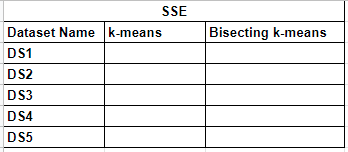

In [ ]:
def find_sse(X, centroids):
  sse = 0
  for point in X:
    curr_sse = sys.maxsize
    for centroid in centroids:
      curr_sse = min(curr_sse, ((point - centroid) ** 2).sum())
    
    sse += curr_sse
    
  return sse

In [ ]:
def compare_algo(X, k, max_iterations=10, plotData=False):
  sse = []
  
  kmeans_data, bisecting_data = [], []
  kmeans_min_sse, bisecting_min_sse = sys.maxsize, sys.maxsize
  kmeans_index, bisecting_index = 0, 0
  for i in range(max_iterations):
    curr_bisecting_data, curr_kmeans_data = {}, {}
    bisecting_centroids, bisecting_clusters = bisecting_kmeans(k, X)
    kmeans_centroids, kmeans_clusters = k_means(k, X)
    curr_bisecting_data['sse'] = find_sse(X, bisecting_centroids)
    curr_kmeans_data['sse'] = find_sse(X, kmeans_centroids)
    if kmeans_min_sse > curr_kmeans_data['sse']:
      kmeans_index = i
      kmeans_min_sse = curr_kmeans_data['sse']
    if bisecting_min_sse > curr_bisecting_data['sse']:
      bisecting_index = i
      bisecting_min_sse = curr_bisecting_data['sse']
    
    curr_kmeans_data['centroids'], curr_kmeans_data['clusters'] = kmeans_centroids, kmeans_clusters
    curr_bisecting_data['centroids'], curr_bisecting_data['clusters'] = bisecting_centroids, bisecting_clusters
    kmeans_data.append(curr_kmeans_data)
    bisecting_data.append(curr_bisecting_data)

    if plotData == True:
      plt.title('Results for Bisecting-Kmeans after iteration : ' + str(i))
      clusters = np.array(curr_bisecting_data['clusters'])
      plt.scatter(X[:, 0], X[:, 1], c=clusters)
      centroids = np.array(bisecting_centroids)
      plt.scatter(centroids[:, 0], centroids[:, 1], c='red', marker='*', s=100)
      plt.show()

      plt.title('Results for Kmeans after iteration : ' + str(i))
      clusters = np.array(curr_kmeans_data['clusters'])
      plt.scatter(X[:, 0], X[:, 1], c=clusters)
      centroids = np.array(kmeans_centroids)
      plt.scatter(centroids[:, 0], centroids[:, 1], c='red', marker='*', s=100)
      plt.show()
  
  return kmeans_data[kmeans_index], bisecting_data[bisecting_index]

###1. What are the clusters formed with their SSE after each iteration of the above algorithm for any one synthetic dataset.



####Load Dataset

In [ ]:
df = pd.read_csv('/content/drive/MyDrive/Data Clustering/LAB-01/Datasets/Synthetic/corners.txt', sep='\t')
df.head(10)

,9.448678562,3.711543783,1
0,10.922672,3.341594,1
1,4.426034,3.047184,1
2,3.295970,2.597631,1
3,4.250679,3.407938,1
4,5.500139,2.763222,1
5,4.870846,3.135370,1
6,11.274880,3.775722,1
7,2.513138,3.685899,1
8,7.926668,3.797597,1
9,3.628989,3.878006,1


In [ ]:
points, labels = df.iloc[:, :-1], df.iloc[:, -1]
points, labels = np.array(points), np.array(labels)

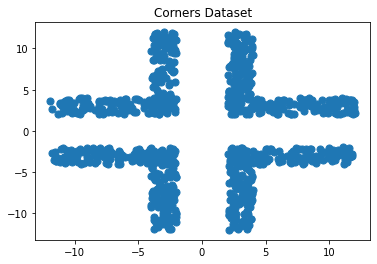

In [ ]:
plt.title('Corners Dataset')
plt.scatter(points[:, 0], points[:, 1], s=50)
plt.show()

####Run Bisecting KMeans on this dataset. Plotting the results along with SSE

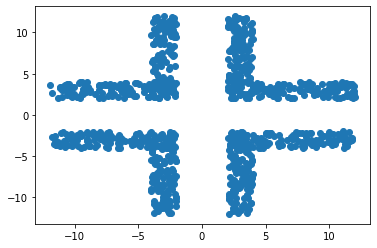

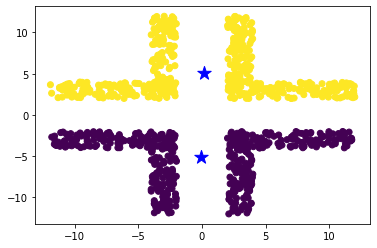

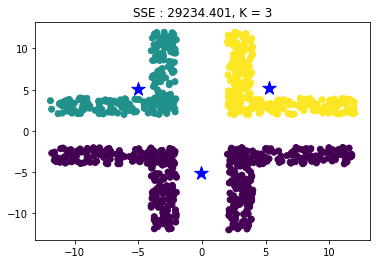

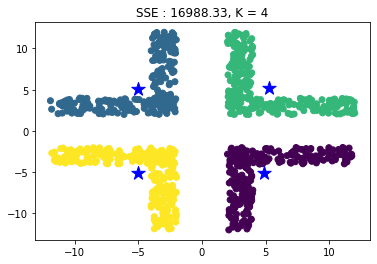

In [ ]:
centroids, clusters = bisecting_kmeans(4, points, plotData=True)

###2. Compare the results of the Bisecting k-means and k-means for all datasets. For each dataset run both the algorithms ten times. Out of ten runs select the clusters that gives best SSE.

####Synthetic Datasets

2


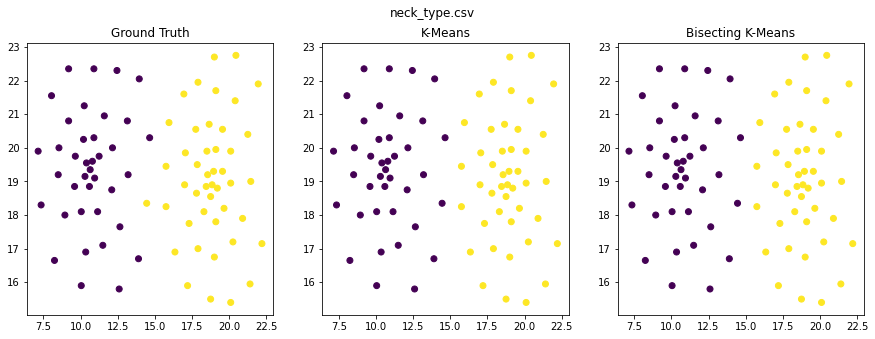

3


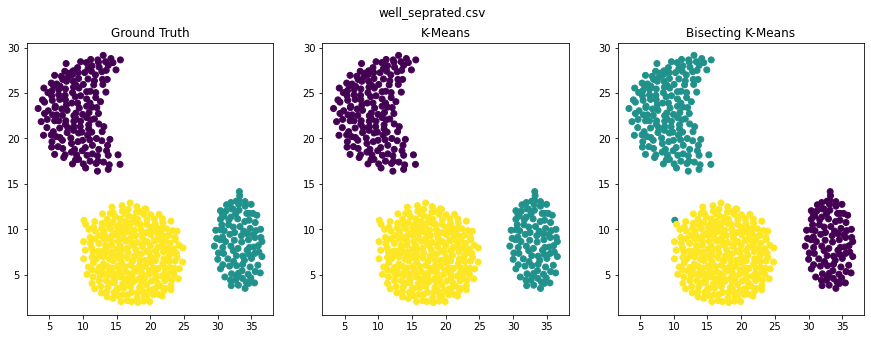

31


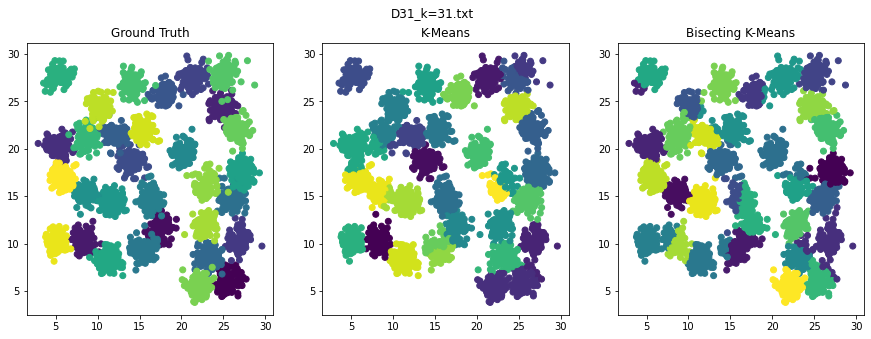

2


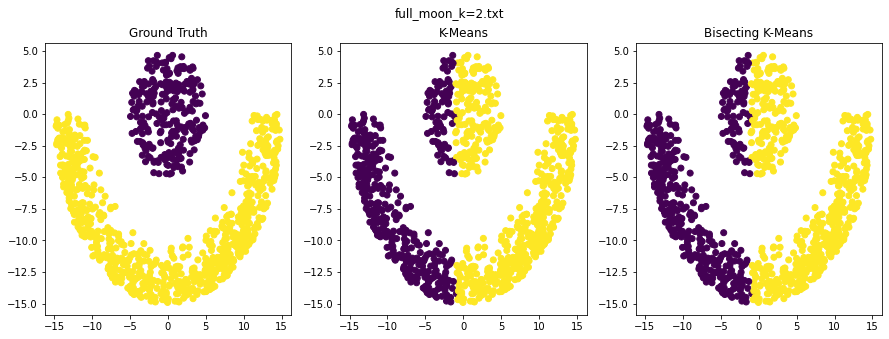

2


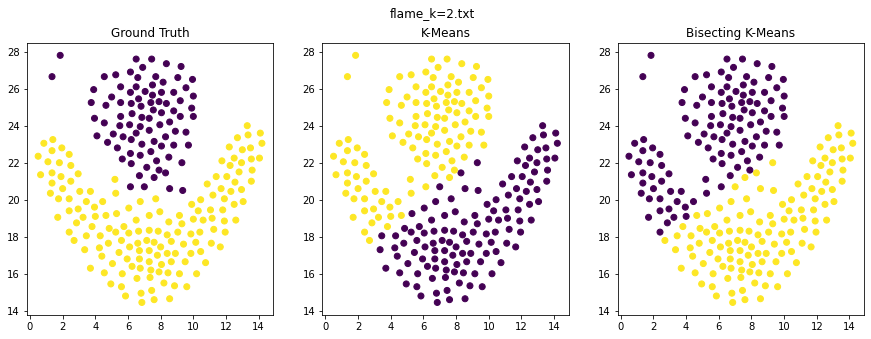

2


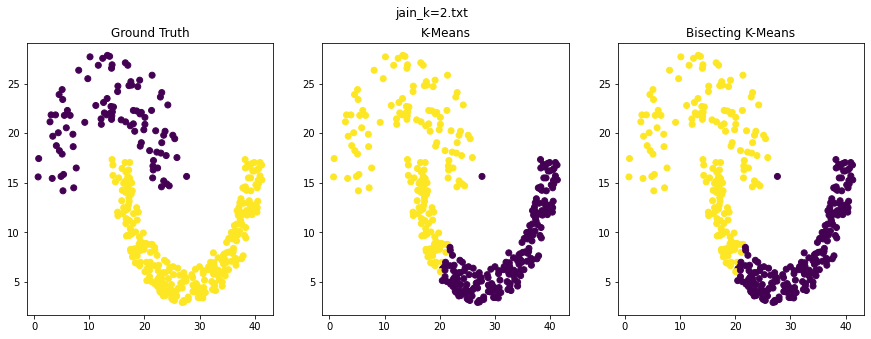

15


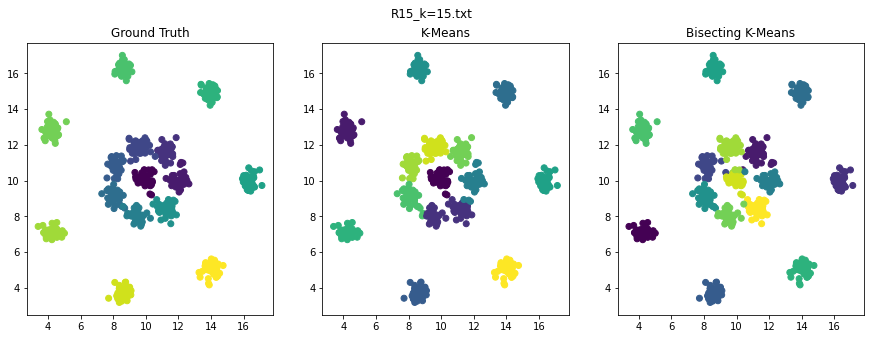

11


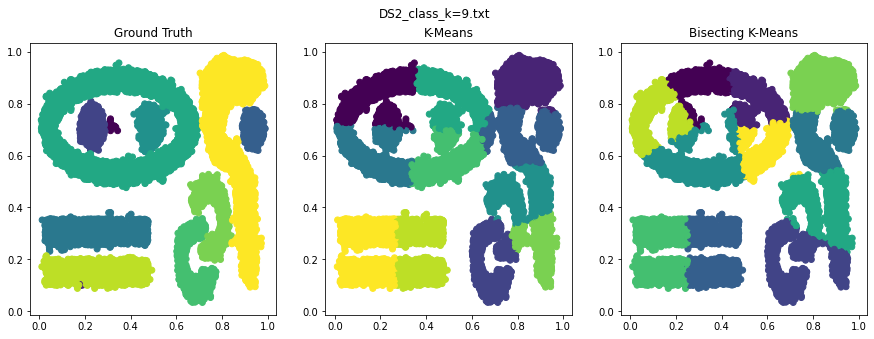

3


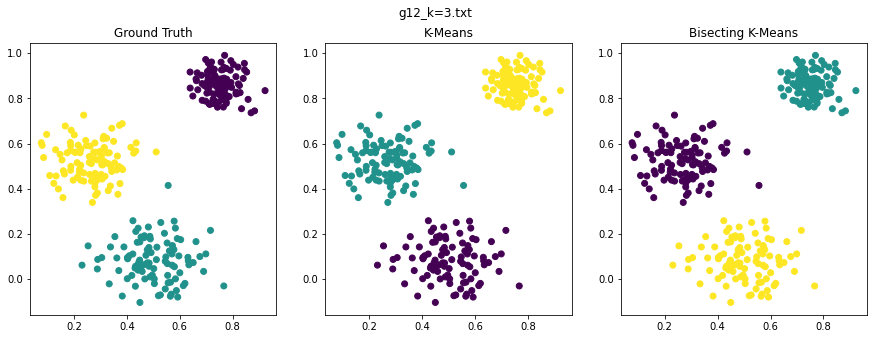

3


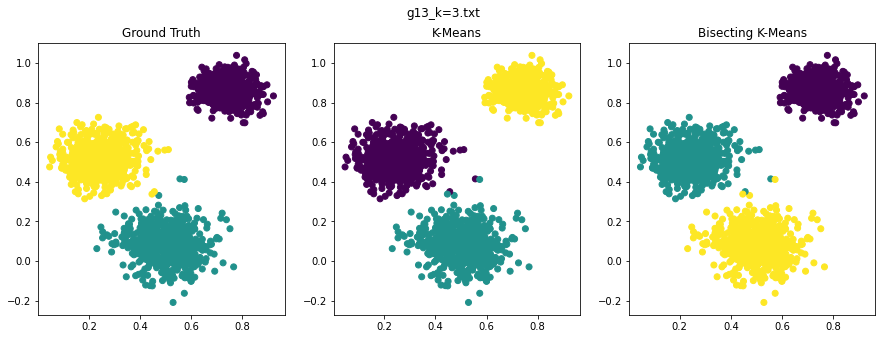

7


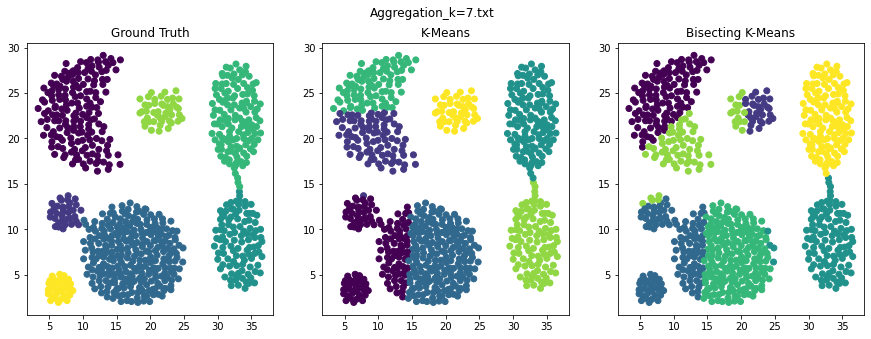

4


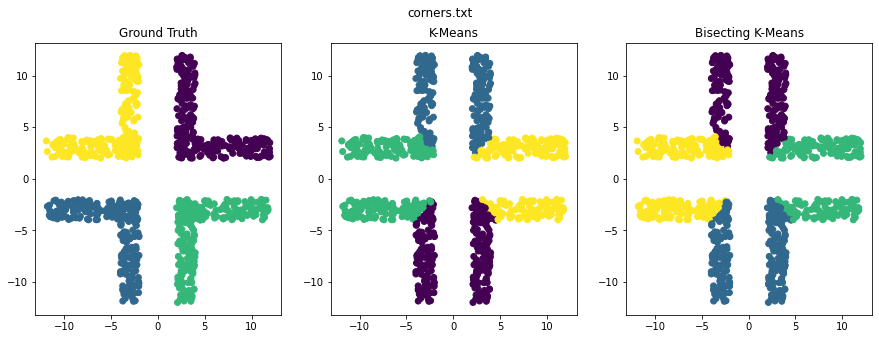

2


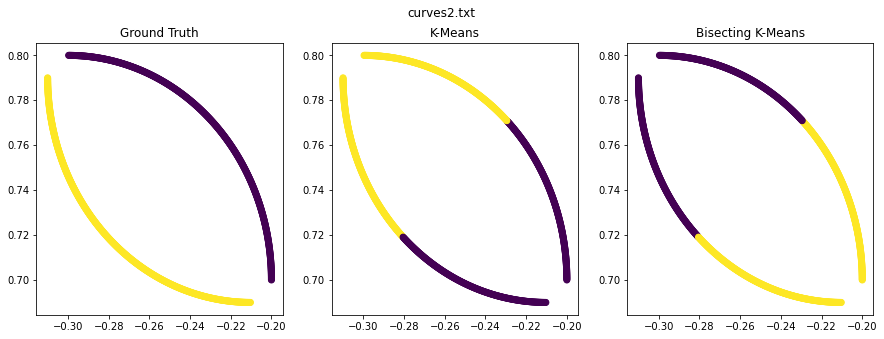

3


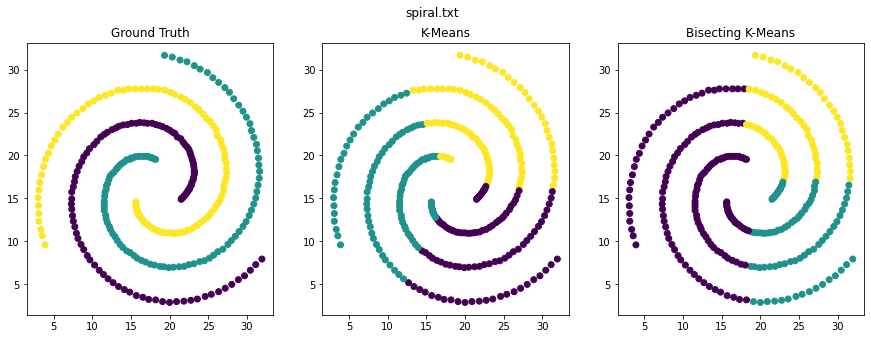

2


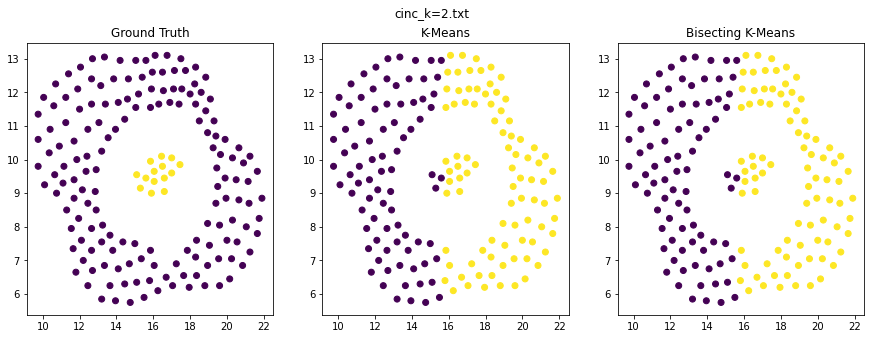

3


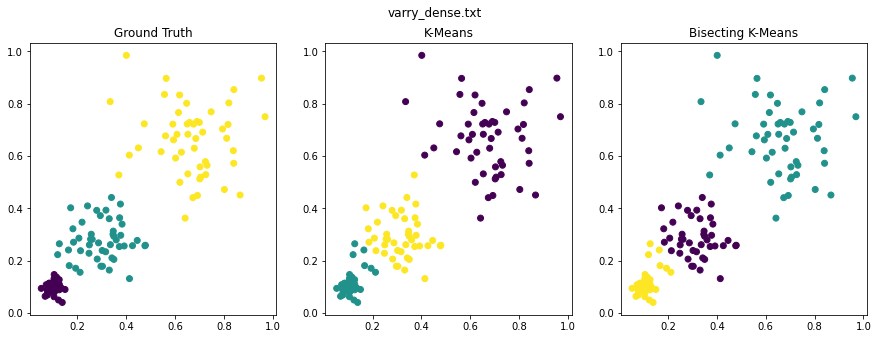

In [ ]:
path = '/content/drive/MyDrive/Data Clustering/LAB-01/Datasets/Synthetic/'
all_file_paths = glob.glob(path + '*.csv') + glob.glob(path + '*.txt')

table = {'Dataset Name' : [], 'K-Means': {'sse': [], 'ARI' : [], 'SI' : []}, 'Bisecting K-Means' : {'sse': [], 'ARI' : [], 'SI' : []}}

for file_path in all_file_paths:
  delimiter = ','
  with open(file_path, 'r') as f:
    if ',' in f.readline():
      delimiter = ','
    elif '\t' in f.readline():
      delimiter = '\t'
    else:
      delimiter = ' '
  
  df = pd.read_csv(file_path, sep=delimiter, header=None)
  X, labels = df.iloc[:, :-1], df.iloc[:, -1]
  X, labels = np.array(X), np.array(labels)
  # pre-process the labels
  labels_map = defaultdict(lambda:-1)
  for i, label in enumerate(labels):
    if labels_map[label] == -1:
      labels_map[label] = i
  
  distinct_labels = list(labels_map.keys())
  mapped_labels = [distinct_labels.index(n) for n in labels]
  labels = np.array(mapped_labels)

  dataset_name = os.path.basename(file_path)

  # plotting original dataset
  fig, ax = plt.subplots(1, 3, figsize=(15, 5))
  # fig.tight_layout()
  ax[0].set_title('Ground Truth')
  ax[0].scatter(X[:, 0], X[:, 1], c=labels)

  # best_k = find_k(X, max_k=35)
  best_k = max(labels) + 1
  print(best_k)
  kmeans_data, bisecting_data = compare_algo(X, k=best_k, max_iterations=5)
  
  # plot the result for k-mean
  ax[1].set_title('K-Means')
  ax[1].scatter(X[:, 0], X[:, 1], c=kmeans_data['clusters'])

  # plot the result for bisecting k-mean
  ax[2].set_title('Bisecting K-Means')
  ax[2].scatter(X[:, 0], X[:, 1], c=bisecting_data['clusters'])

  plt.suptitle(dataset_name)
  plt.show()

  table['Dataset Name'].append(dataset_name)
  table['K-Means']['sse'].append(kmeans_data['sse'])
  table['Bisecting K-Means']['sse'].append(bisecting_data['sse'])
  kmeans_ARI = ARI(labels, kmeans_data['clusters'])
  bisecting_ARI = ARI(labels, bisecting_data['clusters'])
  kmeans_SI = SI(X, kmeans_data['clusters'])
  bisecting_SI = SI(X, bisecting_data['clusters'])
  table['K-Means']['ARI'].append(kmeans_ARI)
  table['K-Means']['SI'].append(kmeans_SI)
  table['Bisecting K-Means']['ARI'].append(bisecting_ARI)
  table['Bisecting K-Means']['SI'].append(bisecting_SI)
  

In [ ]:
columns = ['Dataset Name', 'K-Means SSE', 'Bisecting K-Means SSE', 'K-Means ARI', 'Bisecting K-Means ARI', 'K-Means SI', 'Bisecting K-Means SI']
synthetic_df = pd.DataFrame()
synthetic_df['Dataset Name'] = table['Dataset Name']
synthetic_df['K-Means SSE'] = table['K-Means']['sse']
synthetic_df['Bisecting K-Means SSE'] = table['Bisecting K-Means']['sse']
synthetic_df['K-Means ARI'] = table['K-Means']['ARI']
synthetic_df['Bisecting K-Means ARI'] = table['Bisecting K-Means']['ARI']
synthetic_df['K-Means SI'] = table['K-Means']['SI']
synthetic_df['Bisecting K-Means SI'] = table['Bisecting K-Means']['SI']

print(synthetic_df)

         Dataset Name   K-Means SSE  Bisecting K-Means SSE  K-Means ARI  \
0  heart_data_k=2.txt  7.737025e+05           7.737025e+05     0.071704   
1   hepatitis_k=2.txt  1.839855e+06           1.839855e+06     0.063851   
2           glass.csv  5.766921e+02           5.212701e+02     0.105533   
3            wine.txt  4.041821e+06           4.083279e+06     0.466984   
4       iris2_k=3.txt  8.136382e+01           8.721805e+01     0.600686   

   Bisecting K-Means ARI  K-Means SI  Bisecting K-Means SI  
0               0.071704    0.070649              0.070649  
1               0.063851    0.035976              0.035976  
2               0.218122   -0.000933              0.359225  
3               0.471740    0.079468              0.167457  
4               0.574904    0.506263              0.463915  


In [ ]:
synthetic_df.to_csv('/content/drive/MyDrive/Data Clustering/LAB-01/Datasets/synthetic_dataset_results.csv')


####Real Datasets

In [ ]:
path = '/content/drive/MyDrive/Data Clustering/LAB-01/Datasets/Real/*'

table = {'Dataset Name' : [], 'K-Means': {'sse': [], 'ARI' : [], 'SI' : []}, 'Bisecting K-Means' : {'sse': [], 'ARI' : [], 'SI' : []}}

for file_path in glob.glob(path):
  delimiter = ','
  with open(file_path, 'r') as f:
    if ',' in f.readline():
      delimiter = ','
    elif '\t' in f.readline():
      delimiter = '\t'
    else:
      delimiter = ' '
  
  df = pd.read_csv(file_path, sep=delimiter, header=None)
  X, labels = df.iloc[:, :-1], df.iloc[:, -1]
  X, labels = np.array(X), np.array(labels)
  # pre-process the labels
  labels_map = defaultdict(lambda:-1)
  for i, label in enumerate(labels):
    if labels_map[label] == -1:
      labels_map[label] = i
  
  distinct_labels = list(labels_map.keys())
  mapped_labels = [distinct_labels.index(n) for n in labels]
  labels = np.array(mapped_labels)

  dataset_name = os.path.basename(file_path)
  best_k = max(labels) + 1
  # best_k = find_k(X, max_k=35)
  kmeans_data, bisecting_data = compare_algo(X, k=best_k)
  
  table['Dataset Name'].append(os.path.basename(file_path))
  table['K-Means']['sse'].append(kmeans_data['sse'])
  table['Bisecting K-Means']['sse'].append(bisecting_data['sse'])
  kmeans_ARI = ARI(labels, kmeans_data['clusters'])
  bisecting_ARI = ARI(labels, bisecting_data['clusters'])
  kmeans_SI = SI(X, kmeans_data['clusters'])
  bisecting_SI = SI(X, bisecting_data['clusters'])
  table['K-Means']['ARI'].append(kmeans_ARI)
  table['K-Means']['SI'].append(kmeans_SI)
  table['Bisecting K-Means']['ARI'].append(bisecting_ARI)
  table['Bisecting K-Means']['SI'].append(bisecting_SI)


In [ ]:
columns = ['Dataset Name', 'K-Means SSE', 'Bisecting K-Means SSE', 'K-Means ARI', 'Bisecting K-Means ARI', 'K-Means SI', 'Bisecting K-Means SI']
real_df = pd.DataFrame()
real_df['Dataset Name'] = table['Dataset Name']
real_df['K-Means SSE'] = table['K-Means']['sse']
real_df['Bisecting K-Means SSE'] = table['Bisecting K-Means']['sse']
real_df['K-Means ARI'] = table['K-Means']['ARI']
real_df['Bisecting K-Means ARI'] = table['Bisecting K-Means']['ARI']
real_df['K-Means SI'] = table['K-Means']['SI']
real_df['Bisecting K-Means SI'] = table['Bisecting K-Means']['SI']

print(real_df)

         Dataset Name   K-Means SSE  Bisecting K-Means SSE  K-Means ARI  \
0  heart_data_k=2.txt  7.737025e+05           7.737025e+05     0.071704   
1   hepatitis_k=2.txt  1.839855e+06           1.839855e+06     0.063851   
2           glass.csv  5.766921e+02           5.212701e+02     0.105533   
3            wine.txt  4.041821e+06           4.083279e+06     0.466984   
4       iris2_k=3.txt  8.136382e+01           8.721805e+01     0.600686   

   Bisecting K-Means ARI  K-Means SI  Bisecting K-Means SI  
0               0.071704    0.070649              0.070649  
1               0.063851    0.035976              0.035976  
2               0.218122   -0.000933              0.359225  
3               0.471740    0.079468              0.167457  
4               0.574904    0.506263              0.463915  


In [ ]:
real_df.to_csv('/content/drive/MyDrive/Data Clustering/LAB-01/Datasets/real_dataset_results.csv')

#Assignment-2

##Synthetic Datasets

2


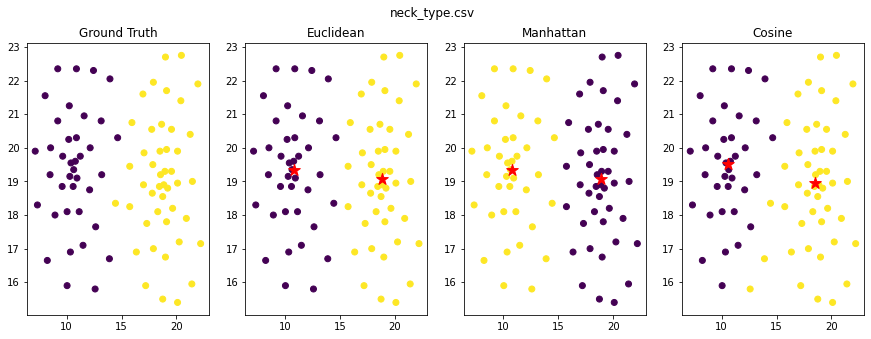

3


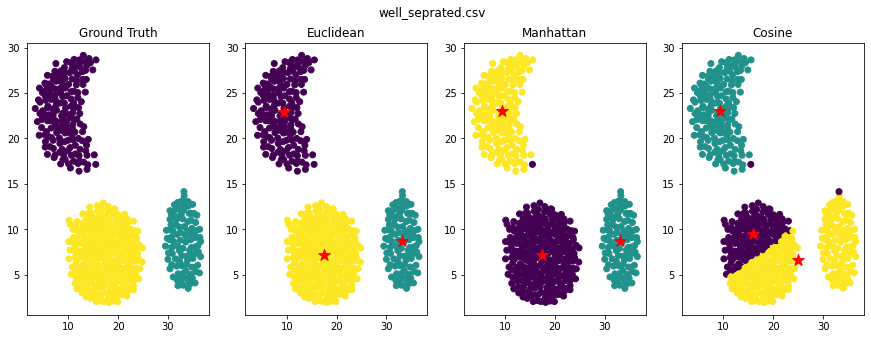

31


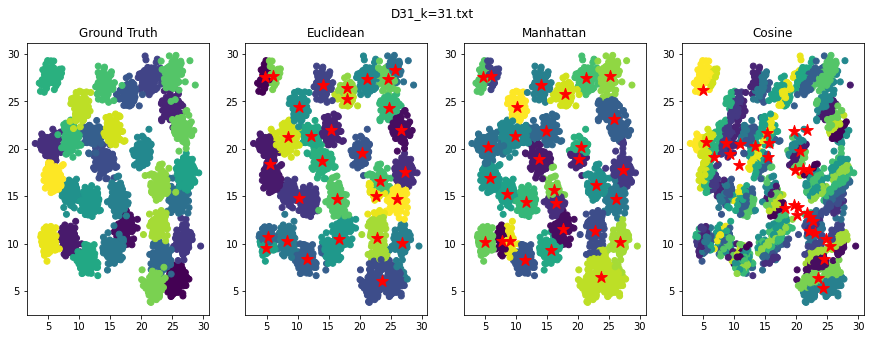

2


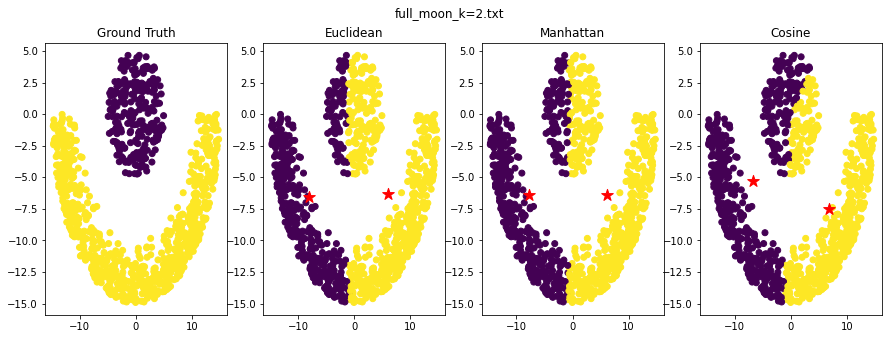

2


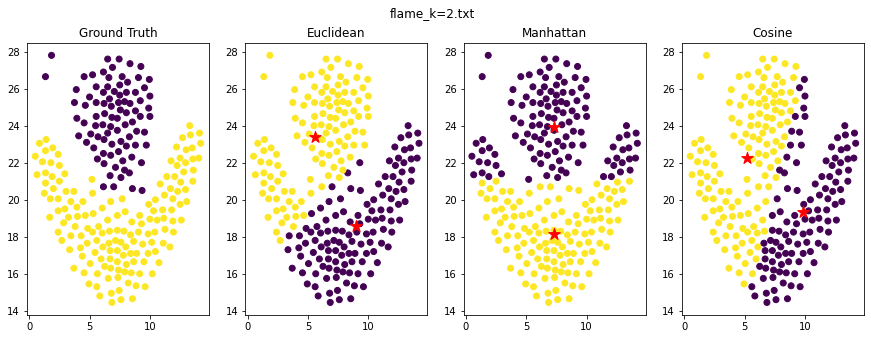

2


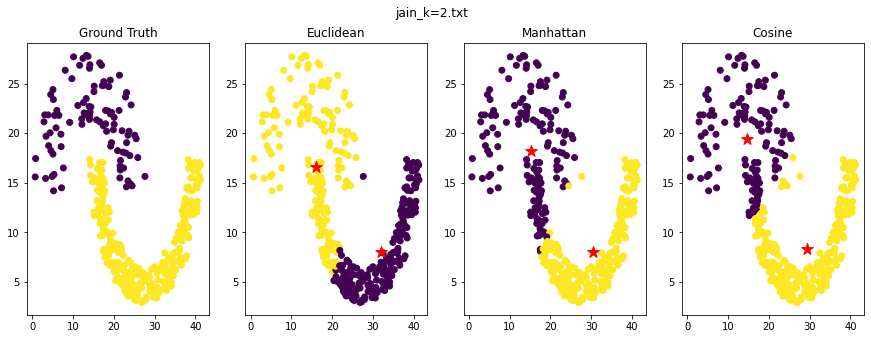

15


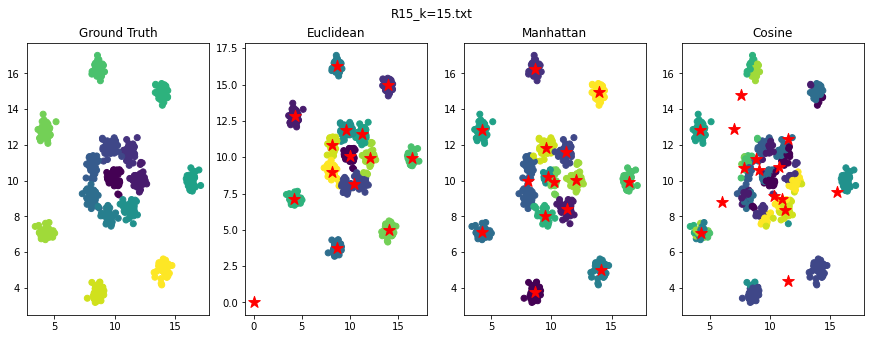

11


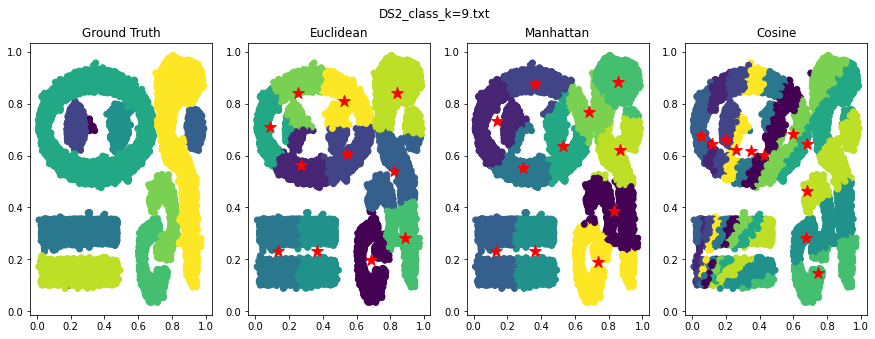

3


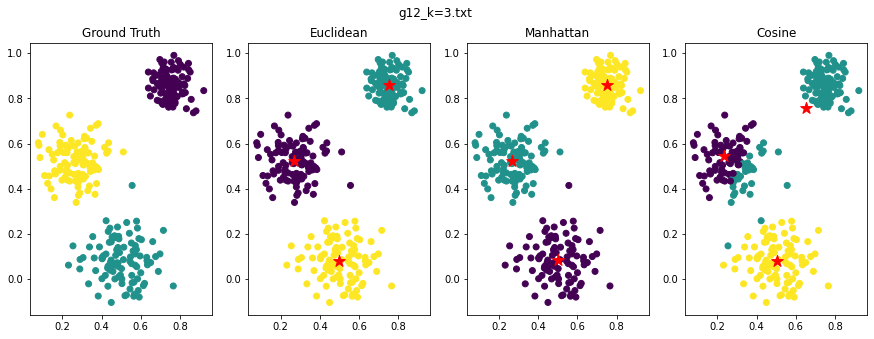

3


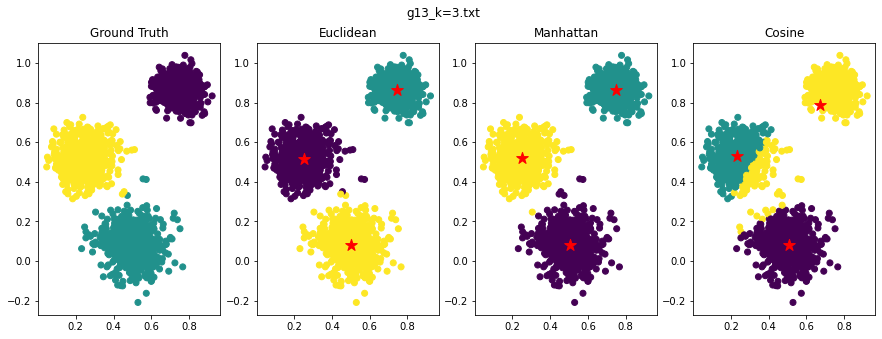

7


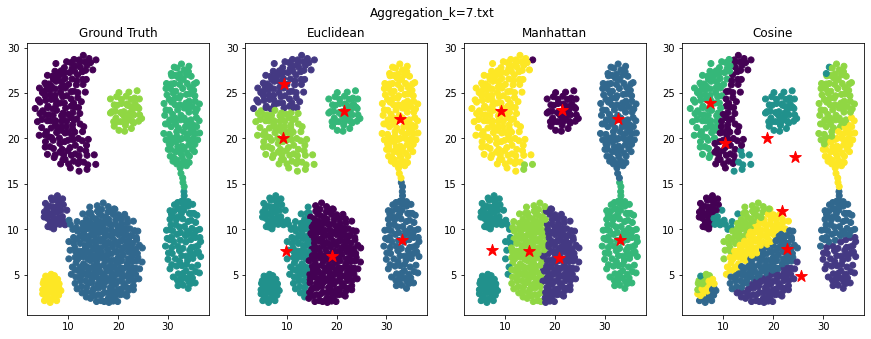

4


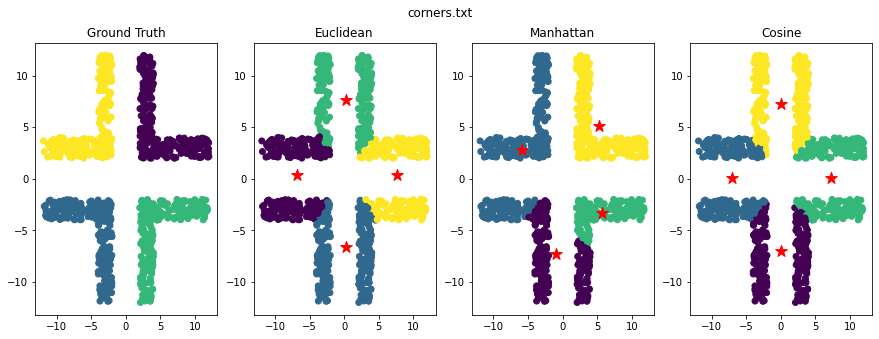

2


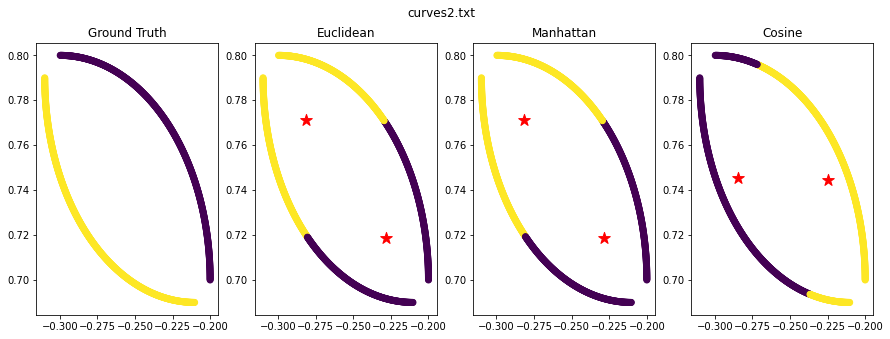

3


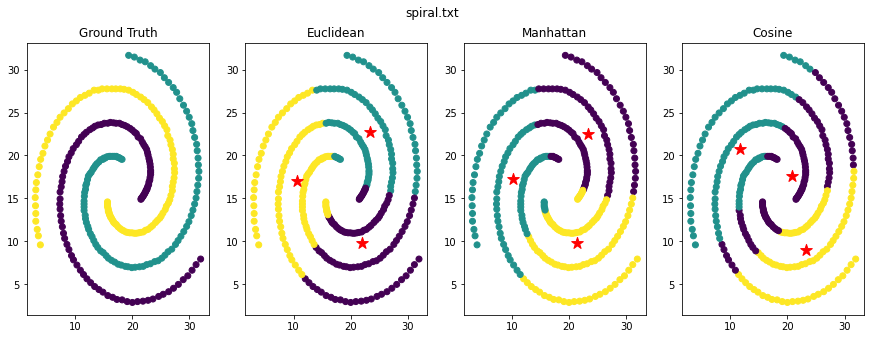

2


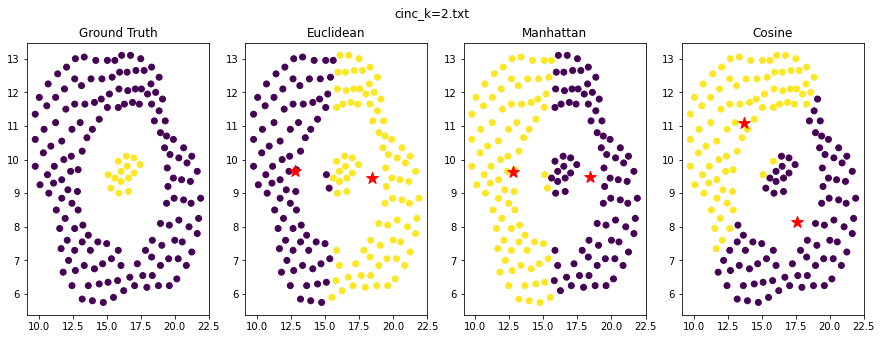

3


<ipython-input-19-724b58a178fb>:10: RuntimeWarning: invalid value encountered in double_scalars
  return np.dot(points, centroid) / (np.linalg.norm(points) * np.linalg.norm(centroid))


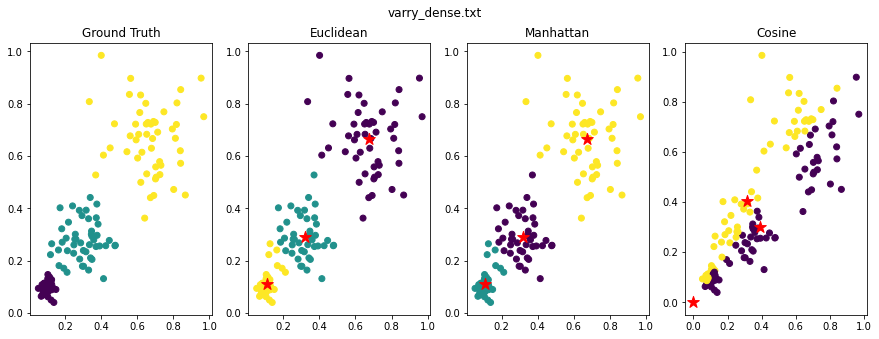

In [ ]:
path = '/content/drive/MyDrive/Data Clustering/LAB-01/Datasets/Synthetic/'
all_file_paths = glob.glob(path + '*.csv') + glob.glob(path + '*.txt')

for file_path in all_file_paths:
  delimiter = ','
  with open(file_path, 'r') as f:
    if ',' in f.readline():
      delimiter = ','
    elif '\t' in f.readline():
      delimiter = '\t'
    else:
      delimiter = ' '
  
  df = pd.read_csv(file_path, sep=delimiter, header=None)
  X, labels = df.iloc[:, :-1], df.iloc[:, -1]
  X, labels = np.array(X), np.array(labels)
  # pre-process the labels
  labels_map = defaultdict(lambda:-1)
  for i, label in enumerate(labels):
    if labels_map[label] == -1:
      labels_map[label] = i
  
  distinct_labels = list(labels_map.keys())
  mapped_labels = [distinct_labels.index(n) for n in labels]
  labels = np.array(mapped_labels)

  dataset_name = os.path.basename(file_path)

  # plotting original dataset
  fig, ax = plt.subplots(1, 4, figsize=(15, 5))
  # fig.tight_layout()
  ax[0].set_title('Ground Truth')
  ax[0].scatter(X[:, 0], X[:, 1], c=labels)

  k = max(labels) + 1
  print(k)
  euclidean_centroids, euclidean_clusters = k_means(k, X, similarity_measure='euclidean')
  ax[1].set_title('Euclidean')
  ax[1].scatter(X[:, 0], X[:, 1], c=euclidean_clusters)
  ax[1].scatter(euclidean_centroids[:, 0], euclidean_centroids[:, 1], marker='*', s=150, c='red')

  manhattan_centroids, manhattan_clusters = k_means(k, X, similarity_measure='manhattan')
  ax[2].set_title('Manhattan')
  ax[2].scatter(X[:, 0], X[:, 1], c=manhattan_clusters)
  ax[2].scatter(manhattan_centroids[:, 0], manhattan_centroids[:, 1], marker='*', s=150, c='red')


  cosine_centroids, cosine_clusters = k_means(k, X, similarity_measure='cosine')
  ax[3].set_title('Cosine')
  ax[3].scatter(X[:, 0], X[:, 1], c=cosine_clusters)
  ax[3].scatter(cosine_centroids[:, 0], cosine_centroids[:, 1], marker='*', s=150, c='red')

  plt.suptitle(dataset_name)
  plt.show()

##Catagorical Datasets

In [ ]:
path = '/content/drive/MyDrive/Data Clustering/LAB-01/Datasets/categorical/'
all_file_paths = glob.glob(path + '*.csv') + glob.glob(path + '*.txt')
for file_path in all_file_paths:
  delimiter = ','
  with open(file_path, 'r') as f:
    if ',' in f.readline():
      delimiter = ','
    elif '\t' in f.readline():
      delimiter = '\t'
    else:
      delimiter = ' '
  df = pd.read_csv(file_path, sep=delimiter, header=None)
  X, labels = df.iloc[:, :-1], df.iloc[:, -1]
  X, labels = np.array(X), np.array(labels)
  # pre-process the labels
  labels_map = defaultdict(lambda:-1)
  for i, label in enumerate(labels):
    if labels_map[label] == -1:
      labels_map[label] = i
  
  distinct_labels = list(labels_map.keys())
  mapped_labels = [distinct_labels.index(n) for n in labels]
  labels = np.array(mapped_labels)

  dataset_name = os.path.basename(file_path)

  centroids, clusters = k_means(k, X)
  si_score = SI(X, clusters)
  ari_score = ARI(labels, clusters)
  print(f'Dataset : {dataset_name} ARI : {ari_score} SI : {si_score}')
  

Dataset : 3_finl_contraceptive.csv ARI : 0.018453684613849906 SI : 0.21955119982800428
Dataset : 2_finl_flare.csv ARI : 0.3394381176087458 SI : 0.23469238301964268
Dataset : 2_finl_nursery.csv ARI : 0.028540650270510563 SI : 0.1490126874060078
Dataset : 15_finl_lymphography.csv ARI : 0.19987713249280425 SI : 0.31649368066342876


In [ ]:
path = '/content/drive/MyDrive/Data Clustering/LAB-01/Datasets/categorical/'
all_file_paths = glob.glob(path + '*.csv') + glob.glob(path + '*.txt')
for file_path in all_file_paths:
  delimiter = ','
  with open(file_path, 'r') as f:
    if ',' in f.readline():
      delimiter = ','
    elif '\t' in f.readline():
      delimiter = '\t'
    else:
      delimiter = ' '
  df = pd.read_csv(file_path, sep=delimiter, header=None)
  X, labels = df.iloc[:, :-1], df.iloc[:, -1]
  X, labels = np.array(X), np.array(labels)
  # pre-process the labels
  labels_map = defaultdict(lambda:-1)
  for i, label in enumerate(labels):
    if labels_map[label] == -1:
      labels_map[label] = i
  
  distinct_labels = list(labels_map.keys())
  mapped_labels = [distinct_labels.index(n) for n in labels]
  labels = np.array(mapped_labels)

  dataset_name = os.path.basename(file_path)

  centroids, clusters = k_means(k, X)
  si_score = SI(X, clusters)
  ari_score = ARI(labels, clusters)
  # 0 1 2
  # 1 2 3
  # 0 1 2
  print(f'Dataset : {dataset_name} ARI : {ari_score} SI : {si_score}')
  

Dataset : 3_finl_contraceptive.csv ARI : 0.033991564297538676 SI : 0.2582564487565313
Dataset : 2_finl_flare.csv ARI : 0.11062693687402464 SI : 0.26267462280180953
Dataset : 2_finl_nursery.csv ARI : 0.027224119222440852 SI : 0.14901268740600793
Dataset : 15_finl_lymphography.csv ARI : 0.19987713249280425 SI : 0.31649368066342876


#Assignment - 3

##K-Mode

In [ ]:
def hamming_dist(point, centroid):
  cnt = 0
  for i in range(len(point)):
    cnt += point[i] != centroid[i]
  
  # print(f'[point : {point}]')
  # print(f'[centroid : {centroid}]')
  # print(cnt)
  return cnt

In [ ]:
def k_mode(k, points, init_centroids=None, max_iterations=20, plotData=False):
    n, m = points.shape
    # initialise centriods if None
    if init_centroids == None:
        init_centroids = []
        for i in range(k):
            curr = []
            for j in range(m):
              curr.append(np.random.choice(points[:, j], replace=False))

            init_centroids.append(curr)

    # plot initial centroids
    
    centroids = np.array(init_centroids, dtype='int')
    if plotData:
        plt.title('Initial Centroids')
        plt.scatter(points[:, 0], points[:, 1])
        plt.scatter(centroids[:, 0], centroids[:, 1],
                    c='red', s=200, marker='*')
        plt.show()

    clusters = np.zeros(n, dtype='int')
    for itr in range(max_iterations):
        # find hamming distance of each point from each centroid
        # assign the point to centroid with minimum hamming distance
        for i in range(n):
          dist, label = sys.maxsize, 0
          for j in range(k):
            curr_dist = hamming_dist(points[i], centroids[j])
            if curr_dist < dist:
              dist = curr_dist
              label = j
          
          clusters[i] = label

        # print(clusters)
        new_centroids = np.zeros((k, m))
        for cluster_no in range(k):
            # X contains all points who belongs to cluster=cluster_no
            X = points[np.where(clusters == cluster_no)]
            if len(X) > 0:
              new_centroids[cluster_no] = stats.mode(X)[0]

        # print(new_centroids)
        if plotData:
            plt.title('Result after iteration : ' + str(itr))
            plt.scatter(points[:, 0], points[:, 1], c=clusters, s=20)
            plt.scatter(centroids[:, 0], centroids[:, 1],
                        c='red', s=200, marker='*')
            plt.scatter(
                new_centroids[:, 0], new_centroids[:, 1], c='blue', s=200, marker='o')
            plt.show()

        if (new_centroids - centroids).sum == 0:
            break
        centroids = new_centroids

    return centroids, clusters

In [ ]:
def run_kmodes(path):
  all_file_paths = glob.glob(path + '*.csv') + glob.glob(path + '*.txt')

  res = {}
  for file_path in all_file_paths:
    delimiter = ','
    with open(file_path, 'r') as f:
      if ',' in f.readline():
        delimiter = ','
      elif '\t' in f.readline():
        delimiter = '\t'
      else:
        delimiter = ' '
    
    df = pd.read_csv(file_path, sep=delimiter, header=None)
    X, labels = df.iloc[:, :-1], df.iloc[:, -1]
    X, labels = np.array(X), np.array(labels)
    # pre-process the labels
    labels_map = defaultdict(lambda:-1)
    for i, label in enumerate(labels):
      if labels_map[label] == -1:
        labels_map[label] = i
    
    distinct_labels = list(labels_map.keys())
    mapped_labels = [distinct_labels.index(n) for n in labels]
    labels = np.array(mapped_labels)

    dataset_name = os.path.basename(file_path)
    k = max(labels) + 1
    centroids, clusters = k_mode(k, X)
    res[dataset_name] = [ARI(labels, clusters), SI(X, clusters)]
    # print(f'{dataset_name} : ARI : {ARI(labels, clusters)}  SI : {SI(X, clusters)}')

  return res

In [ ]:
path = '/content/drive/MyDrive/Data Clustering/LAB-01/Datasets/categorical/'
max_iterations = 10
res = defaultdict(lambda:[])
for _ in range(max_iterations):
  curr_res = run_kmodes(path)
  for dataset in curr_res:
    res[dataset].append(curr_res[dataset])

In [ ]:
for dataset in res:
  res[dataset] = np.array(res[dataset])

In [ ]:
# find mean and standard deviation of ARI and SI for given dataset
def mean_and_std(ari_values, si_values):
  mean_ari = np.mean(ari_values)
  mean_si = np.mean(si_values)
  std_ari = np.std(ari_values)
  std_si = np.std(si_values)
  return [mean_ari, std_ari, mean_si, std_si]

In [ ]:
d = {'dataset' : [], 'mean_ari' : [], 'std_ari' : [], 'mean_si' : [], 'std_si' : []}
for dataset in res:
  ari_val, si_val = res[dataset][:, 0], res[dataset][:, 1]
  curr_res = mean_and_std(res[dataset][:, 0], res[dataset][:, 1])
  d['dataset'].append(dataset)
  d['mean_ari'].append(curr_res[0])
  d['std_ari'].append(curr_res[1])
  d['mean_si'].append(curr_res[2])
  d['std_si'].append(curr_res[3])

df = pd.DataFrame(d)
df

,dataset,mean_ari,std_ari,mean_si,std_si
0,3_finl_contraceptive.csv,0.016509,0.013690,0.052656,0.031372
1,2_finl_flare.csv,0.229986,0.065877,0.061628,0.029457
2,2_finl_nursery.csv,0.048393,0.026109,-0.003491,0.005029
3,15_finl_lymphography.csv,0.079449,0.034772,-0.011267,0.020235


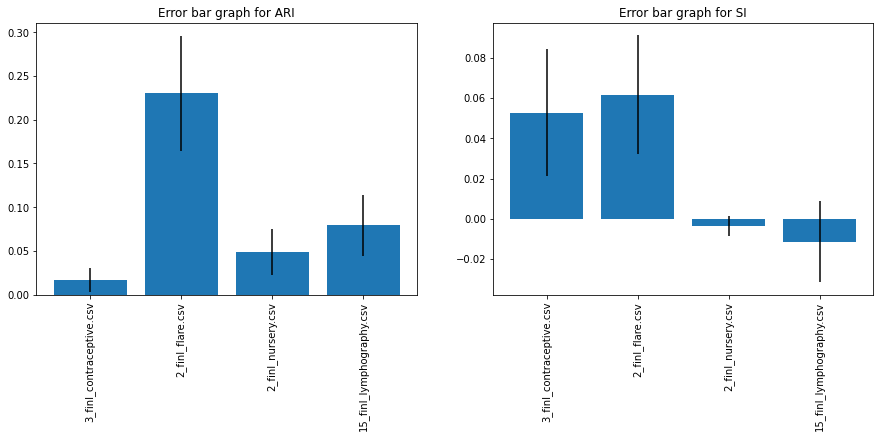

In [ ]:
n = len(d['dataset'])
width = .25
x = np.arange(n)

fig, ax = plt.subplots(1, 2, figsize=(15, 5))

ax[0].bar(d['dataset'], d['mean_ari'], yerr=d['std_ari'])
ax[0].set_xticklabels(d['dataset'], rotation='vertical')
ax[0].set_title('Error bar graph for ARI')
ax[1].bar(d['dataset'], d['mean_si'], yerr=d['std_si'])
ax[1].set_title('Error bar graph for SI')
ax[1].set_xticklabels(d['dataset'], rotation='vertical')
plt.show()

#Assignment - 4

##How to choose best k for clustering?

###Scores

In [ ]:
def kmeans_labels(X, n_clusters):
  if n_clusters == 1:
    return np.repeat(a=0, repeats=len(X))
  else:
    return KMeans(n_clusters=n_clusters).fit(X).labels_

In [ ]:
def find_sse(X, labels):
  sse = 0
  for label in set(labels):
    cluster = X[labels == label, :]
    centroid = np.mean(cluster, axis = 0)
    sse += np.sum((cluster - centroid) ** 2)
  
  return sse

def bic_score(X, labels):
  n_points = len(labels)
  n_clusters = len(set(labels))
  n_dimensions = X.shape[1]

  n_parameters = (n_clusters - 1) + (n_dimensions * n_clusters) + 1

  loglikelihood = 0
  for label_name in set(labels):
    X_cluster = X[labels == label_name]
    n_points_cluster = len(X_cluster)
    centroid = np.mean(X_cluster, axis=0)
    variance = np.sum((X_cluster - centroid) ** 2) / (len(X_cluster) - 1)
    loglikelihood += \
      n_points_cluster * np.log(n_points_cluster) \
      - n_points_cluster * np.log(n_points) \
      - n_points_cluster * n_dimensions / 2 * np.log(2 * math.pi * variance) \
      - (n_points_cluster - 1) / 2
    
  bic = loglikelihood - (n_parameters / 2) * np.log(n_points)
        
  return bic

def calinski_harabasz_score(X, labels):  
  if len(set(labels)) == 1:
    # return float("NaN")
    return 0
  else:
    return sklearn_metrics.calinski_harabasz_score(X, labels)

In [ ]:
def get_score(X, max_k=40, metric="sse"):
  '''run k-means for max_k and choose best depending up score metric used'''
  max_k = min(max_k, len(X))
  scores, x = [], []
  for k in range(1, max_k + 1):
    x.append(k)
    labels = kmeans_labels(X, k)
    if metric == "bic":
      scores.append(bic_score(X, labels))
    elif metric == "chs":
      scores.append(calinski_harabasz_score(X, labels))
    else:
      scores.append(find_sse(X, labels))

  return np.array(scores)

###Synthetic Datasets

Original K : 2


<ipython-input-41-971064e179f7>:22: RuntimeWarning: invalid value encountered in double_scalars
  variance = np.sum((X_cluster - centroid) ** 2) / (len(X_cluster) - 1)
<ipython-input-41-971064e179f7>:22: RuntimeWarning: invalid value encountered in double_scalars
  variance = np.sum((X_cluster - centroid) ** 2) / (len(X_cluster) - 1)
<ipython-input-41-971064e179f7>:22: RuntimeWarning: invalid value encountered in double_scalars
  variance = np.sum((X_cluster - centroid) ** 2) / (len(X_cluster) - 1)
<ipython-input-41-971064e179f7>:22: RuntimeWarning: invalid value encountered in double_scalars
  variance = np.sum((X_cluster - centroid) ** 2) / (len(X_cluster) - 1)
<ipython-input-41-971064e179f7>:22: RuntimeWarning: invalid value encountered in double_scalars
  variance = np.sum((X_cluster - centroid) ** 2) / (len(X_cluster) - 1)
<ipython-input-41-971064e179f7>:22: RuntimeWarning: invalid value encountered in double_scalars
  variance = np.sum((X_cluster - centroid) ** 2) / (len(X_cluste

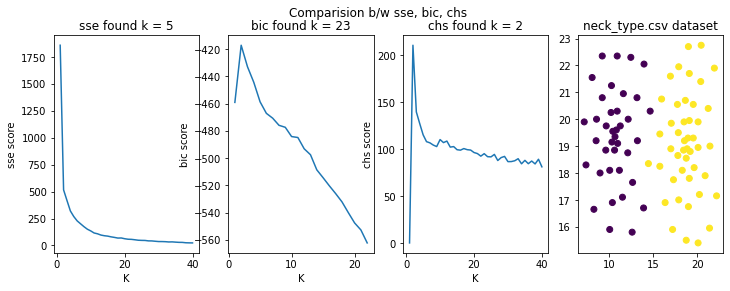

Original K : 3


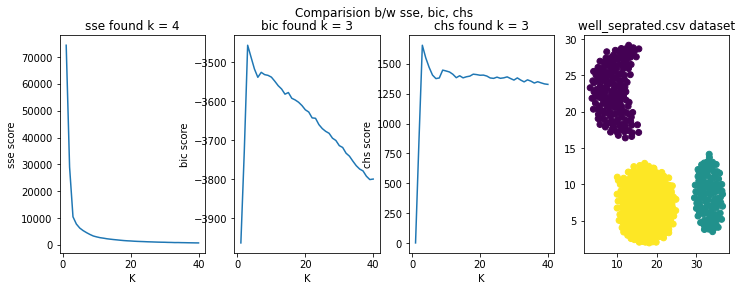

Original K : 31


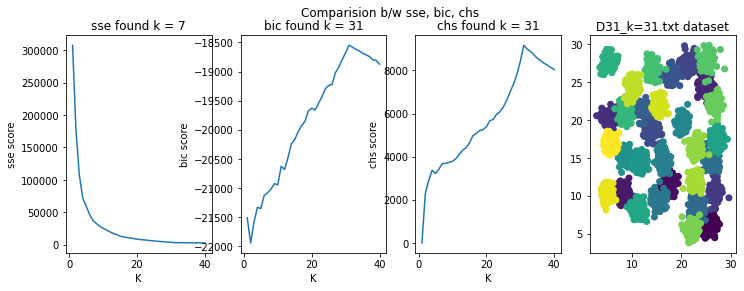

Original K : 2


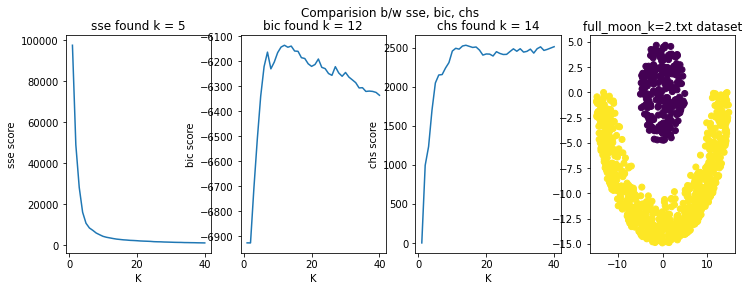

Original K : 2


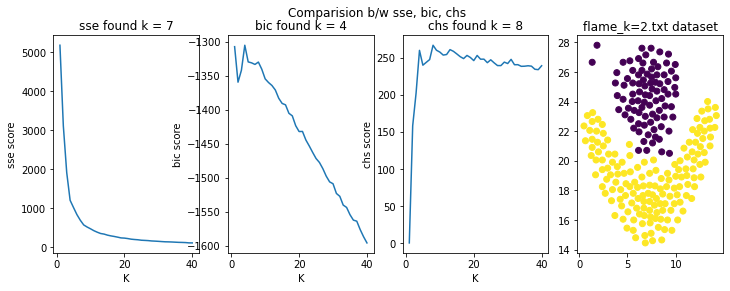

Original K : 2


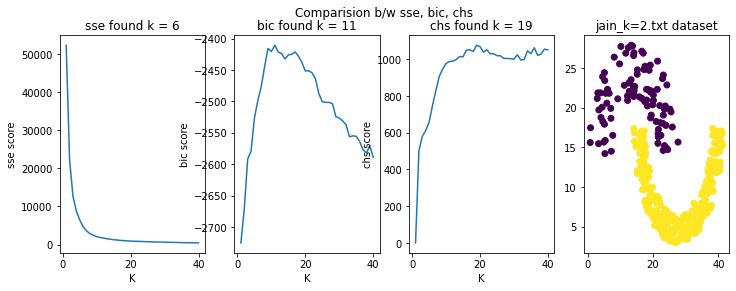

Original K : 15


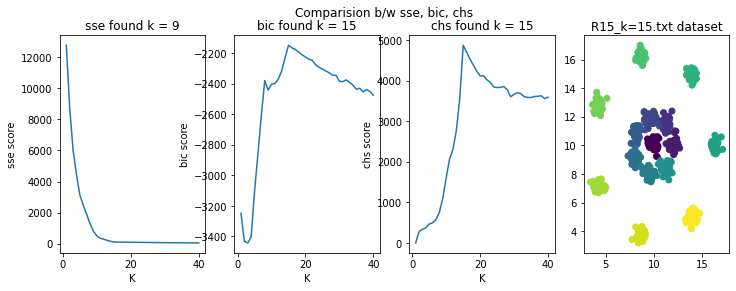

Original K : 11


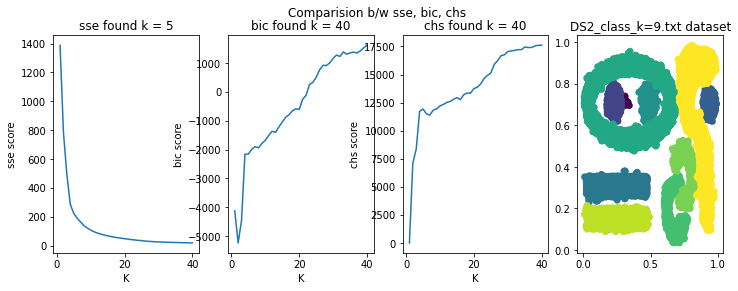

Original K : 3


<ipython-input-41-971064e179f7>:22: RuntimeWarning: invalid value encountered in double_scalars
  variance = np.sum((X_cluster - centroid) ** 2) / (len(X_cluster) - 1)
<ipython-input-41-971064e179f7>:22: RuntimeWarning: invalid value encountered in double_scalars
  variance = np.sum((X_cluster - centroid) ** 2) / (len(X_cluster) - 1)
<ipython-input-41-971064e179f7>:22: RuntimeWarning: invalid value encountered in double_scalars
  variance = np.sum((X_cluster - centroid) ** 2) / (len(X_cluster) - 1)
<ipython-input-41-971064e179f7>:22: RuntimeWarning: invalid value encountered in double_scalars
  variance = np.sum((X_cluster - centroid) ** 2) / (len(X_cluster) - 1)
<ipython-input-41-971064e179f7>:22: RuntimeWarning: invalid value encountered in double_scalars
  variance = np.sum((X_cluster - centroid) ** 2) / (len(X_cluster) - 1)
<ipython-input-41-971064e179f7>:22: RuntimeWarning: invalid value encountered in double_scalars
  variance = np.sum((X_cluster - centroid) ** 2) / (len(X_cluste

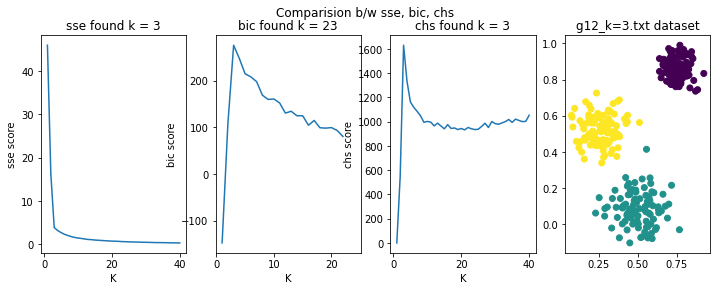

Original K : 3


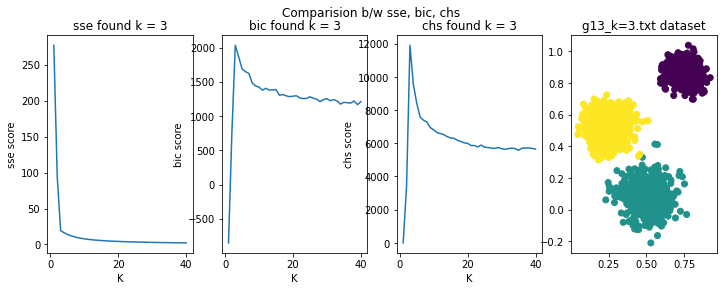

Original K : 7


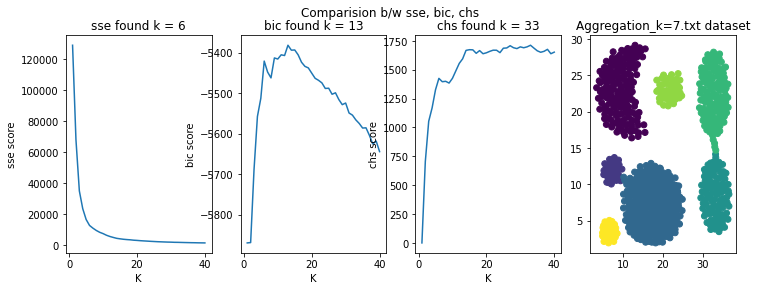

Original K : 4


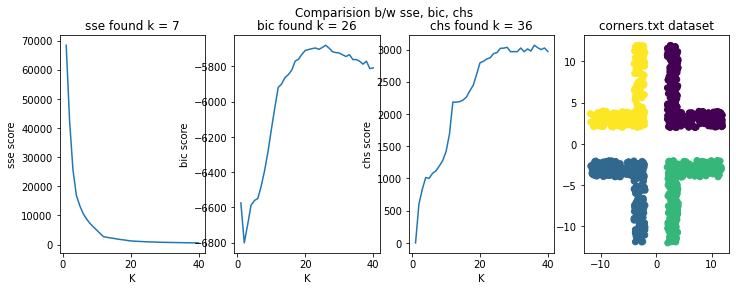

Original K : 2


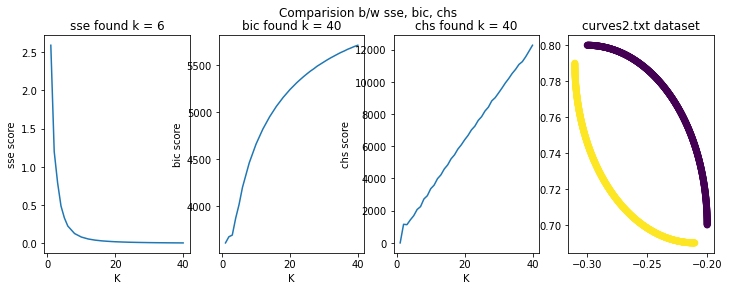

Original K : 3


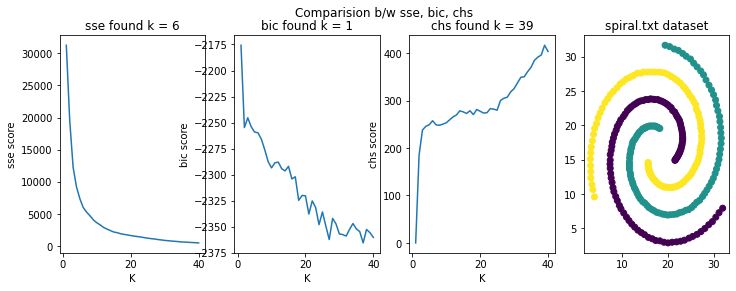

Original K : 2


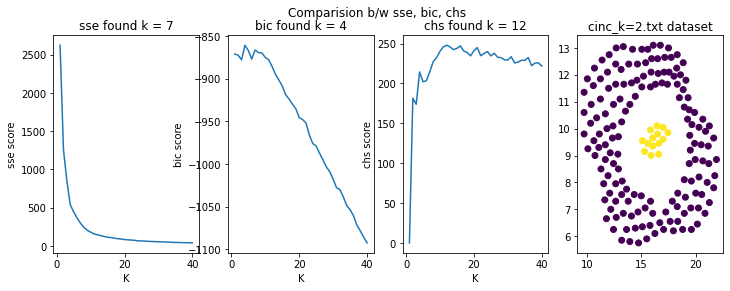

Original K : 3


<ipython-input-41-971064e179f7>:22: RuntimeWarning: invalid value encountered in double_scalars
  variance = np.sum((X_cluster - centroid) ** 2) / (len(X_cluster) - 1)
<ipython-input-41-971064e179f7>:22: RuntimeWarning: invalid value encountered in double_scalars
  variance = np.sum((X_cluster - centroid) ** 2) / (len(X_cluster) - 1)
<ipython-input-41-971064e179f7>:22: RuntimeWarning: invalid value encountered in double_scalars
  variance = np.sum((X_cluster - centroid) ** 2) / (len(X_cluster) - 1)
<ipython-input-41-971064e179f7>:22: RuntimeWarning: invalid value encountered in double_scalars
  variance = np.sum((X_cluster - centroid) ** 2) / (len(X_cluster) - 1)
<ipython-input-41-971064e179f7>:22: RuntimeWarning: invalid value encountered in double_scalars
  variance = np.sum((X_cluster - centroid) ** 2) / (len(X_cluster) - 1)
<ipython-input-41-971064e179f7>:22: RuntimeWarning: invalid value encountered in double_scalars
  variance = np.sum((X_cluster - centroid) ** 2) / (len(X_cluste

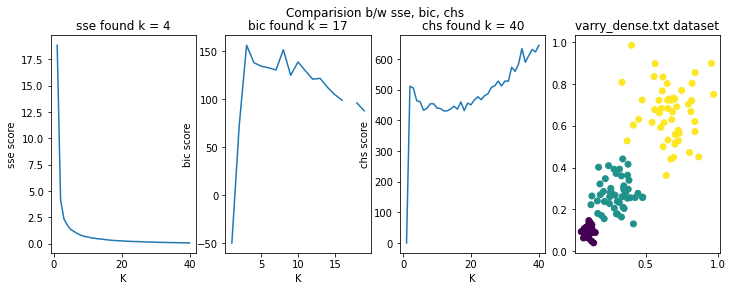

In [ ]:
path = '/content/drive/MyDrive/Data Clustering/LAB-01/Datasets/Synthetic/'
x = np.array([i for i in range(1, 41)])

all_file_paths = glob.glob(path + '*.csv') + glob.glob(path + '*.txt')
for file_path in all_file_paths:
  delimiter = ','
  with open(file_path, 'r') as f:
    if ',' in f.readline():
      delimiter = ','
    elif '\t' in f.readline():
      delimiter = '\t'
    else:
      delimiter = ' '
  
  df = pd.read_csv(file_path, sep=delimiter, header=None)
  X, labels = df.iloc[:, :-1], df.iloc[:, -1]
  X, labels = np.array(X), np.array(labels)
  # pre-process the labels
  labels_map = defaultdict(lambda:-1)
  for i, label in enumerate(labels):
    if labels_map[label] == -1:
      labels_map[label] = i
  
  distinct_labels = list(labels_map.keys())
  mapped_labels = [distinct_labels.index(n) for n in labels]
  labels = np.array(mapped_labels)

  dataset_name = os.path.basename(file_path)
  original_k = max(labels) + 1
  print(f'Original K : {original_k}')

  scores = dict()
  metrices = ["sse", "bic", "chs"]
  for metric in metrices:
    scores[metric] = get_score(X, metric=metric)
  
  fig, ax = plt.subplots(1, 4, figsize=(12, 4))
  best_k = dict()
  for i in range(len(metrices)):
    ax[i].plot(x, scores[metrices[i]])
    ax[i].set_xlabel('K')
    ax[i].set_ylabel(metrices[i] + " score")
    if metrices[i] == "sse":
      # find elbow
      best_k[metrices[i]] = KneeLocator(x, scores[metrices[i]], curve="convex", direction="decreasing").knee
    else :
      best_k[metrices[i]] = np.argmax(scores[metrices[i]]) + 1
    
    ax[i].title.set_text(metrices[i] + " found k = " + str(best_k[metrices[i]]))

    
  ax[3].scatter(X[:, 0], X[:, 1], c=labels)
  ax[3].title.set_text(dataset_name + " dataset")
  fig.suptitle("Comparision b/w sse, bic, chs")
  plt.show()

#Assignment - 5

##K-Means++

In [ ]:
def choose_farthest_point(centroids, X):
  centroid = centroids[-1]
  dist = 0
  farthest_point = X[0]
  for point in X:
    min_dist = sys.maxsize
    for centroid in centroids:
      curr_dist = ((point - centroid) ** 2).sum()
      if curr_dist < min_dist:
        min_dist = curr_dist

    if min_dist > dist:
      farthest_point = point
      dist = min_dist

  return farthest_point

def kmeans_pp(X, k):
  '''
    Steps in K-Means++
      1. choose the initial centroid at random
      2. calculate the distance of chosen centroid from all the points 
      3. choose the point which is at farthest distance from all previously chosen centroids as new centroid
      4. keep repeating until k centroids are chosen
  '''
  # choose the initial centroid
  n, m = X.shape
  index = np.random.randint(n)
  centroids = []
  centroids.append(X[index])

  while len(centroids) < k:
    centroids.append(choose_farthest_point(centroids, X))
  
  return np.array(centroids)

In [ ]:
def find_sse(X, labels):
  sse = 0
  for label in set(labels):
    cluster = X[labels == label, :]
    centroid = np.mean(cluster, axis = 0)
    sse += np.sum((cluster - centroid) ** 2)
  
  return sse

In [ ]:
def run_kmeans(path):
  all_file_paths = glob.glob(path + '*.csv') + glob.glob(path + '*.txt')
  data = {"Dataset" : [], "SSE" : [], "SI" : [], "ARI" : []}
  for file_path in all_file_paths:
    delimiter = ','
    with open(file_path, 'r') as f:
      if ',' in f.readline():
        delimiter = ','
      elif '\t' in f.readline():
        delimiter = '\t'
      else:
        delimiter = ' '
    
    df = pd.read_csv(file_path, sep=delimiter, header=None)
    X, labels = df.iloc[:, :-1], df.iloc[:, -1]
    X, labels = np.array(X), np.array(labels)

    # pre-process the labels
    labels_map = defaultdict(lambda:-1)
    for i, label in enumerate(labels):
      if labels_map[label] == -1:
        labels_map[label] = i
    
    distinct_labels = list(labels_map.keys())
    mapped_labels = [distinct_labels.index(n) for n in labels]
    labels = np.array(mapped_labels)

    dataset_name = os.path.basename(file_path)
    original_k = max(labels) + 1
    centroids = kmeans_pp(X=X, k=original_k)

    cc, clusters = k_means(k=original_k, points=X, init_centroids=centroids)

    sse = find_sse(X, clusters)
    si = SI(X, clusters)
    ari = ARI(labels, clusters)

    data["Dataset"].append(dataset_name)
    data["SSE"].append(sse)
    data["SI"].append(si)
    data["ARI"].append(ari)

  return data

In [ ]:
syn_path = '/content/drive/MyDrive/Data Clustering/LAB-01/Datasets/Synthetic/'

syn_res = run_kmeans(path=syn_path)
print(syn_res)


In [ ]:
cols = ["Dataset", "SSE", "SI", "ARI"]
df = pd.DataFrame(data=syn_res, columns=cols)
print(df)

                Dataset           SSE        SI       ARI
0         neck_type.csv    515.637485  0.603170  0.951805
1     well_seprated.csv  10460.745665  0.637570  1.000000
2          D31_k=31.txt   4158.625945  0.534149  0.866492
3     full_moon_k=2.txt  48820.106522  0.427458 -0.001657
4         flame_k=2.txt   3144.489971  0.377319  0.464872
5          jain_k=2.txt  22211.831948  0.495072  0.300352
6          R15_k=15.txt    108.619041  0.752739  0.992778
7     DS2_class_k=9.txt     95.836592  0.412366  0.340960
8           g12_k=3.txt      3.839408  0.726730  0.989983
9           g13_k=3.txt     19.445826  0.752482  0.995007
10  Aggregation_k=7.txt  11812.115309  0.478401  0.763249
11          corners.txt  16861.660555  0.390304  0.339812
12          curves2.txt      1.200132  0.465988 -0.000998
13           spiral.txt  12317.074986  0.360103 -0.005960
14         cinc_k=2.txt   1261.480374  0.432856  0.004906
15      varry_dense.txt      2.349897  0.623698  0.865863


In [ ]:
real_path = '/content/drive/MyDrive/Data Clustering/LAB-01/Datasets/Real/'
real_res = run_kmeans(path = real_path)

In [ ]:
real_df = pd.DataFrame(data=real_res, columns=cols)
print(real_df)

              Dataset           SSE        SI       ARI
0           glass.csv  3.790758e+02  0.583318  0.267733
1  heart_data_k=2.txt  5.493147e+05  0.380418  0.030230
2   hepatitis_k=2.txt  1.417547e+06  0.728282  0.002913
3            wine.txt  2.633555e+06  0.559582  0.351772
4       iris2_k=3.txt  7.894084e+01  0.552592  0.730238


before next lab
practice plotting MST for datasets

#Assignment - 6

##MST of Dataset

In [ ]:
def find_distance(a, b, measure="euclidean"):
  return ((a - b) ** 2).sum()

In [ ]:
def build_complete_graph(points):
  n, m = points.shape
  # adj_mat = [[0] * n] * n
  adj_mat = np.array([[0] * n] * n, np.double)
  for i in range(n):
    for j in range(i + 1, n):
      if i == j:
        adj_mat[i][j] = math.inf
        continue
      adj_mat[i][j] = adj_mat[j][i] = find_distance(a = points[i], b = points[j])
  
  return adj_mat

In [ ]:
def prims(adj_mat):
  '''
      1. for every not yet selected vertex we will store the minimum edge to an already selected vertex.
      2. Then during a step we only have to look at these minimum weight edges.
  '''
  
  n = len(adj_mat)
  min_e = np.array([[sys.maxsize, -1]] * n, np.double) # stores the minimum weight edge to an already selected vertex
  selected = np.array([False] * n)
  mst = []
  min_e[0][0] = 0
  for i in range(n):
    u = -1
    for j in range(n):
      if (selected[j] == False) and (u == -1 or min_e[j][0] < min_e[u][0]):
        u = j
    
    if min_e[u][0] == math.inf:
      print("No MST")
      return []
    
    selected[u] = True
    if min_e[u][1] != -1:
      mst.append([u, min_e[u][1]])
    
    for v in range(n):
      if adj_mat[u][v] < min_e[v][0]:
        min_e[v][0] = adj_mat[u][v]
        min_e[v][1] = u

  return np.array(mst, dtype=int)

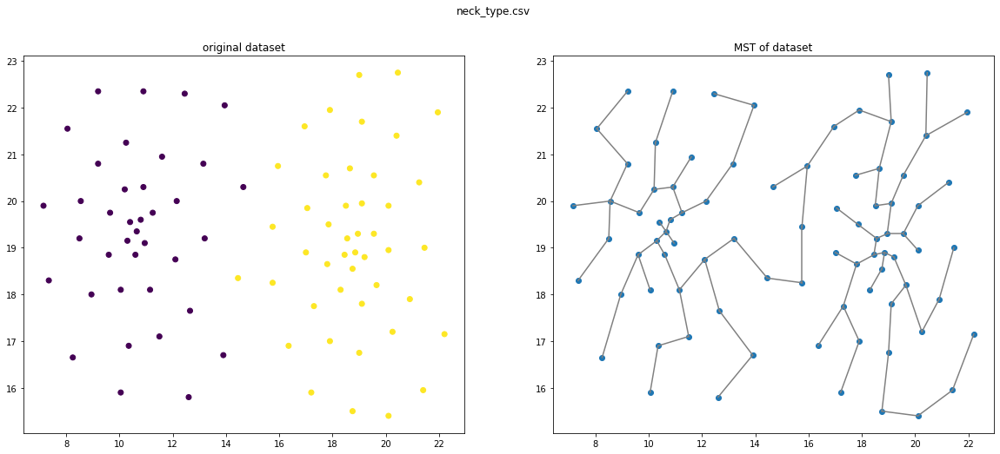

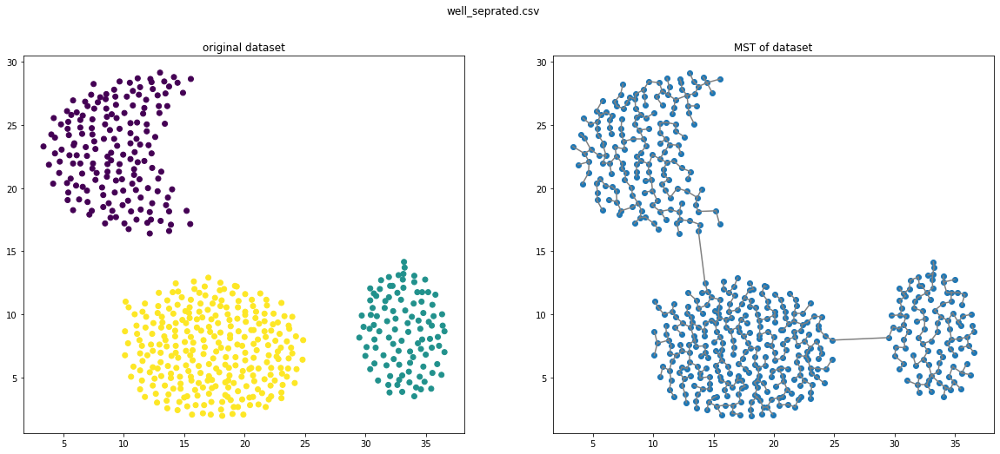

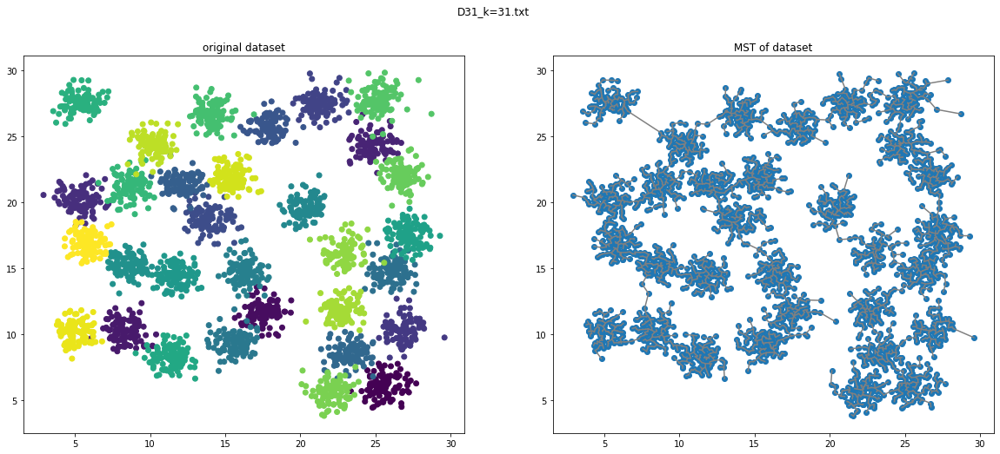

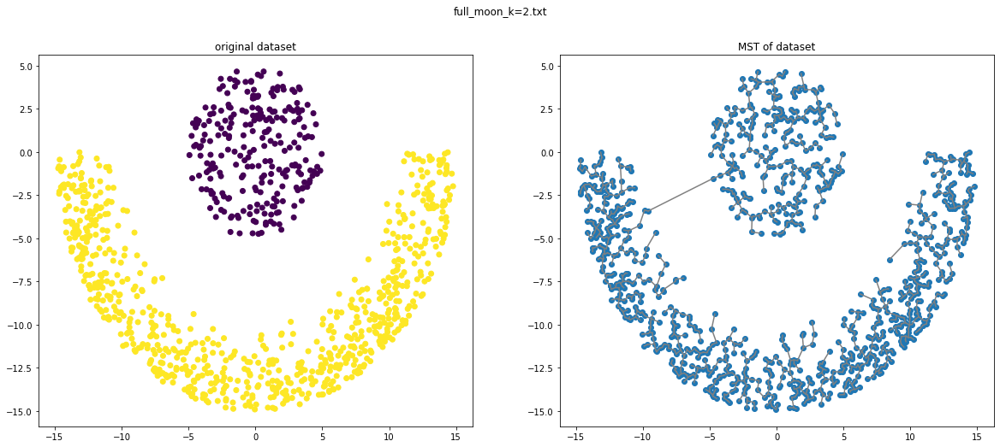

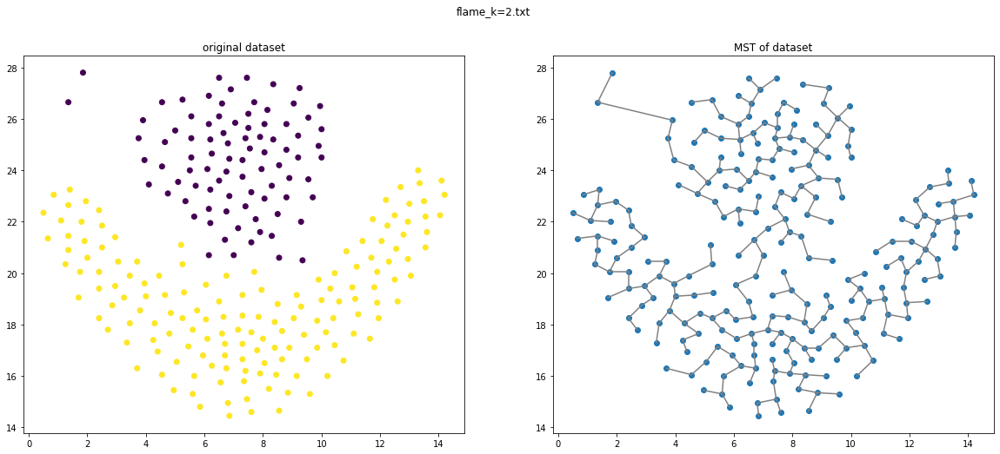

...

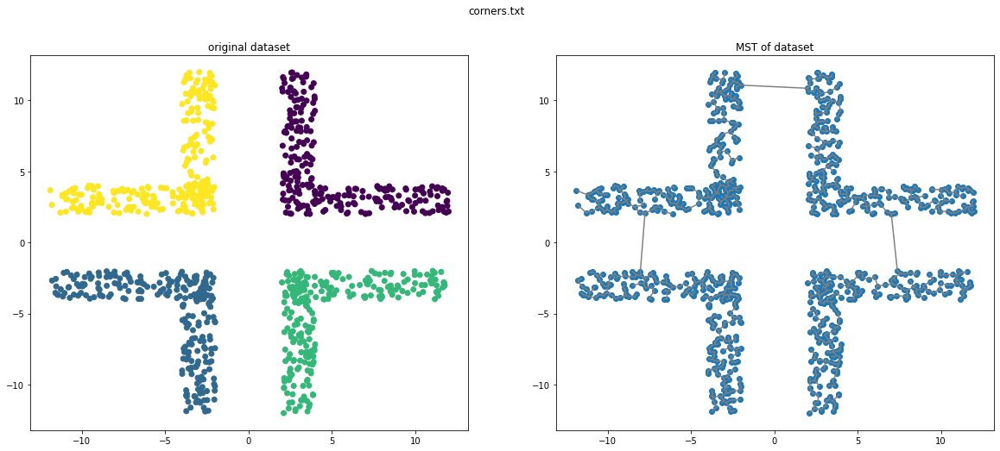

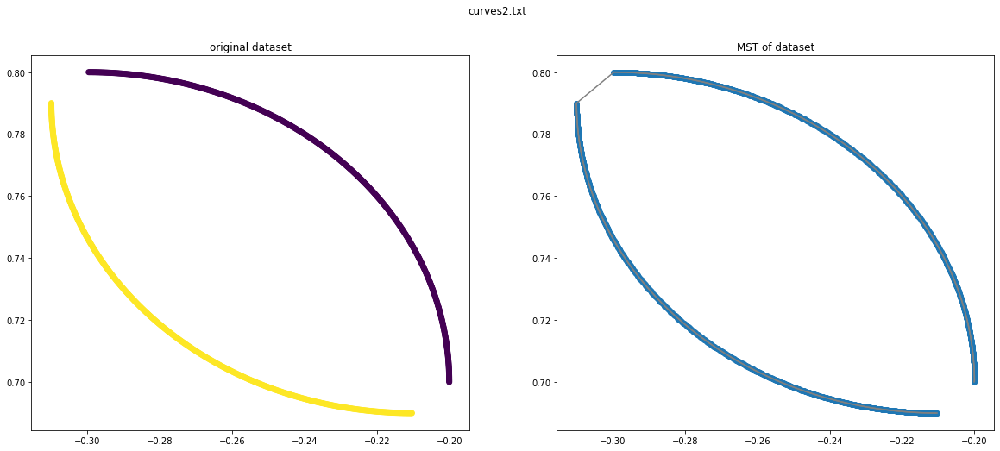

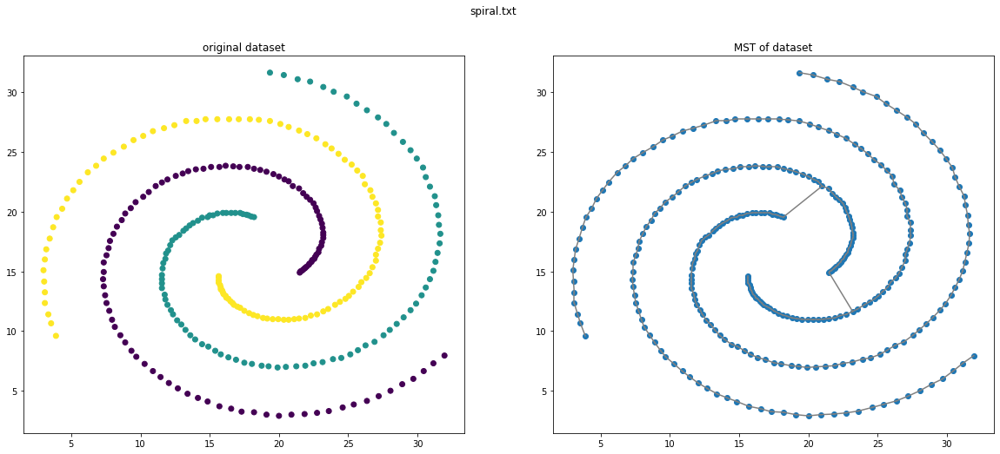

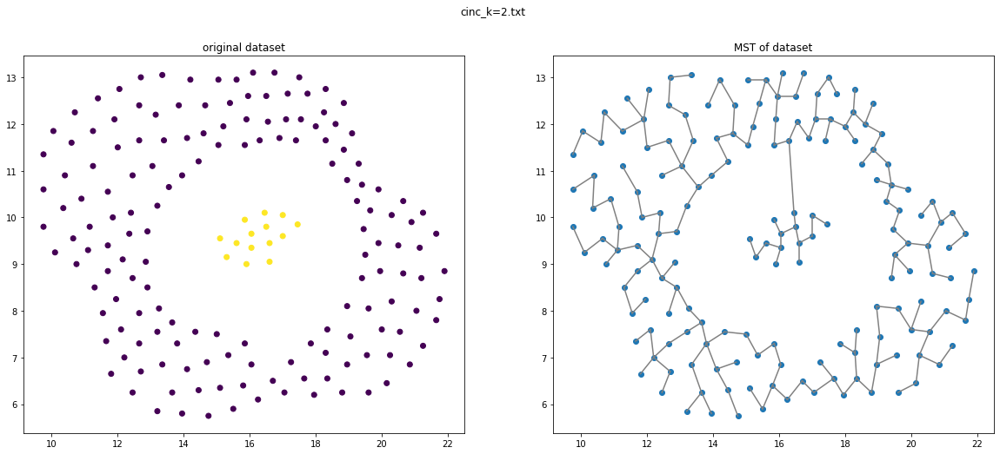

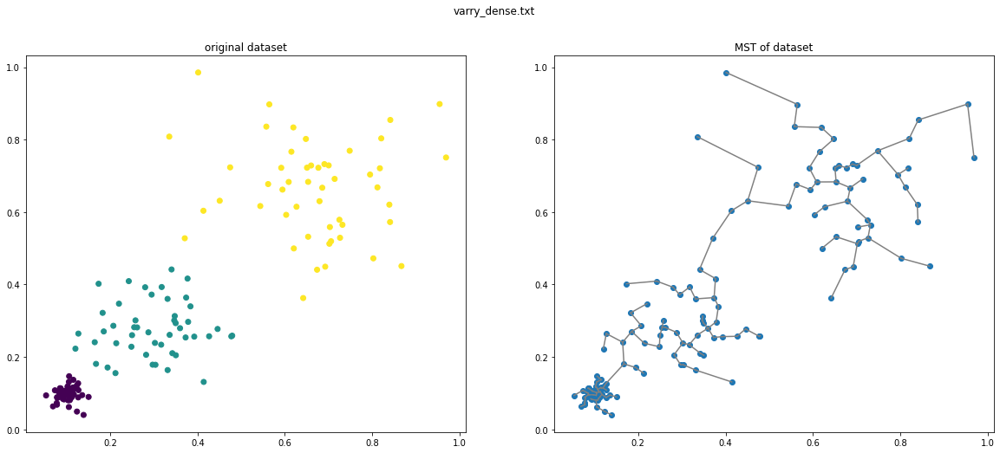

In [ ]:
path = '/content/drive/MyDrive/Data Clustering/LAB-01/Datasets/Synthetic/'
all_file_paths = glob.glob(path + '*.csv') + glob.glob(path + '*.txt')
MST = dict()
for file_path in all_file_paths:
  points, labels = read_dataset(file_path)
  adj_mat = build_complete_graph(points)
  
  mst = prims(adj_mat) # mst contains u, v edges of mst
  dataset_name = os.path.basename(file_path)
  MST[dataset_name] = mst
  # print(mst)
  # plot data
  fig, ax = plt.subplots(1, 2, figsize=(20, 8))
  ax[0].scatter(points[:,  0], points[:, 1], c=labels)
  ax[0].set_title('original dataset')

  ax[1].set_title('MST of dataset')
  ax[1].scatter(points[:,  0], points[:, 1])
  for edge in mst:
    u, v = edge
    ax[1].plot([points[u][0], points[v][0]], [points[u][1], points[v][1]], color='gray')
  
  plt.suptitle(dataset_name)
  plt.show()

##Hierarchical Clustering

###Single Linkage

In [ ]:
# def h_clustering(adj_mat, k=1, type='single_linkage'):


In [ ]:
def single_linkage(adj_mat, k=1):
  clusters = []
  n = len(adj_mat)
  
  # initially there will be n cluster
  for i in range(n):
    cluster = []
    cluster.append(i)
    clusters.append(cluster)

  while len(clusters) > k:
    # find two clusters such that min distance b/w these 2 clusters is min
    chosen1, chosen2 = 0, 1
    min_dist = sys.maxsize
    for i in range(len(clusters)):
      for j in range(i + 1, len(clusters)):
        curr_min_dist = sys.maxsize
        for p in clusters[i]:
          for q in clusters[j]:
            curr_min_dist = min(curr_min_dist, adj_mat[p][q])
        
        if curr_min_dist < min_dist:
          min_dist = curr_min_dist
          chosen1, chosen2 = i, j
    
    # merge the chosen clusters
    # add the smaller cluster to larger cluster
    if len(clusters[chosen1]) < len(clusters[chosen2]):
      temp = chosen1
      chosen1 = chosen2
      chosen2 = temp
    
    for index in clusters[chosen2]:
      clusters[chosen1].append(index)
    new_clusters = []
    for index in range(len(clusters)):
      if index == chosen2:
        continue
      new_clusters.append(clusters[index])

    clusters = new_clusters
  
  labels = np.array([0] * n)
  for i in range(len(clusters)):
    for p in clusters[i]:
      labels[p] = i
  
  return labels


###complete linkage or max linkage

In [ ]:
def complete_linkage(adj_mat, k=1):
  clusters = []
  n = len(adj_mat)
  for i in range(n):
    cluster = []
    cluster.append(i)
    clusters.append(cluster)

  # print(clusters)
  while len(clusters) > k:
    # find two clusters such that max distance b/w these 2 clusters is min
    chosen1, chosen2 = 0, 1
    min_dist = sys.maxsize
    for i in range(len(clusters)):
      for j in range(i + 1, len(clusters)):
        max_dist = 0
        for p in clusters[i]:
          for q in clusters[j]:
            max_dist = max(max_dist, adj_mat[p][q])
        
        if max_dist < min_dist:
          min_dist = max_dist
          chosen1, chosen2 = i, j
    
    # merge the chosen clusters
    # add the smaller cluster to larger cluster
    if len(clusters[chosen1]) < len(clusters[chosen2]):
      temp = chosen1
      chosen1 = chosen2
      chosen2 = temp
    
    for index in clusters[chosen2]:
      clusters[chosen1].append(index)
    new_clusters = []
    for index in range(len(clusters)):
      if index == chosen2:
        continue
      new_clusters.append(clusters[index])

    clusters = new_clusters
    # print(clusters)
  labels = np.array([0] * n)
  for i in range(len(clusters)):
    for p in clusters[i]:
      labels[p] = i
  
  return labels


###group average linkage

In [ ]:
def average_linkage(adj_mat, k=1):
  clusters = []
  n = len(adj_mat)
  for i in range(n):
    cluster = []
    cluster.append(i)
    clusters.append(cluster)

  # print(clusters)
  while len(clusters) > k:
    # find two clusters such that max distance b/w these 2 clusters is min
    chosen1, chosen2 = 0, 1
    min_dist = sys.maxsize
    for i in range(len(clusters)):
      for j in range(i + 1, len(clusters)):
        max_dist = 0
        avg_dist = 0
        for p in clusters[i]:
          for q in clusters[j]:
            avg_dist += adj_mat[p][q]
        
        avg_dist = (avg_dist / (len(clusters[i]) * len(clusters[j])))
        if avg_dist < min_dist:
          min_dist = avg_dist
          chosen1, chosen2 = i, j
    
    # merge the chosen clusters
    # add the smaller cluster to larger cluster
    if len(clusters[chosen1]) < len(clusters[chosen2]):
      temp = chosen1
      chosen1 = chosen2
      chosen2 = temp
    
    for index in clusters[chosen2]:
      clusters[chosen1].append(index)
    new_clusters = []
    for index in range(len(clusters)):
      if index == chosen2:
        continue
      new_clusters.append(clusters[index])

    clusters = new_clusters
    # print(clusters)
  labels = np.array([0] * n)
  for i in range(len(clusters)):
    for p in clusters[i]:
      labels[p] = i
  
  return labels


###testing on datasets

In [ ]:
path = '/content/drive/MyDrive/Data Clustering/LAB-01/Datasets/Synthetic/neck_type.csv'
points, labels = read_dataset(path)
# all_file_paths = glob.glob(path + '*.csv') + glob.glob(path + '*.txt')
# for file_path in all_file_paths:
# points, labels = read_dataset(file_path)
adj_mat = build_complete_graph(points)
dataset_name = os.path.basename(path)
# print(dataset_name)
original_k = max(labels) + 1
clusters = complete_linkage(adj_mat, k=original_k)

fig, ax = plt.subplots(1, 2, figsize=(12, 6))
ax[0].scatter(points[:, 0], points[:, 1], c=labels)
ax[0].set_title('Original Labels')

ax[1].scatter(points[:, 0], points[:, 1], c=clusters)
ax[1].set_title('Single Linkage Labels')
fig.suptitle(dataset_name)

print(clusters)

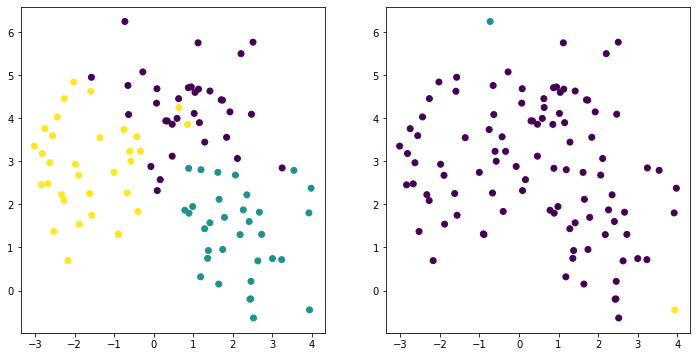

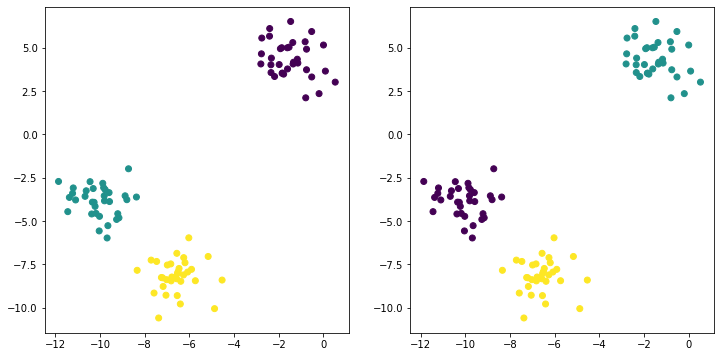

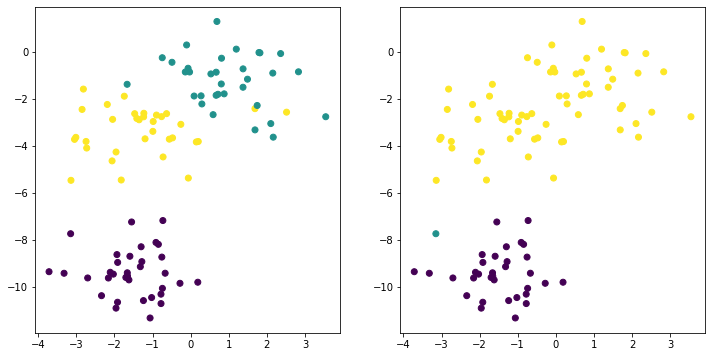

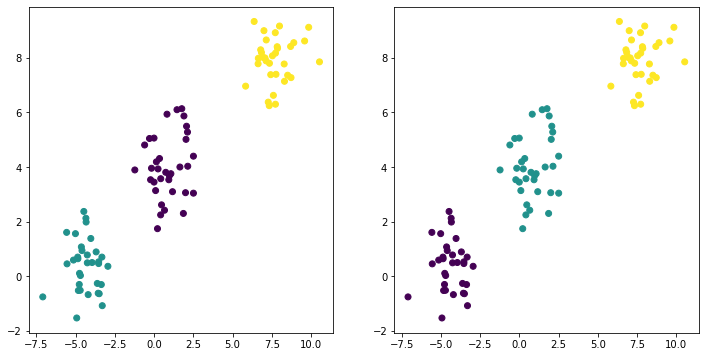

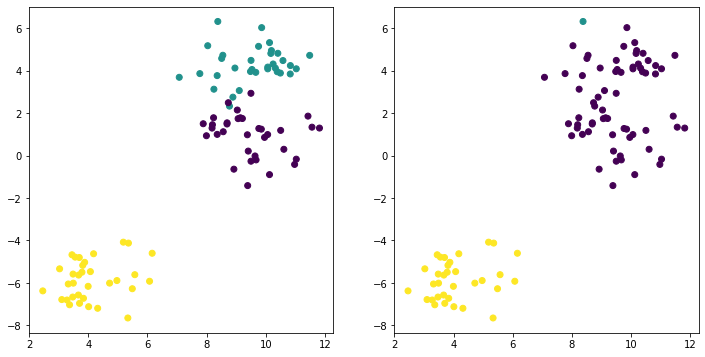

...

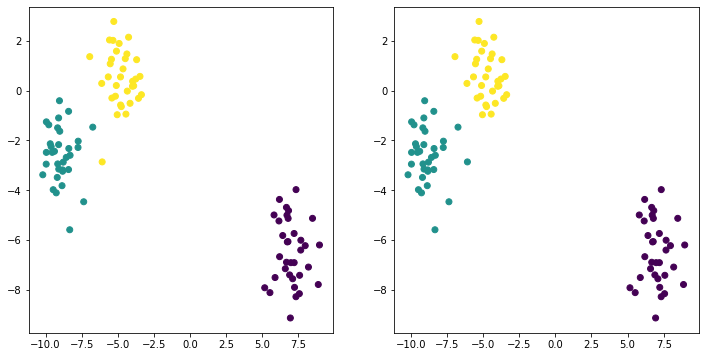

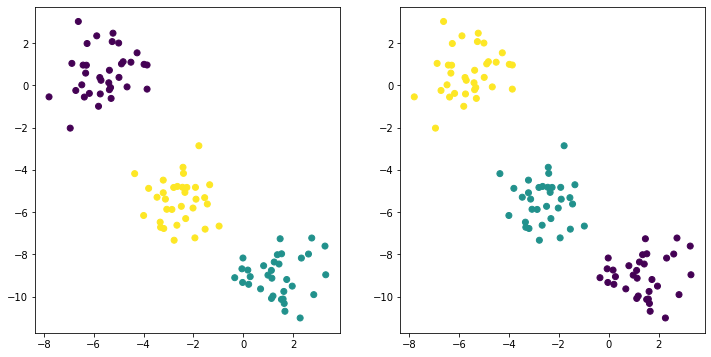

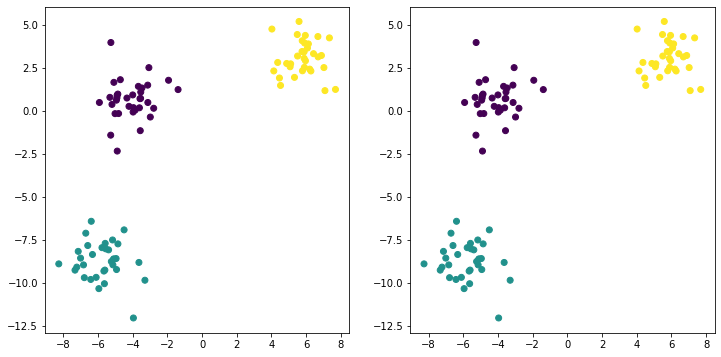

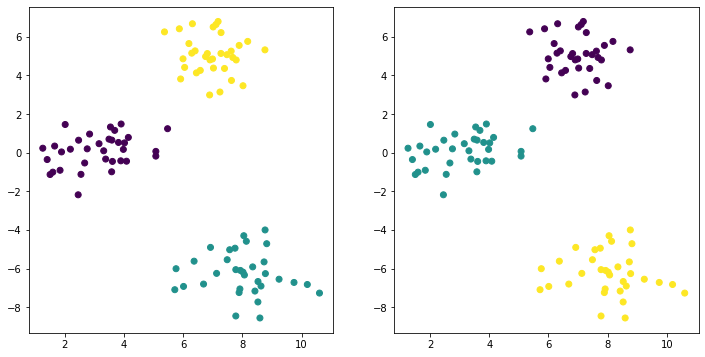

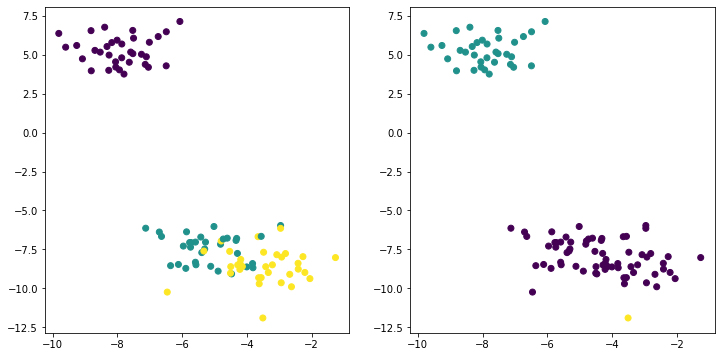

In [ ]:
for i in range(20):
  X, y = make_blobs(n_samples=100, centers=3, n_features=2, random_state=i)
  adj_mat = build_complete_graph(X)
  clusters = single_linkage(adj_mat, k=3)
  fig, ax = plt.subplots(1, 2, figsize=(12, 6))
  ax[0].scatter(X[:, 0], X[:, 1], c=y)
  ax[1].scatter(X[:, 0], X[:, 1], c=clusters)

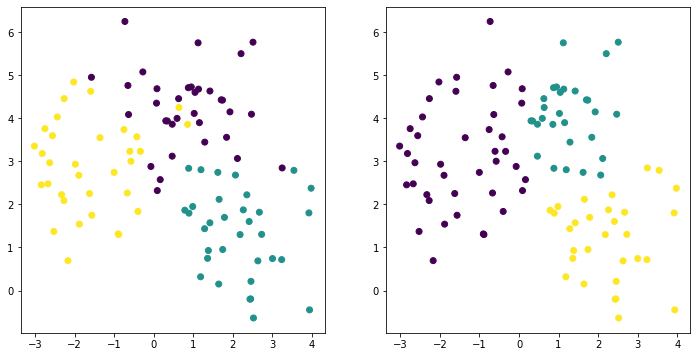

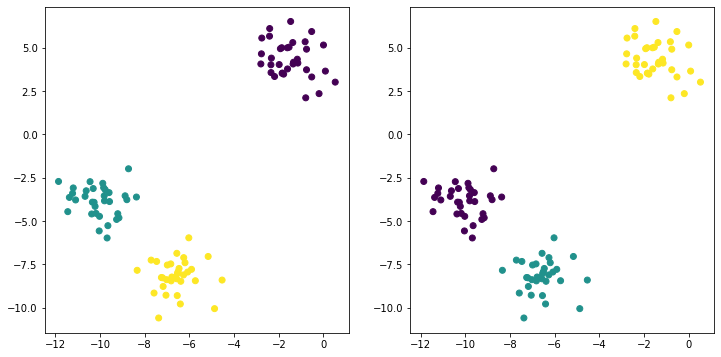

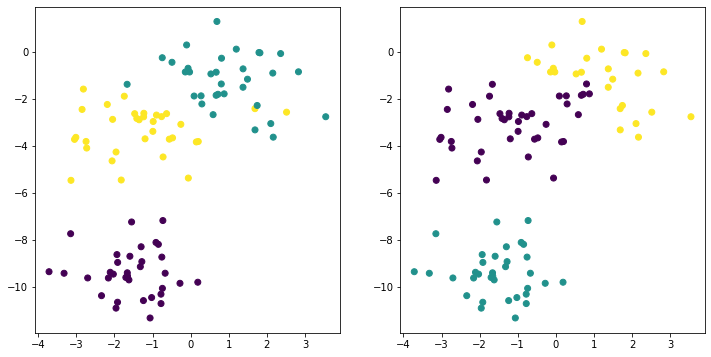

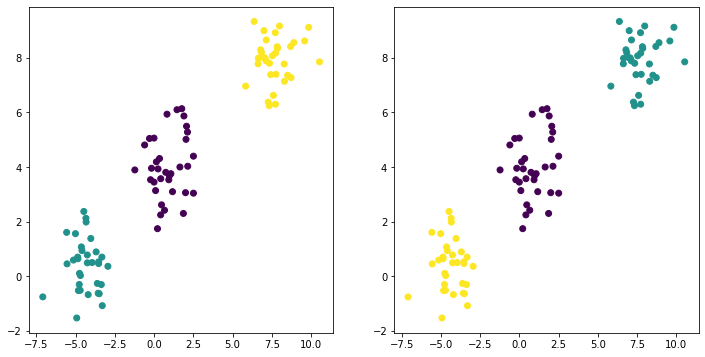

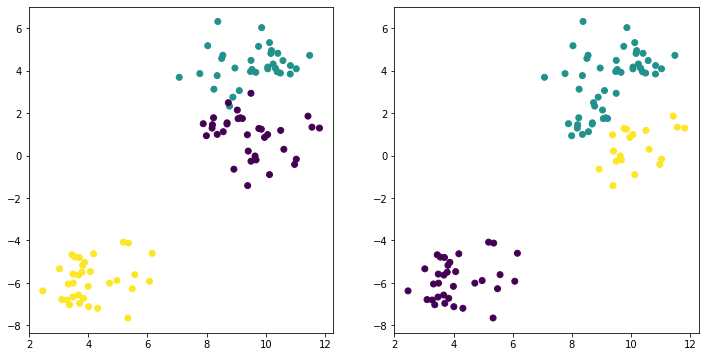

...

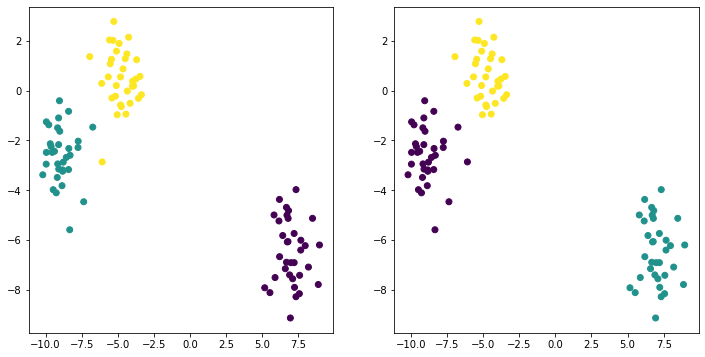

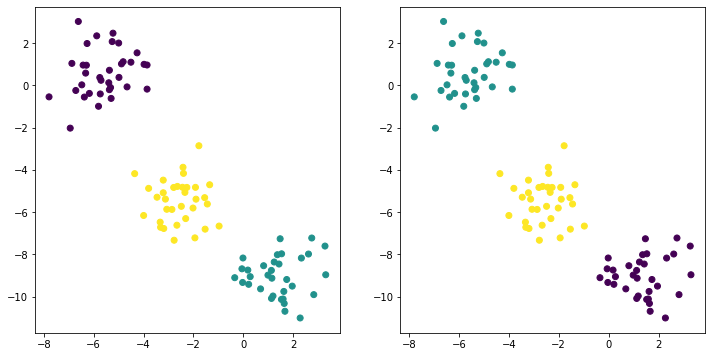

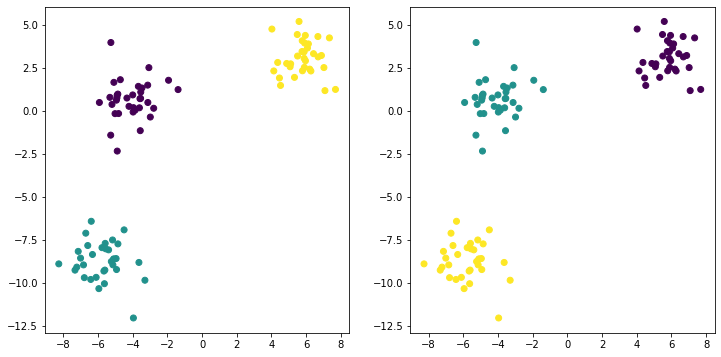

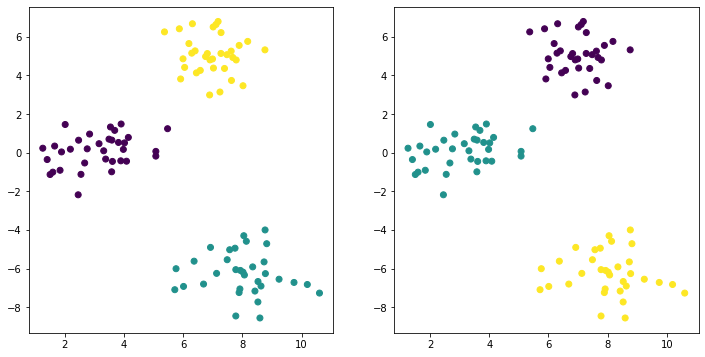

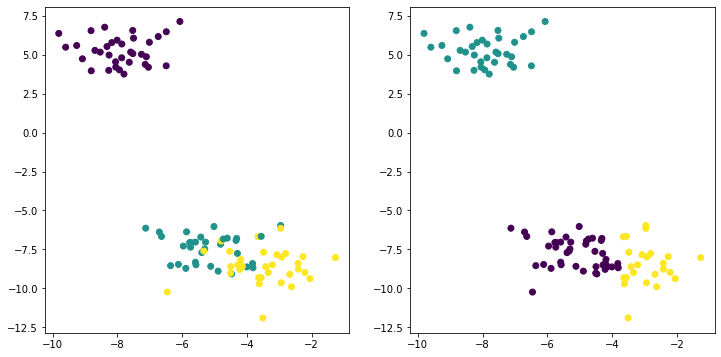

In [ ]:
for i in range(20):
  X, y = make_blobs(n_samples=100, centers=3, n_features=2, random_state=i)
  adj_mat = build_complete_graph(X)
  clusters = complete_linkage(adj_mat, k=3)
  fig, ax = plt.subplots(1, 2, figsize=(12, 6))
  ax[0].scatter(X[:, 0], X[:, 1], c=y)
  ax[1].scatter(X[:, 0], X[:, 1], c=clusters)

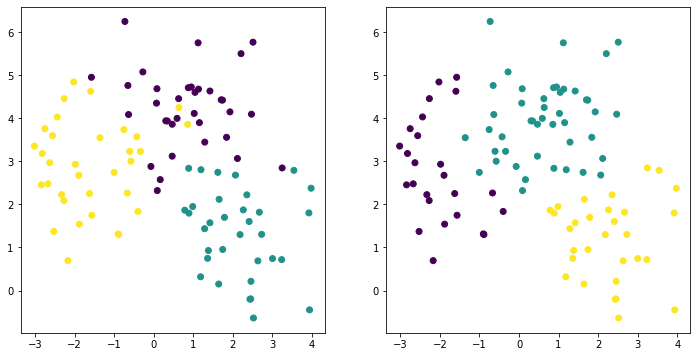

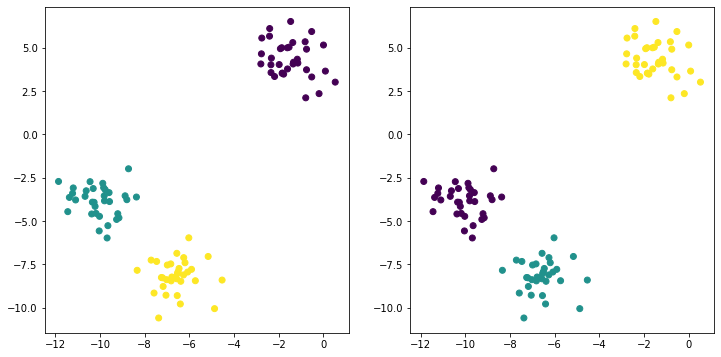

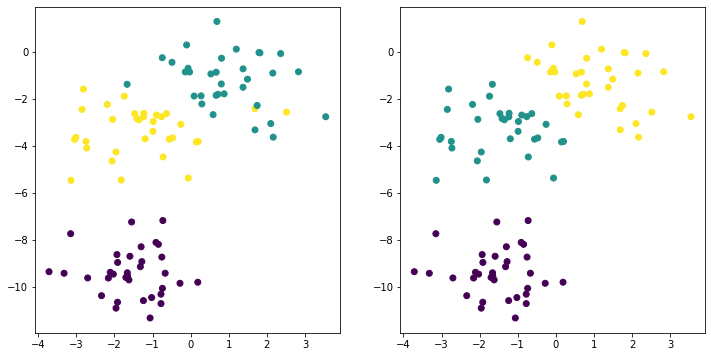

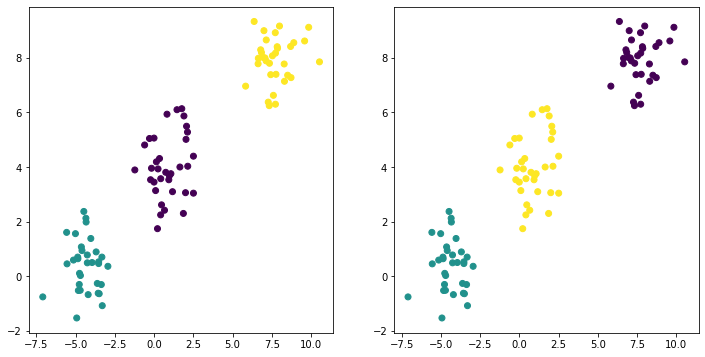

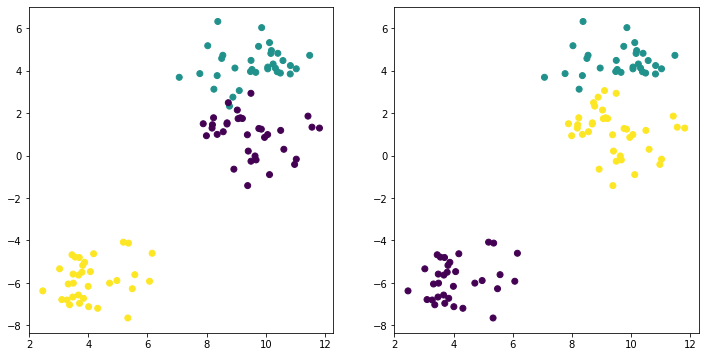

...

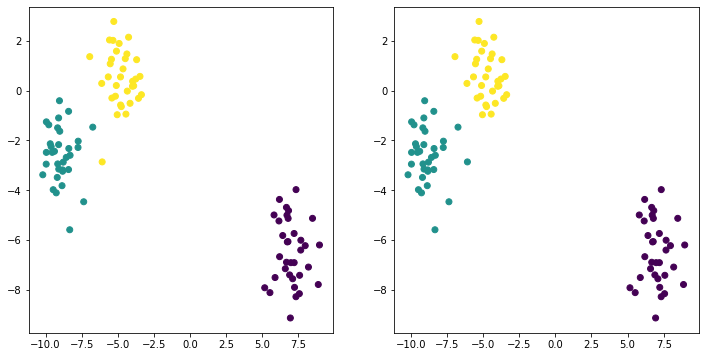

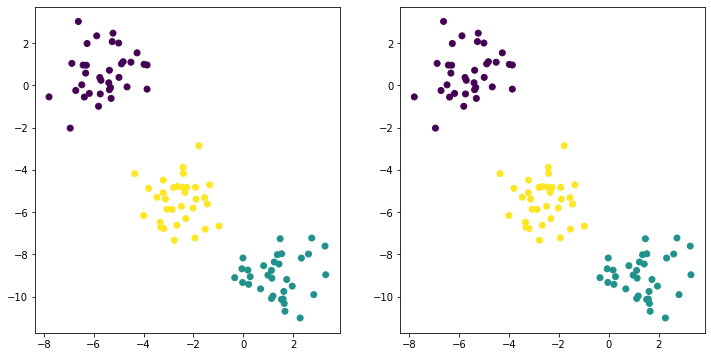

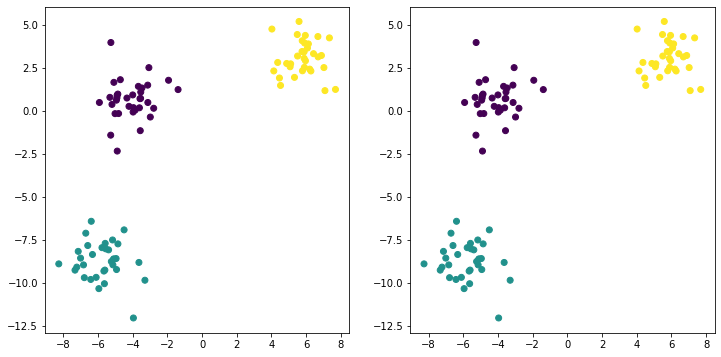

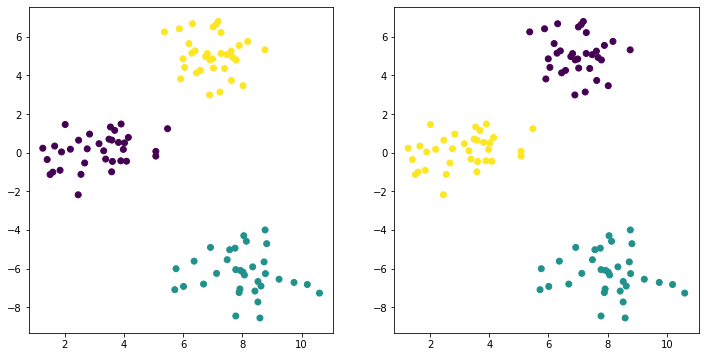

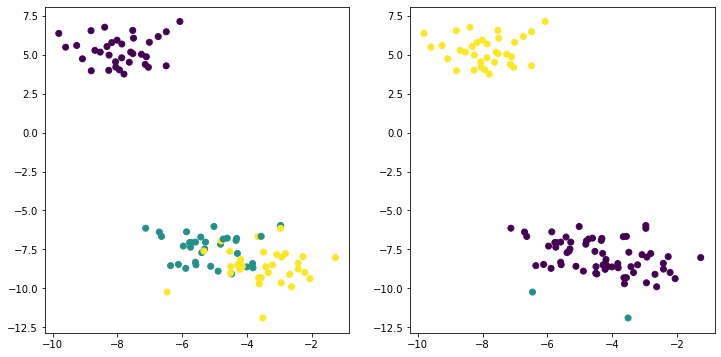

In [ ]:
for i in range(20):
  X, y = make_blobs(n_samples=100, centers=3, n_features=2, random_state=i)
  adj_mat = build_complete_graph(X)
  clusters = average_linkage(adj_mat, k=3)
  fig, ax = plt.subplots(1, 2, figsize=(12, 6))
  ax[0].scatter(X[:, 0], X[:, 1], c=y)
  ax[1].scatter(X[:, 0], X[:, 1], c=clusters)

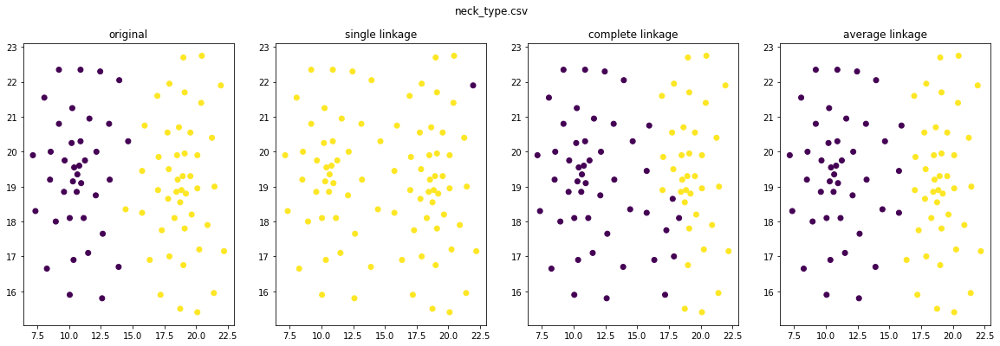

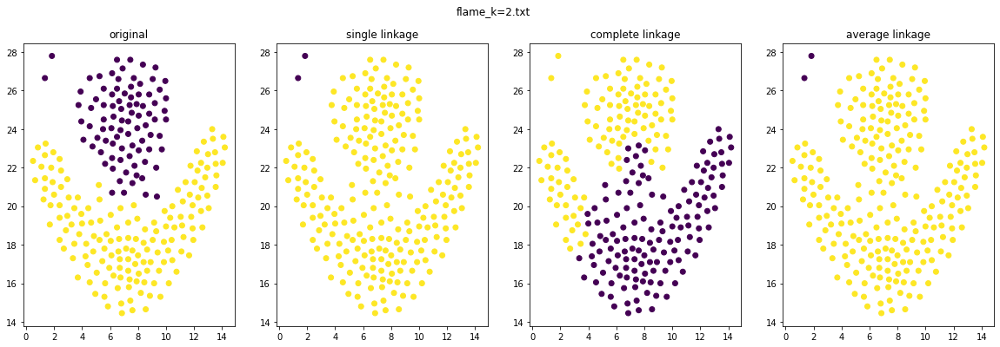

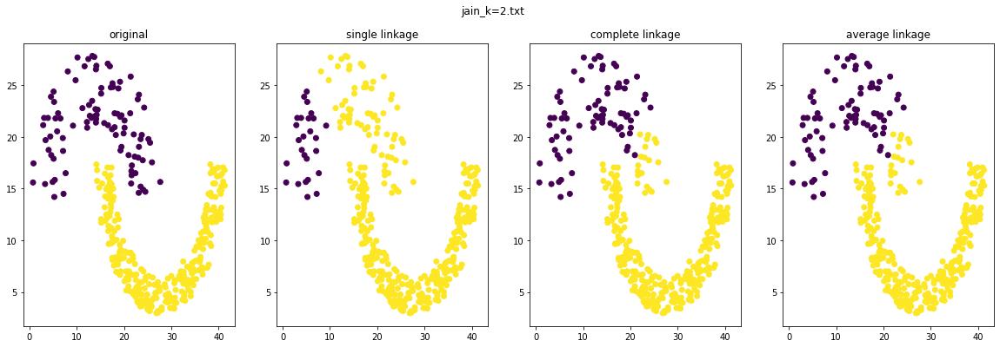

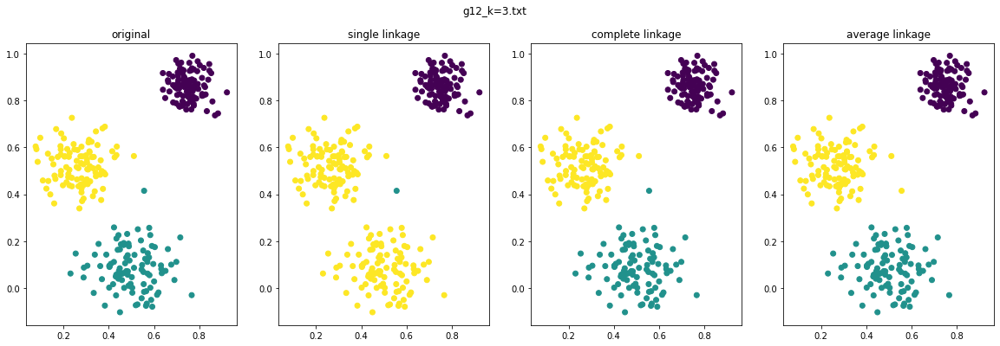

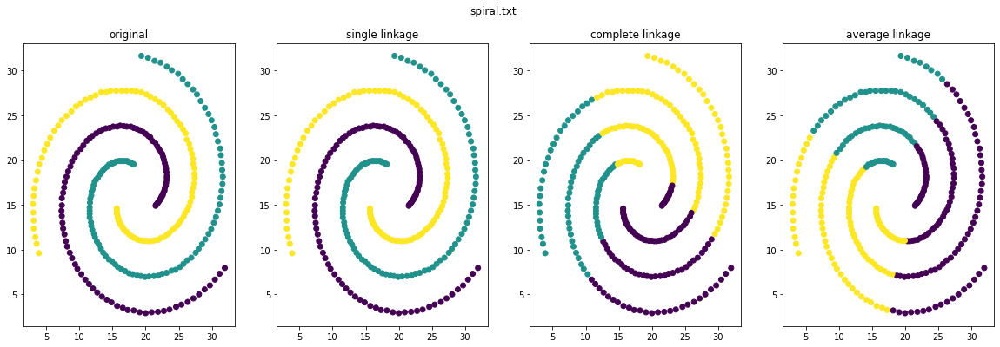

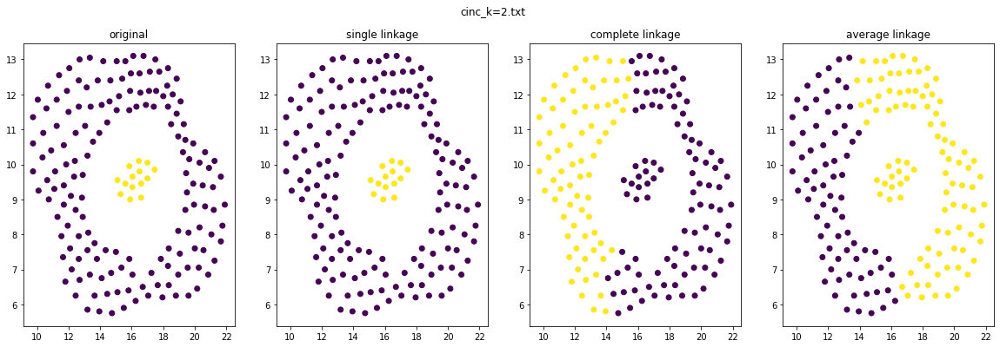

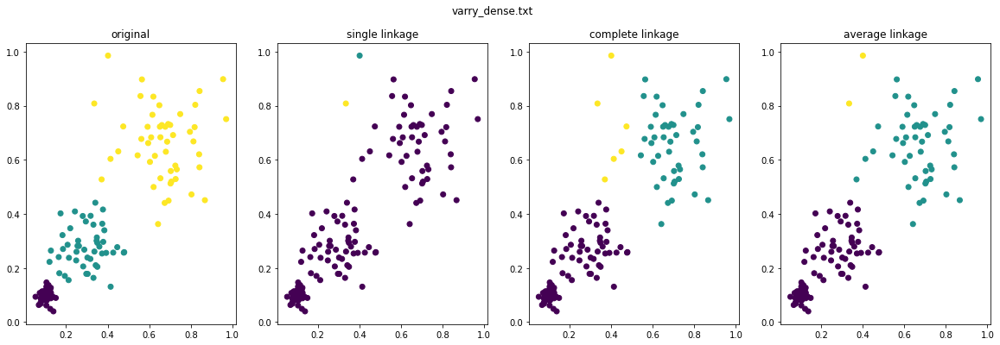

In [ ]:
path = '/content/drive/MyDrive/Data Clustering/LAB-01/Datasets/Synthetic/'
all_file_paths = glob.glob(path + '*.csv') + glob.glob(path + '*.txt')
for file_path in all_file_paths:
  dataset_name = os.path.basename(file_path)
  points, labels = read_dataset(file_path)
  if len(points) > 500:
    continue

  # print(f'{dataset_name} : {len(points)}')
  k = max(labels) + 1
  adj_mat = build_complete_graph(points)
  single_linkage_clusters = single_linkage(adj_mat, k)
  complete_linkage_clusters = complete_linkage(adj_mat, k)
  avg_linkage_clusters = average_linkage(adj_mat, k)

  fig, ax = plt.subplots(1, 4, figsize=(20, 6))
  ax[0].scatter(points[:, 0], points[:, 1], c=labels)
  ax[0].set_title('original')
  ax[1].scatter(points[:, 0], points[:, 1], c=single_linkage_clusters)
  ax[1].set_title('single linkage')
  ax[2].scatter(points[:, 0], points[:, 1], c=complete_linkage_clusters)
  ax[2].set_title('complete linkage')
  ax[3].scatter(points[:, 0], points[:, 1], c=avg_linkage_clusters)
  ax[3].set_title('average linkage')
  fig.suptitle(dataset_name)
  plt.show()

## KNN

## DBSCAN

In [ ]:
class DBSCAN:
    def __init__(self, ep, minPts):
        self.ep = ep
        self.minPts = minPts
        self.ep_pts = defaultdict(list)

    def find_dist(center, point):
        'Euclidean distance b/w two points'
        return ((center - point) ** 2).sum()

    def find_ep_points(self):
        '''For every point find points in ep neighbourhood'''
        for i in range(len(self.points)):
            for j in range(i, len(self.points)):
                if self.find_dist(self.points[i], self.points[j]) <= self.ep:
                    self.ep_pts[i].append(j)
                    if j != i:
                        self.ep_pts[j].append(i)

    def find_ep_cnt(self):
        '''
        returns a np.array containing count of points in ep neighbourhood of every point
        '''
        n = len(self.points)
        self.ep_cnt = np.array([0] * n)
        for i in range(n):
            for j in range(n):
                dist = self.find_dist(self.points[i], self.points[j])
                if dist <= self.ep:
                    self.ep_cnt[i] += 1

    def mark_pts(self, curr, cluster_no):
        # if not a core point
        if self.ep_cnt[next] < self.minPts:
            return
    
        self.cluster[curr] = cluster_no
        for next in self.ep_pts[curr]:
            # if next is core point ans is in ep neighbourhood  and is not labelled
            if self.ep_cnt[next] >= self.minPts and self.cluster[next] == 0:
                self.mark_pts(curr=next, cluster_no=cluster_no)

    def apply(self, points) -> np.array:
        '''Assign cluster label to points'''
        self.points = points

        self.find_ep_cnt()
        # # Find core points
        # core_pts = []
        # for i in range(len(self.points)):
        #     if len(self.ep_pts[i]) >= self.minPts:
        #         core_pts.append(i)
        # self.core_pts = np.array(core_pts)

        cluster_no = 0
        self.cluster = np.array([0] * len(points))

        for i in range(len(self.points)):
            # if point is core point and unlabelled
            if len(self.ep_pts[i]) >= self.minPts and self.cluster[i] == 0:
                cluter_no += 1
                self.mark_pts(i, cluster_no)

        # label border points
        cluster_no += 1
        for i in range(len(self.points)):
            # if point unlabelled
            if len(self.ep_pts[i]) > 0 and self.cluster[i] == 0:
                border_pt = 0
                for neighbour in self.ep_pts[i]:
                    # if current point is neighbour of core point then it's a border point
                    if len(self.ep_pts[neighbour]) >= self.minPts:
                        border_pt = 1
                        break
                
                if border_pt:
                    self.cluster[i] = cluster_no

        return self.cluster
            


In [ ]:
dbscan = DBSCAN(ep=1, minPts=4)
path = '/content/drive/MyDrive/Data Clustering/LAB-01/Datasets/Synthetic/'
all_file_paths = glob.glob(path + '*.csv') + glob.glob(path + '*.txt')

for file_path in all_file_paths:
  points, labels = read_dataset(file_path)
  if len(points) > 500:
    continue
    
  dataset_name = os.path.basename(file_path)
  clusters = dbscan.apply(points)

  fig, ax = plt.subplots(1, 2, figsize=(20, 8))
  ax[0].scatter(points[:,  0], points[:, 1], c=labels)
  ax[0].set_title('original labels')

  ax[1].set_title('DBSCAN labels')
  ax[1].scatter(points[:,  0], points[:, 1], c=clusters)

  plt.show()



## KNN

In [ ]:
import heapq

class KNN:
  '''
  Assumption : Similar points can found near one another
  '''
  def __init__(self, k):
    self.k = k
    self.knn = defaultdict(list)
  
  def find_dist(center, point):
    'Euclidean distance b/w two points'
    return ((center - point) ** 2).sum()
  
  def find_knn(self):
    for i in range(len(self.points)):
      neighbours = []
      for j in range(len(self.points)):
        if i == j:
          continue
        
        dist = self.find_dist(self.points[i], self.points[j])
        heapq.heappush(neighbours, -1 * dist)
        if len(neighbours > self.k):
          heapq.heappop(neighbours)
      
      self.knn[i] = neighbours
 
  
  def apply(self, points):
    self.points = points

    # find k nearest neighbours for every point
    self.find_knn()


#rough

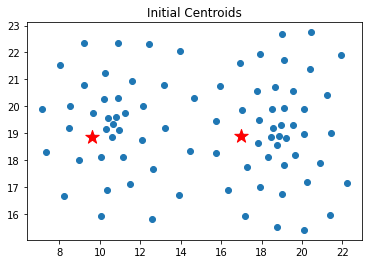

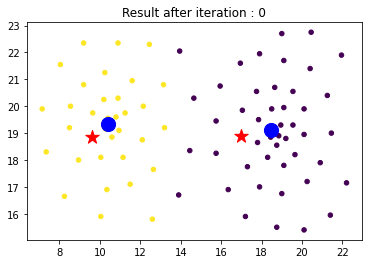

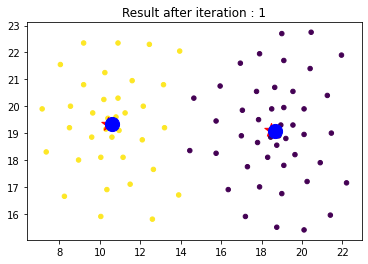

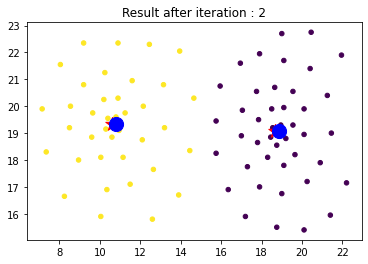

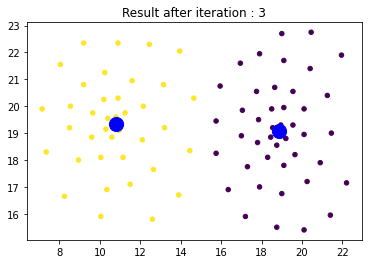

...

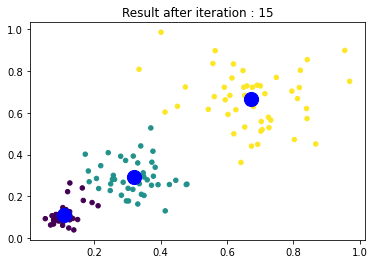

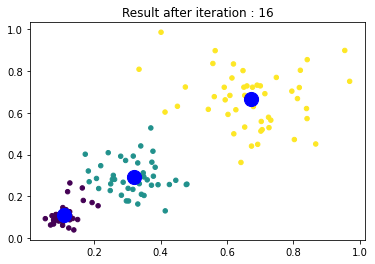

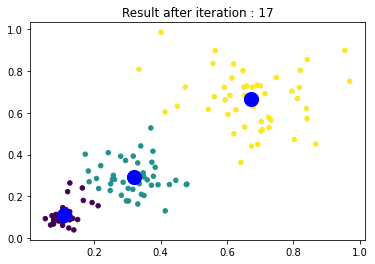

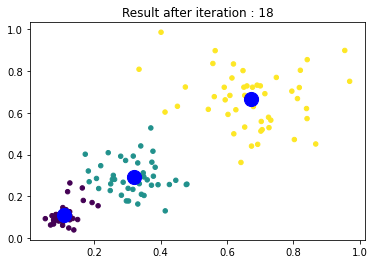

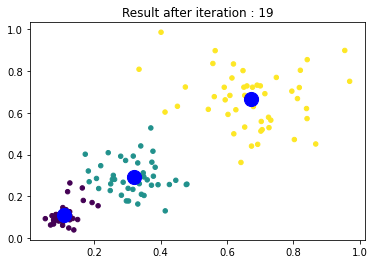

In [ ]:
path = '/content/drive/MyDrive/Data Clustering/LAB-01/Datasets/Synthetic/'
all_file_paths = glob.glob(path + '*.csv') + glob.glob(path + '*.txt')
for file_path in all_file_paths:
  dataset_name = os.path.basename(file_path)
  points, labels = read_dataset(file_path)
  k = max(labels) + 1
  centroids, clusters = k_means(k, points, plotData=True)

# Midsem Lab Exam

In [ ]:
def divide_dataset(points):
  n = len(points)
  root_n = int(math.sqrt(n))
  _, clusters = k_means(k=root_n, points=points)

  return clusters

In [ ]:
def find_sse(X, labels):
  sse = 0
  for label in set(labels):
    cluster = X[labels == label, :]
    centroid = np.mean(cluster, axis = 0)
    sse += np.sum((cluster - centroid) ** 2)
  
  return sse

def bic_score(X, labels):
  n_points = len(labels)
  n_clusters = len(set(labels))
  n_dimensions = X.shape[1]

  n_parameters = (n_clusters - 1) + (n_dimensions * n_clusters) + 1

  loglikelihood = 0
  for label_name in set(labels):
    X_cluster = X[labels == label_name]
    n_points_cluster = len(X_cluster)
    centroid = np.mean(X_cluster, axis=0)
    variance = np.sum((X_cluster - centroid) ** 2) / (len(X_cluster) - 1)
    loglikelihood += \
      n_points_cluster * np.log(n_points_cluster) \
      - n_points_cluster * np.log(n_points) \
      - n_points_cluster * n_dimensions / 2 * np.log(2 * math.pi * variance) \
      - (n_points_cluster - 1) / 2
    
  bic = loglikelihood - (n_parameters / 2) * np.log(n_points)
        
  return bic

def calinski_harabasz_score(X, labels):  
  if len(set(labels)) == 1:
    # return float("NaN")
    return 0
  else:
    return sklearn_metrics.calinski_harabasz_score(X, labels)

In [ ]:
def get_score(X, max_k=40, metric="sse"):
  '''run k-means for max_k and choose best depending up score metric used'''
  max_k = min(max_k, len(X))
  scores, x = [], []
  for k in range(1, max_k + 1):
    x.append(k)
    labels = kmeans_labels(X, k)
    if metric == "bic":
      scores.append(bic_score(X, labels))
    elif metric == "chs":
      scores.append(calinski_harabasz_score(X, labels))
    else:
      scores.append(find_sse(X, labels))

  return np.array(scores)

In [ ]:
def single_linkage(points, curr_clusters, true_labels, adj_mat, metric='chs', k=1):
  root_n = int(math.sqrt(len(points))) + 1
  clusters = []
  for i in range(len(points)):
    cluster = []
    for cluster_no in range(root_n):
      if curr_clusters[i] == cluster_no:
        cluster.append(i)
    clusters.append(cluster)
  
  
  # clusters = np.array(clusters)
  score = defaultdict()
  while len(clusters) > 1:
    # find two clusters such that min distance b/w these 2 clusters is min
    chosen1, chosen2 = 0, 1
    min_dist = sys.maxsize
    for i in range(len(clusters)):
      for j in range(i + 1, len(clusters)):
        curr_min_dist = sys.maxsize
        for p in clusters[i]:
          for q in clusters[j]:
            curr_min_dist = min(curr_min_dist, adj_mat[p][q])
        
        if curr_min_dist < min_dist:
          min_dist = curr_min_dist
          chosen1, chosen2 = i, j
    
    # merge the chosen clusters
    # add the smaller cluster to larger cluster
    if len(clusters[chosen1]) < len(clusters[chosen2]):
      temp = chosen1
      chosen1 = chosen2
      chosen2 = temp
    
    for index in clusters[chosen2]:
      clusters[chosen1].append(index)
    new_clusters = []

    for index in range(len(clusters)):
      if index == chosen2:
        continue
      new_clusters.append(clusters[index])
        
    clusters = new_clusters

    labels = np.array([0] * len(points))
    for i, cluster in enumerate(clusters):
      for index in cluster:
        labels[index] = i

    if metric == 'chs':
      score[len(clusters)] = calinski_harabasz_score(points, labels)
    elif metric == 'bic':
      score[len(clusters)] = bic_score(points, labels)
    elif metric == 'sse':
      score[len(clusters)] = find_sse(points, labels)
    elif metric == 'SI':
      score[len(clusters)] = SI(points, labels)
    elif metric == 'ARI':
      score[len(clusters)] = ARI(true_labels, labels)
  
  labels = np.array([0] * n)
  for i in range(len(clusters)):
    for p in clusters[i]:
      labels[p] = i
  
  return labels, score

In [ ]:
def find_distance(a, b, measure="euclidean"):
  return ((a - b) ** 2).sum()

def build_complete_graph(points):
  n, m = points.shape
  # adj_mat = [[0] * n] * n
  adj_mat = np.array([[0] * n] * n, np.double)
  for i in range(n):
    for j in range(i + 1, n):
      if i == j:
        adj_mat[i][j] = math.inf
        continue
      adj_mat[i][j] = adj_mat[j][i] = find_distance(a = points[i], b = points[j])
  
  return adj_mat

In [ ]:
path = '/content/drive/MyDrive/midsemdataset/'
all_file_paths = glob.glob(path + '*.csv') + glob.glob(path + '*.txt')

for file_path in all_file_paths:
  points, labels = read_dataset(file_path=file_path)
  adj_mat = build_complete_graph(points)
  original_k = max(labels) + 1
  dataset_name = os.path.basename(file_path)
  n, m = points.shape
  plot_data = True
  if m > 3:
    plot_data = False
  
  # divide the dataset in to root(n) clusters
  clusters = divide_dataset(points)
  clusters = np.ndarray.tolist(clusters)

  if plot_data:
    fig, ax = plt.subplots(1, 2, figsize=(12, 6))
    ax[0].scatter(points[:, 0], points[:, 1], c=labels)
    ax[0].set_title('Original Labels')

    ax[1].scatter(points[:, 0], points[:, 1], c=clusters)
    ax[1].set_title('root n labels')
    fig.suptitle(dataset_name)
  
  # Find best k using agglomerative clustering
  root_n = int(math.sqrt(len(points)))
  curr_k = root_n
  metrices = ['chs', 'bic', 'sse']
  scores = dict()
  x = np.array([i for i in range(2, root_n + 1)])

  for metric in metrices:
    _, scores[metric] = single_linkage(k=1, points=points, curr_clusters=clusters, adj_mat=adj_mat, true_labels = labels, metric=metric)
    print(len(scores[metric]))

  fig, ax = plt.subplots(1, 4, figsize=(12, 4))
  best_k = dict()
  print(f'Total points : {len(points)}')
  for i in range(len(metrices)):
    ax[i].plot(x, scores[metrices[i]])
    ax[i].set_xlabel('K')
    ax[i].set_ylabel(metrices[i] + " score")
    if metrices[i] == "sse":
      # find elbow
      best_k[metrices[i]] = KneeLocator(x, scores[metrices[i]], curve="convex", direction="decreasing").knee
    else :
      best_k[metrices[i]] = np.argmax(scores[metrices[i]]) + 1
    
    ax[i].title.set_text(metrices[i] + " found k = " + str(best_k[metrices[i]]))

    
  ax[3].scatter(X[:, 0], X[:, 1], c=labels)
  ax[3].title.set_text(dataset_name + " dataset")
  fig.suptitle("Comparision b/w sse, bic, chs")
  plt.show()


  # suppose we choose k caculated using chs
  chosen_k = best_k['chs']

  # Now merge the clusters using agglomerative methods
  # I have used single linkage
  pred_labels, _ = single_linkage(points=points, curr_clusters=clusters, adj_mat = adj_mat, true_labels=labels, k=chosen_k)
  if plot_data:
    fig, ax = plt.subplots(1, 2, figsize=(12, 6))
    ax[0].scatter(points[:, 0], points[:, 1], c=labels)
    ax[0].set_title('Original Labels')

    ax[1].scatter(points[:, 0], points[:, 1], c=pred_labels)
    ax[1].set_title('Predicted Labels')
    fig.suptitle(dataset_name)
  
  k_means_labels = k_means(k=chosen_k, points=points)

  # Compare results of k_means and current algo
  print(f'ARI using k-means{ARI(labels, k_means_labels)}')
  print(f'ARI using current methods : {ARI(labels, pred_labels)}')

In [ ]:
class Hierarchical:
  def __init__(self):
    pass
  
  def single_linkage(k = 1, points, curr_labels, adj_matf)

In [ ]:
class MidSem:
  def __init__(self, points, plot_data=False, criteria = 'single'):
    self.points = points
    self.root_n = math.sqrt(len(points)) + 1
    self.adj_mat = self.build_complete_grapth()
    self.metrices = ['chs', 'bic', 'sse']
    self.metric_func = {'chs'}
    self.plot_data = plot_data
    self.merging_criteria = criteria

  
  def euclidean_dist(a, b):
    return ((a - b) ** 2).sum()
  
  def find_sse(self, labels):
    sse = 0
    for label in set(labels):
      cluster = self.points[labels == label, :]
      centroid = np.mean(cluster, axis = 0)
      sse += np.sum((cluster - centroid) ** 2)
    
    return sse

  def bic_score(self, labels):
    n_points = len(labels)
    n_clusters = len(set(labels))
    n_dimensions = self.points.shape[1]

    n_parameters = (n_clusters - 1) + (n_dimensions * n_clusters) + 1

    loglikelihood = 0
    for label_name in set(labels):
      X_cluster = self.points[labels == label_name]
      n_points_cluster = len(X_cluster)
      centroid = np.mean(X_cluster, axis=0)
      variance = np.sum((X_cluster - centroid) ** 2) / (len(X_cluster) - 1)
      loglikelihood += \
        n_points_cluster * np.log(n_points_cluster) \
        - n_points_cluster * np.log(n_points) \
        - n_points_cluster * n_dimensions / 2 * np.log(2 * math.pi * variance) \
        - (n_points_cluster - 1) / 2
      
    bic = loglikelihood - (n_parameters / 2) * np.log(n_points)
          
    return bic

  def calinski_harabasz_score(self, labels):  
    if len(set(labels)) == 1:
      # return float("NaN")
      return 0
    else:
      return sklearn_metrics.calinski_harabasz_score(self.points, labels)
  
  def build_complete_graph(self):
    n, m = self.points.shape
    adj_mat = np.array([[0] * n] * n, np.double)
    for i in range(n):
      for j in range(i + 1, n):
        if i == j:
          adj_mat[i][j] = math.inf
          continue
        adj_mat[i][j] = adj_mat[j][i] = self.euclidean_dist(a = points[i], b = points[j])
    
    return adj_mat
  
  def roon_subsets(self):
    _, clusters = k_means(k=self.root_n, points=self.points)
    return clusters
  
  def calc_score(self, labels, metric='chs'):
    return metric_mapping
  
  def merge(self, clusters, k = 1):
    scores = defaultdict(list)
    while len(clusters) > k:
      # find two nearest clusters
      # dist b/w two cluster is min dist b/w pts of these clusters
      chosen1, chosen2 = 0, 1
      min_dist = sys.maxsize
      for i in range(len(clusters)):
        curr_min_dist = sys.maxsize
        min_dist_index = i
        for j in range(i + 1, len(clusters)):
          dist = self.euclidean(a=points[i], b=points[j])
          if curr_min_dist > dist:
            curr_min_dist = dist
            min_dist_index = j
        
        if curr_min_dist < min_dist:
          min_dist = curr_min_dist
          chosen1, chosen2 = i, min_dist_index
      
      # now merge the chosen1 & chosen2 clusters into one single cluster
      if chosen1 > chosen2:
        swap(chosen)
      for pt_index in clusters[chosen2]:
        clusters[chosen].append(pt_index)
      clusters = [cluster for index, cluster in enumerate(clusters) if index != chosen2]
      labels = np.array([0] * len(self.points))
      for cluster_no in range(len(clusters)):
        for pt_indices in clusters[cluster_no]:
            labels[pt_indices] = cluster_no
      
      for metric in self.metrices:
        scores[metric][len(clusters)] = self.metric_mapping_func[metric]
    
    labels = np.array([0] * len(self.points))
    for cluster_no in range(len(clusters)):
      for pt_indices in clusters[cluster_no]:
          labels[pt_indices] = cluster_no

    return labels, scores

  def find_best_k(self):
    clusters = self.rootn_subsets()
    pts_in_cluster = []
    for cluster_no in range(self.root_n):
      cluster_pts = []
      for i, label in enumerate(clusters):
        if label == cluster_no:
          cluster_pts.append(i)
      pts_in_cluster[cluster_no] = cluster_pts
    
    # merge root(n) subsets to find best k
    clusters, scores = self.merge(clusters = pts_in_cluster)

    best_k = dict()
    for i in range(len(metrices)):
      ax[i].plot(x, scores[metrices[i]])
      ax[i].set_xlabel('K')
      ax[i].set_ylabel(metrices[i] + " score")
      if metrices[i] == "sse":
        # find elbow
        best_k[metrices[i]] = KneeLocator(x, scores[metrices[i]], curve="convex", direction="decreasing").knee
      else :
        best_k[metrices[i]] = np.argmax(scores[metrices[i]]) + 1
      
      ax[i].title.set_text(metrices[i] + " found k = " + str(best_k[metrices[i]]))

      
    ax[3].scatter(X[:, 0], X[:, 1], c=labels)
    ax[3].title.set_text(dataset_name + " dataset")
    fig.suptitle("Comparision b/w sse, bic, chs")
    plt.show()


    # suppose we choose k caculated using chs
    chosen_k = best_k['chs']

    return chosen_k

  def apply(self):
    self.rootn_clusters = self.divide_into_rootn_clusters()
    # merge these root(n) clusters using agglomerative clustering to find best k
    self.best_k = self.find_k()

    # merge root(n) clusters into best_k clusters using agglomerative clustering
    pts_in_cluster = []
    for cluster_no in range(self.root_n):
      cluster_pts = []
      for i, label in enumerate(clusters):
        if label == cluster_no:
          cluster_pts.append(i)
      pts_in_cluster[cluster_no] = cluster_pts
    clusters, _ = self.merge(clusters=pts_in_cluster, k=self.best_k)

    return clusters
    

In [ ]:
path = '/content/drive/MyDrive/midsemdataset/'
all_file_paths = glob.glob(path + '*.csv') + glob.glob(path + '*.txt')

df_table = defaultdict(defaultdict)

for file_path in all_file_paths:
  points, labels = read_dataset(file_path=file_path)
  dataset_name = os.path.basename(file_path)
  
  midsem_algo = Midsem(points = points)
  clusters = midsem_algo.apply()
  best_k = midsem_algo.best_k

  k_means_labels = k_means(k=chosen_k, points=points)

  # Compare results of k_means and current algo
  df_table[dataset_name]['KMeans ARI'] = ARI(labels, k_means_labels)
  df_table[dataset_name]['Midsem ARI'] = ARI(labels, pred_labels)
  print(f'ARI using k-means{ARI(labels, k_means_labels)}')
  print(f'ARI using current methods : {ARI(labels, pred_labels)}')

df = pd.DataFrame(df_table)
print(df)

# Assignment 7

In [ ]:
def find_distance(a, b):
  return ((a - b) ** 2).sum()

In [ ]:
def KNN(k, points):
  edges = []
  for i in range(len(points)):
    neighbours = []
    for j in range(0, len(points)):
      if i == j:
        continue

      neighbours.append([find_dist(points[i], points[j]), j])

    neighbours.sort()
    for index in range(k):
      edges.append([i, neighbours[index][1]])

  return edges

In [ ]:
def get_knn_edges(k, path):
  all_file_paths = glob.glob(path + '*.csv') + glob.glob(path + '*.txt')
  knn_edges = defaultdict()

  for file_path in all_file_paths:
    points, labels = read_dataset(file_path=file_path)
    dataset_name = os.path.basename(file_path)
    edges = KNN(k, points)

    fig, ax = plt.subplots(1, 2, figsize=(20, 8))
    ax[0].scatter(points[:,  0], points[:, 1], c=labels)
    ax[0].set_title('original dataset')

    ax[1].set_title('KNN graph of dataset')
    ax[1].scatter(points[:,  0], points[:, 1])
    for edge in edges:
      u, v = edge
      ax[1].plot([points[u][0], points[v][0]], [points[u][1], points[v][1]], color='gray')
    
    plt.suptitle(dataset_name)
    plt.show()

    knn_edges[dataset_name] = edges
    # print(knn_edges[dataset_name])
  return knn_edges

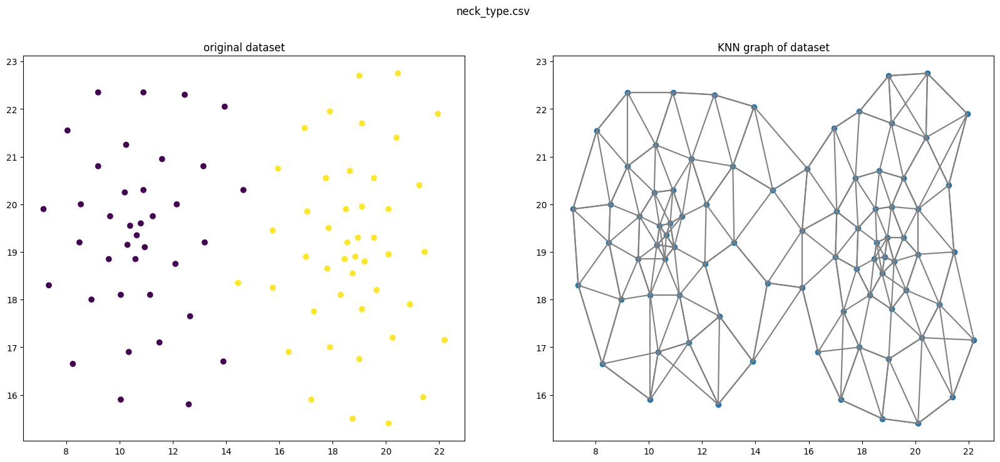

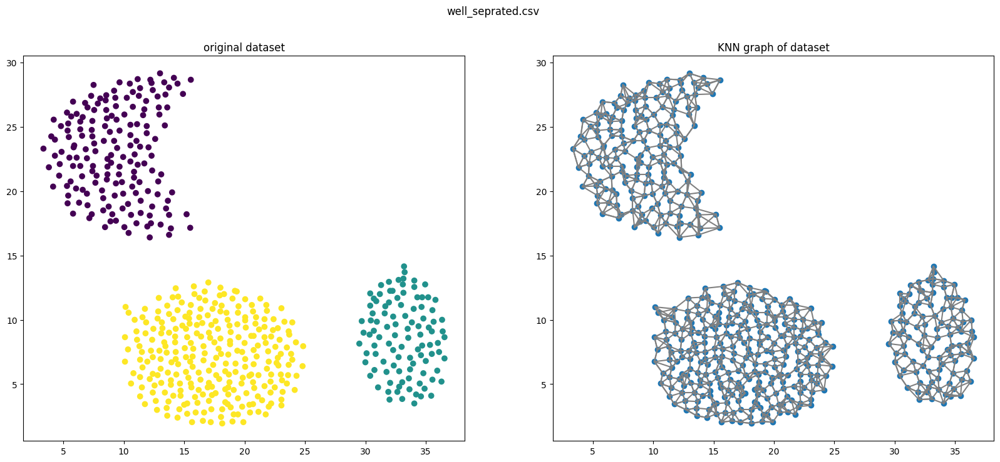

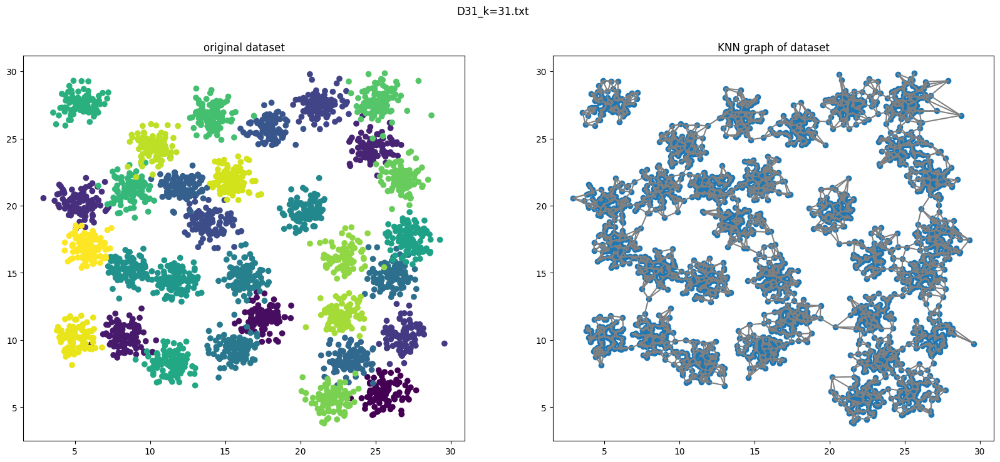

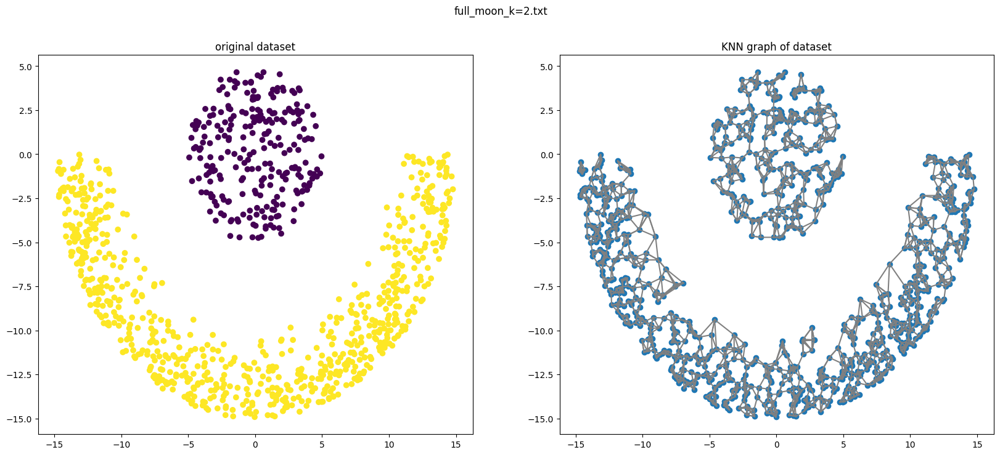

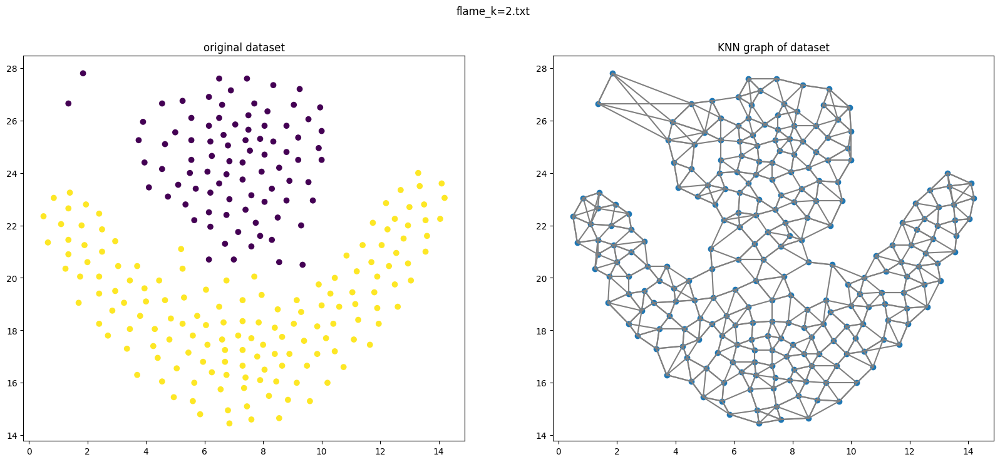

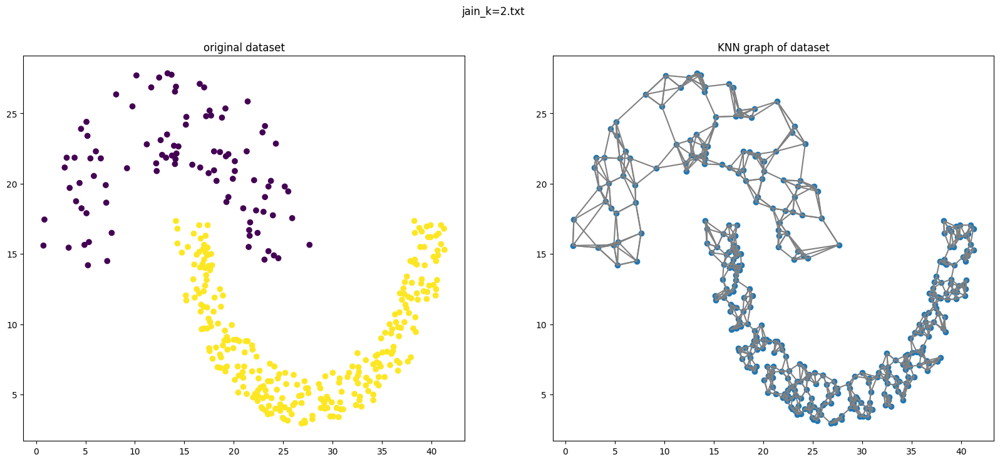

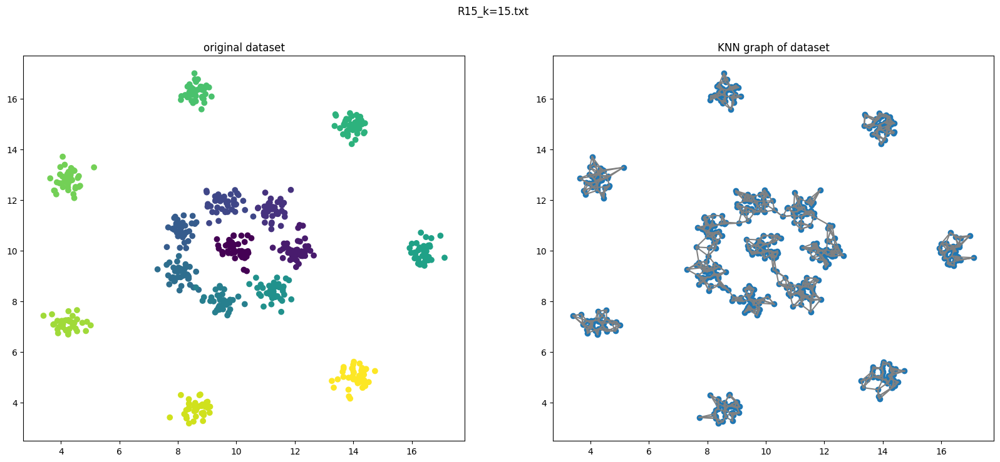

In [ ]:
# 13m 37s
# completed at 16:04
path = '/content/drive/MyDrive/Data Clustering/LAB-01/Datasets/Synthetic/'
all_file_paths = glob.glob(path + '*.csv') + glob.glob(path + '*.txt')
knn_edges = defaultdict()

for file_path in all_file_paths:
  points, labels = read_dataset(file_path=file_path)
  dataset_name = os.path.basename(file_path)
  k = 4
  edges = KNN(k, points)

  fig, ax = plt.subplots(1, 2, figsize=(20, 8))
  ax[0].scatter(points[:,  0], points[:, 1], c=labels)
  ax[0].set_title('original dataset')

  ax[1].set_title('KNN graph of dataset')
  ax[1].scatter(points[:,  0], points[:, 1])
  for edge in edges:
    u, v = edge
    ax[1].plot([points[u][0], points[v][0]], [points[u][1], points[v][1]], color='gray')
  
  plt.suptitle(dataset_name)
  plt.show()

  knn_edges[dataset_name] = edges
  # print(knn_edges[dataset_name])

In [ ]:
def find_dist(a, b):
  return ((a - b) ** 2).sum()

In [ ]:
def prims(adj_mat):
  '''
      1. for every not yet selected vertex we will store the minimum edge to an already selected vertex.
      2. Then during a step we only have to look at these minimum weight edges.
  '''
  
  n = len(adj_mat)
  min_e = np.array([[sys.maxsize, -1]] * n, np.double) # stores the minimum weight edge to an already selected vertex
  selected = np.array([False] * n)
  mst = []
  min_e[0][0] = 0
  for i in range(n):
    u = -1
    for j in range(n):
      if (selected[j] == False) and (u == -1 or min_e[j][0] < min_e[u][0]):
        u = j
    
    if min_e[u][0] == math.inf:
      print("No MST")
      return []
    
    selected[u] = True
    if min_e[u][1] != -1:
      mst.append([u, min_e[u][1]])
    
    for v in range(n):
      if adj_mat[u][v] < min_e[v][0]:
        min_e[v][0] = adj_mat[u][v]
        min_e[v][1] = u

  return np.array(mst, dtype=int)

In [ ]:
def dfs(curr, comp, visited, adj):
  visited[curr] = True
  comp.append(curr)
  for next in adj[curr]:
    if not visited[next]:
      dfs(next, comp, visited, adj)

In [ ]:
def connected_components(n, edges):
  # adj = [[]] * n
  adj = defaultdict(list)
  for edge in edges:
    adj[edge[0]].append(edge[1])
    adj[edge[1]].append(edge[0])
  
  comps = [] * n
  visited = np.array([False] * n)
  for i in range(n):
    if not visited[i]:
      comp = []
      dfs(curr=i, comp=comp, visited=visited, adj=adj)
      comps.append(comp)
  
  return comps

In [ ]:
def build_complete_graph(points):
  n, m = points.shape
  # adj_mat = [[0] * n] * n
  adj_mat = np.array([[0] * n] * n, np.double)
  for i in range(n):
    for j in range(i + 1, n):
      if i == j:
        adj_mat[i][j] = math.inf
        continue
      adj_mat[i][j] = adj_mat[j][i] = find_distance(a = points[i], b = points[j])
  
  return adj_mat

In [ ]:
def find_mst(points):
  adj_mat = build_complete_graph(points)
  mst = prims(adj_mat)
  # fig, ax = plt.subplots(1, 1, figsize=(15, 5))
  # ax.scatter(points[:,  0], points[:, 1])
  # ax.set_title('Finding MST for it')
  # plt.show()
  edges = []
  for edge in mst:
    u, v = edge
    edges.append([adj_mat[u][v], points[u], points[v]])
  
  return edges

In [ ]:
def solve(k=4):
  path = '/content/drive/MyDrive/Data Clustering/LAB-01/Datasets/Synthetic/'
  all_file_paths = glob.glob(path + '*.csv') + glob.glob(path + '*.txt')

  for file_path in all_file_paths:
    points, labels = read_dataset(file_path=file_path)
    dataset_name = os.path.basename(file_path)
    n_clusters = max(labels) + 1

    print(f'Total points : {len(points)}, Clusters = {n_clusters}')
    if (len(points) > 1000):
      continue
      
    edges = KNN(k=k, points=points)
    # edges = knn_edges[dataset_name]

    fig, ax = plt.subplots(1, 3, figsize=(15, 5))
    ax[0].scatter(points[:,  0], points[:, 1], c=labels)
    ax[0].set_title('original dataset')

    ax[1].set_title('KNN graph of dataset')
    ax[1].scatter(points[:,  0], points[:, 1])
    for edge in edges:
      u, v = edge
      ax[1].plot([points[u][0], points[v][0]], [points[u][1], points[v][1]], color='gray')

    comps = connected_components(len(points), edges)
    n_comp = len(comps)

    global_mst_edges = []
    for comp in comps:
      # print(f'Component indices : {len(comp)}')
      # comp_points = points[comp]
      comp_points = []
      for index in comp:
        comp_points.append(points[index])
      comp_points = np.array(comp_points)
      mst_edges = find_mst(comp_points)
      for edge in mst_edges:
        weight, a, b = edge
        global_mst_edges.append([weight, list(a), list(b)])
    
    # (global_mst_edges.sort()).all()
    # print(global_mst_edges)
    global_mst_edges.sort()

    # remove extra edges
    remove_cnt = n_clusters - len(comps)
    # print('------------------------')
    # print(remove_cnt)
    # print('------------------------')
    while remove_cnt > 0:
      remove_cnt -= 1
      global_mst_edges.pop()
      # print('------------------------')
      # print(remove_cnt)
      # print('------------------------')
    
    ax[2].set_title('Final Clusters')
    ax[2].scatter(points[:,  0], points[:, 1])
    for edge in global_mst_edges:
      _, a, b = edge
      ax[2].plot([a[0], b[0]], [a[1], b[1]], color='gray')

    plt.suptitle(dataset_name)
    plt.show()


Total points : 83, Clusters = 2


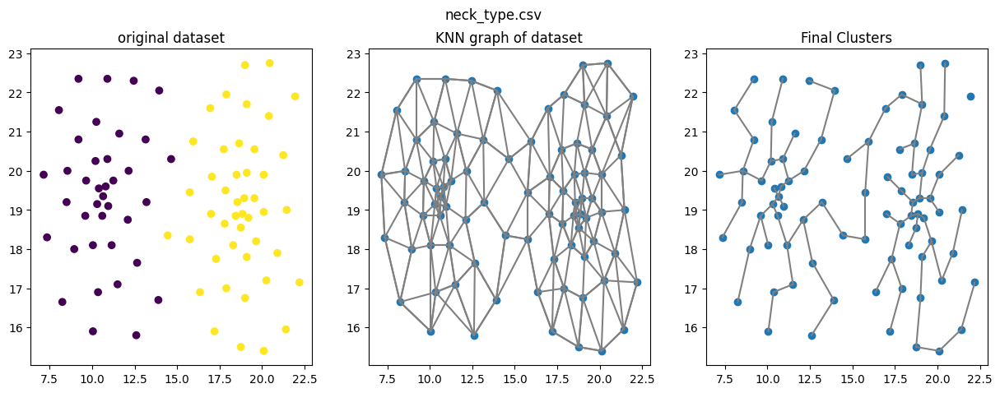

Total points : 545, Clusters = 3


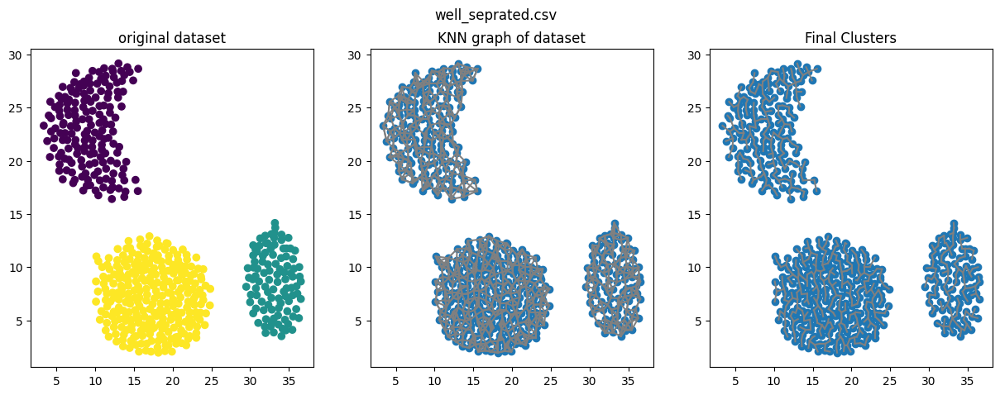

Total points : 3100, Clusters = 31
Total points : 1000, Clusters = 2


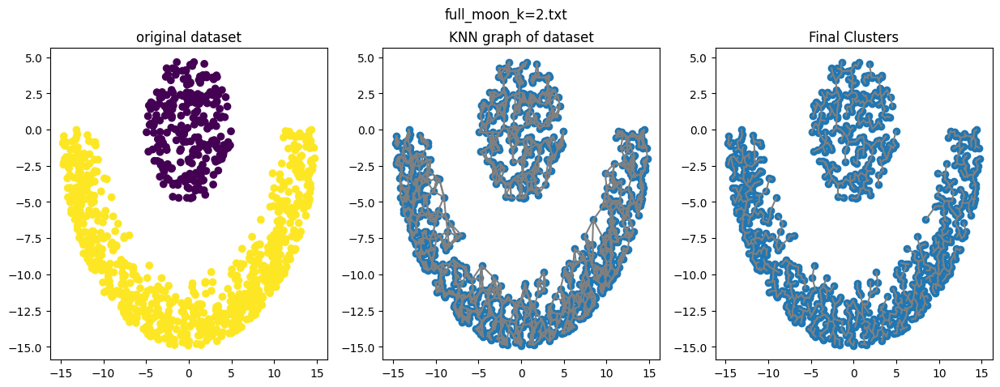

Total points : 240, Clusters = 2


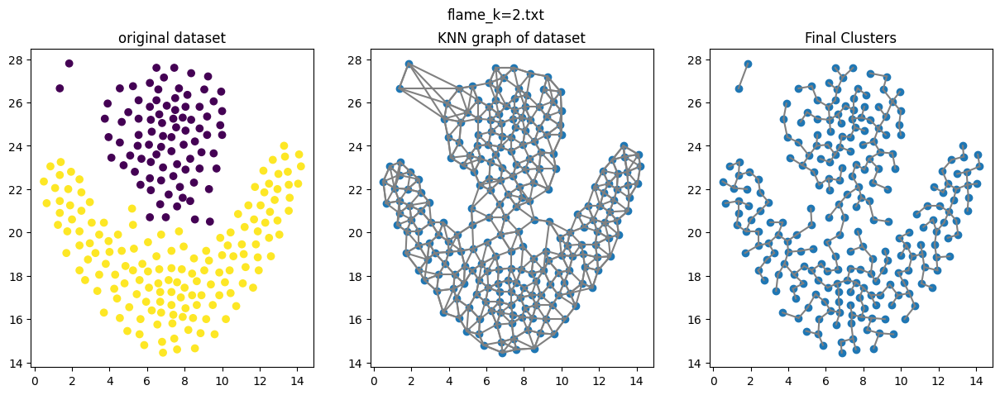

Total points : 373, Clusters = 2


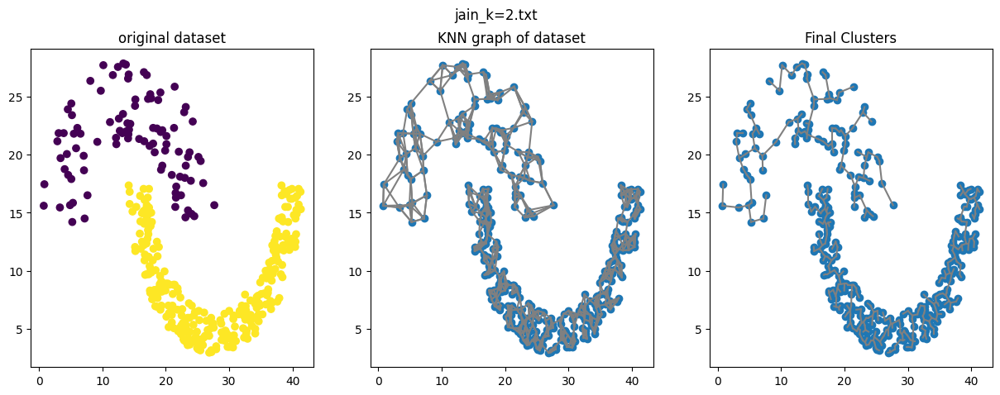

Total points : 600, Clusters = 15


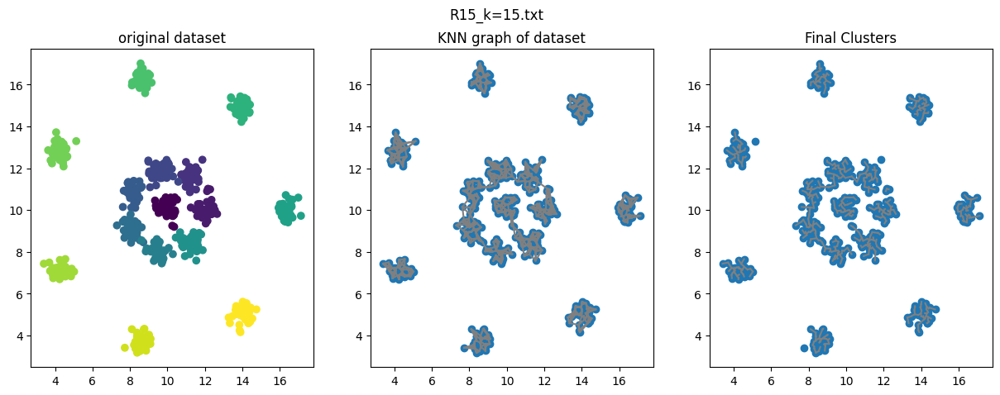

Total points : 9199, Clusters = 11
Total points : 300, Clusters = 3


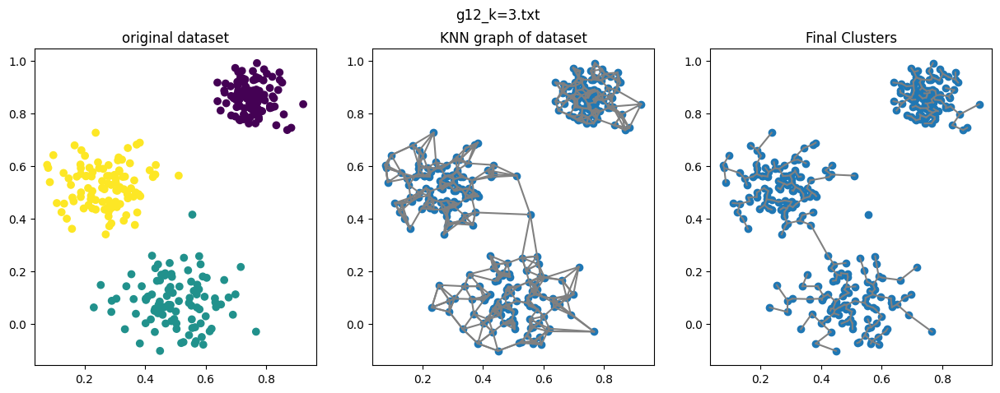

Total points : 1800, Clusters = 3
Total points : 788, Clusters = 7


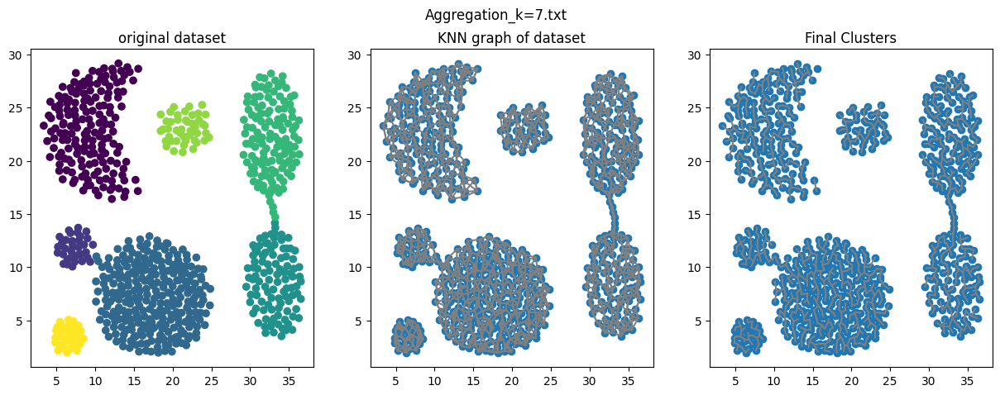

Total points : 1000, Clusters = 4


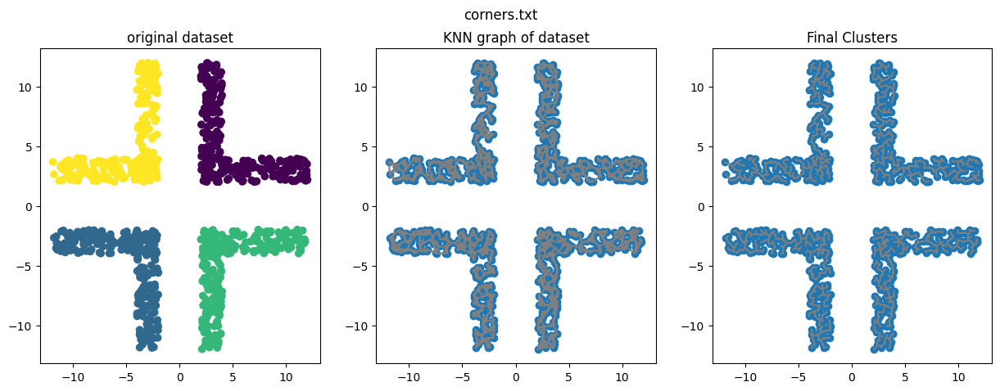

Total points : 1000, Clusters = 2


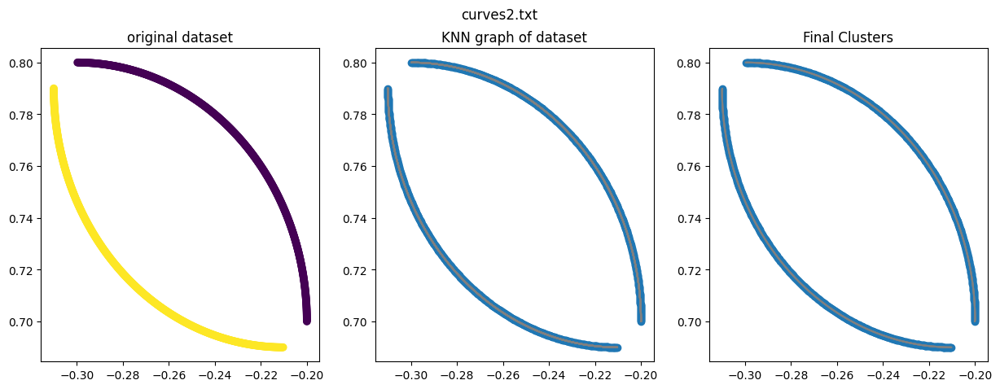

Total points : 312, Clusters = 3


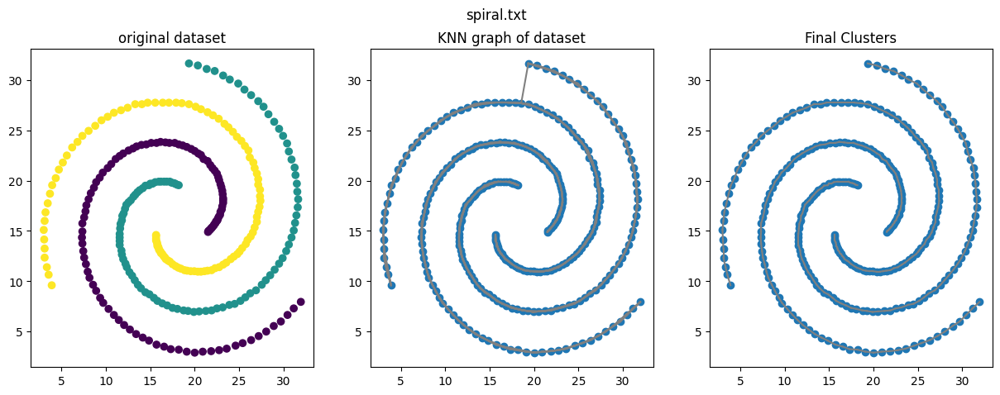

Total points : 170, Clusters = 2


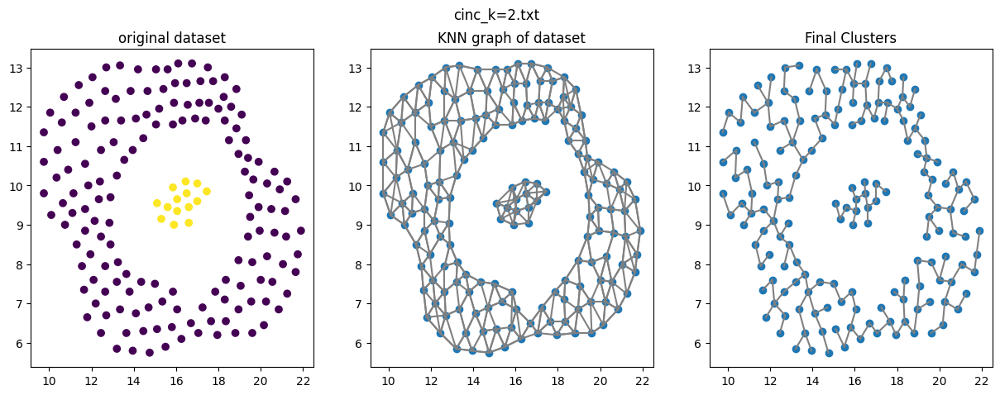

Total points : 147, Clusters = 3


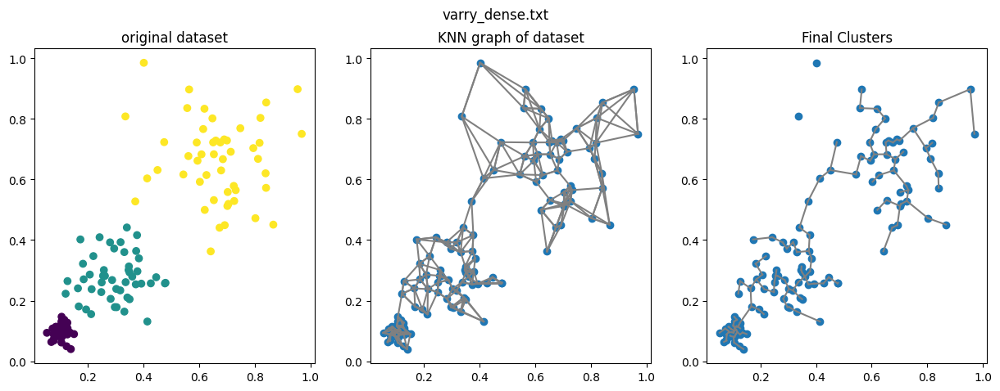

In [ ]:
solve()

# EndSem Exam

## k-mst graph 

In [ ]:
def prims(adj_mat):
  '''
      1. for every not yet selected vertex we will store the minimum edge to an already selected vertex.
      2. Then during a step we only have to look at these minimum weight edges.

      Input : adj_mat
      Output: list of mst_edges
  '''
  
  n = len(adj_mat)
  min_e = np.array([[sys.maxsize, -1]] * n, np.double) # stores the minimum weight edge to an already selected vertex
  selected = np.array([False] * n)
  mst = []
  min_e[0][0] = 0
  for i in range(n):
    u = -1
    for j in range(n):
      if (selected[j] == False) and (u == -1 or min_e[j][0] < min_e[u][0]):
        u = j
    
    if min_e[u][0] == math.inf:
      print("No MST possible. Graph is disconnected!!")
      return []
    
    selected[u] = True
    if min_e[u][1] != -1:
      mst.append([u, min_e[u][1]])
    
    for v in range(n):
      if adj_mat[u][v] < min_e[v][0]:
        min_e[v][0] = adj_mat[u][v]
        min_e[v][1] = u

  return np.array(mst, dtype=int)

1. initially we have complete graph
2. we run prims on this complete graph and get mst of graph
3. now we remove these mst edges from complete graph
4. now again run prims on updated graph and get another mst if possible
5. if we get another mst then merge it with previous mst

In [ ]:
# remove edges from given graph
def remove_edges(adj_mat, edges):
  for [i, j] in edges:
    adj_mat[i][j] = adj_mat[j][i] = math.inf
  
  return adj_mat

In [ ]:
def find_distance(a, b, measure="euclidean"):
  return ((a - b) ** 2).sum()

def build_complete_graph(points):
  '''Returns adj_mat for a given list of points'''
  n, m = points.shape
  adj_mat = np.array([[0] * n] * n, np.double)
  for i in range(n):
    for j in range(i + 1, n):
      if i == j:
        adj_mat[i][j] = math.inf
        continue
      adj_mat[i][j] = adj_mat[j][i] = find_distance(a = points[i], b = points[j])
  
  return adj_mat

In [ ]:
def get_kmst(points, k = 1):
  adj_mat = build_complete_graph(points)
  k_mst_edges = []
  for i in range(k):
    mst_edges = prims(adj_mat)
    if len(mst_edges) == 0:
      print(f'{i} MST Possible')
      break

    # merge the new mst edges to k_mst_edges
    for edge in mst_edges:
      k_mst_edges.append(edge)
    # remove the mst_edges from graph
    adj_mat = remove_edges(adj_mat, mst_edges)

  return np.array(k_mst_edges)

In [ ]:
def find_farthest_point(point, cluster, points):
  farthest_index, max_dist = cluster[0], 0
  for index in cluster:
    curr_dist = find_distance(points[index], point)
    if curr_dist > max_dist:
      curr_dist = max_dist
      farthest_index = index
  
  return farthest_index

def BiMeans(clusters, cluster, points):
  root_n = math.sqrt(len(points))
  if len(cluster) < root_n:
    clusters.append(cluster)
    return

  X = []
  for index in cluster:
    X.append(points[index])
  X = np.array(X)
  centroid = np.mean(X, axis=0)

  # find farthest point from centroid
  farthest_from_centroid = find_farthest_point(centroid, cluster, points)
  
  # find farthest from farthest point from centroid
  second_farthest_point = find_farthest_point(points[farthest_from_centroid], cluster, points)
  
  a, b = farthest_from_centroid, second_farthest_point

  cluster_a, cluster_b = [], []
  # assign points to their nearest point
  for index in cluster:
    dist1, dist2 = find_distance(points[a], points[index]), find_distance(points[b], points[index])

    if dist1 < dist2:
      cluster_a.append(index)
    else:
      cluster_b.append(index)
  
  # call BiMeans on cluster_a, cluster_b
  BiMeans(clusters, cluster_a, points)
  BiMeans(clusters, cluster_b, points)

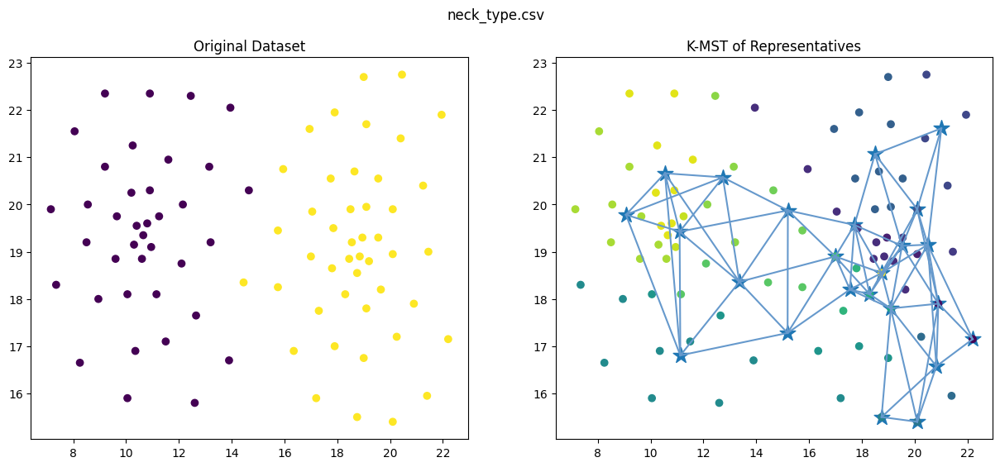

Eigen vectors shape : (24, 24)
(24, 2)


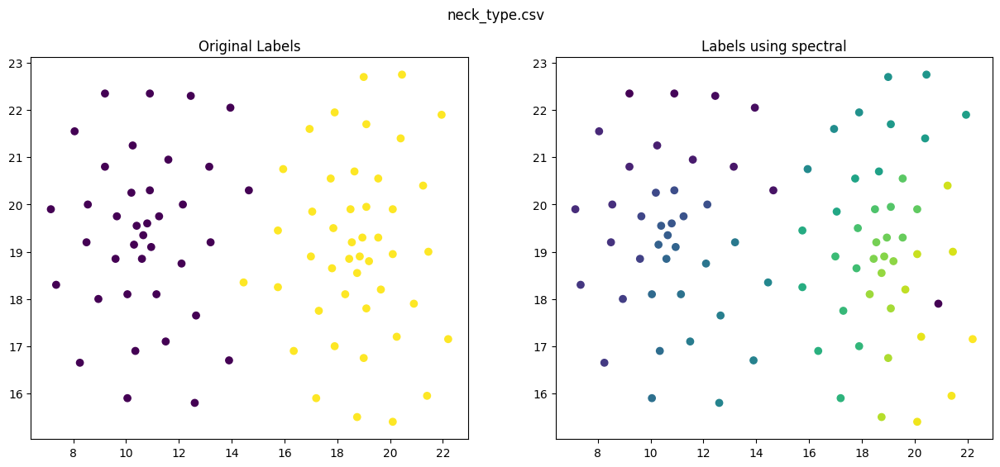

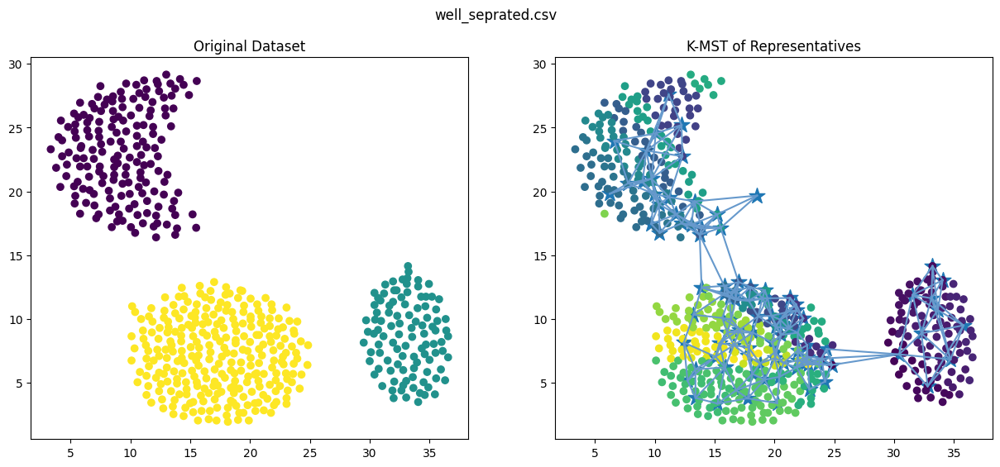

Eigen vectors shape : (99, 99)
(99, 3)


ValueError: ignored

In [ ]:
path = '/content/drive/MyDrive/Data Clustering/LAB-01/Datasets/Synthetic/'
all_file_paths = glob.glob(path + '*.csv') + glob.glob(path + '*.txt')

for file_path in all_file_paths:
  points, labels = read_dataset(file_path=file_path)
  dataset_name = os.path.basename(file_path)
  orig_k = max(labels) + 1
  if (len(points) > 1000):
    continue

  clusters = []
  init_cluster = [i for i in range(len(points))]
  BiMeans(clusters, init_cluster, points)
  bi_labels = [i for i in range(len(points))]
  for cluster_no, cluster in enumerate(clusters):
    for index in cluster:
      bi_labels[index] = cluster_no
  
  # Compute the representative points (R) by computing the centroids of each partition.
  representatives = []
  for cluster in clusters:
    X = []
    for index in cluster:
      X.append(points[index])
    X = np.array(X)
    centroid = np.mean(X, axis=0)
    representatives.append(centroid)
  
  representatives = np.array(representatives)
  k_mst_edges = get_kmst(representatives, k = 3)

  fig, ax = plt.subplots(1, 2, figsize=(15, 6))
  ax[0].scatter(points[:,  0], points[:, 1], c=labels)
  ax[0].set_title(f'Original Dataset')
  ax[1].scatter(representatives[:,  0], representatives[:, 1], marker='*', s=200)
  ax[1].scatter(points[:,  0], points[:, 1], c=bi_labels)
  ax[1].set_title(f'K-MST of Representatives')
  for [a, b] in k_mst_edges:
    ax[1].plot([representatives[a][0], representatives[b][0]], [representatives[a][1], representatives[b][1]], color='#6699cc')
  
  plt.suptitle(dataset_name)
  plt.show()

  adj_mat_r = [[0 for _ in range(len(representatives))] for _ in range(len(representatives))]
  sigma = 0
  for [u, v] in k_mst_edges:
    sigma += find_distance(representatives[u], representatives[v])
  
  sigma /= len(k_mst_edges)
  sigma_sq = sigma ** 2
  for [u, v] in k_mst_edges:
    adj_mat_r[u][v] = adj_mat_r[v][u] = find_distance(representatives[u], representatives[v]) / sigma_sq

  D = np.array([[0 for _ in range(len(representatives))] for _ in range(len(representatives))])
  W = np.array(adj_mat_r)
  for i in range(len(representatives)):
    for j in range(i + 1, len(representatives)):
      D[i][i] += W[i][j]
  
  L = D - W

  eig_val, eig_vectors = linalg.eig(L)
  eig_val_and_index = [[eig_val[index], index] for index in range(len(eig_val))]
  eig_vectors = np.array(eig_vectors)
  print(f'Eigen vectors shape : {eig_vectors.shape}')
  eig_val_and_index.sort()

  k_smallest_eig_vec = np.array([eig_vectors[:, eig_val_and_index[index][1]] for index in range(orig_k)]).T

  print(k_smallest_eig_vec.shape)

  final_labels = [i for i in range(len(points))]

  for index, representative in enumerate(representatives):
    min_dist = math.inf
    cluster_no = 0
    for i in range(orig_k):
      curr_dist = find_distance(representative, k_smallest_eig_vec[i])
      if curr_dist < min_dist:
        min_dist = curr_dist
        cluster_no = i
    
    for pt_index in clusters[i]:
      final_labels[pt_index] = cluster_no
  

  fig, ax = plt.subplots(1, 2, figsize=(15, 6))
  ax[0].scatter(points[:,  0], points[:, 1], c=labels)
  ax[0].set_title(f'Original Labels')
  ax[1].scatter(points[:,  0], points[:, 1], c=final_labels)
  ax[1].set_title(f'Labels using spectral')
  plt.suptitle(dataset_name)
  plt.show()
